In [ ]:
# !pip install pretrainedmodels==0.7.4
# !pip install efficientnet-pytorch==0.6.3
# !pip install timm==0.3.2

In [10]:
!nvidia-smi

import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="4"

import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
import SimpleITK as sitk
import cv2
from tqdm import tqdm

import sys
sys.path.append(os.path.abspath('/workspace/sunggu'))
sys.path.append(os.path.abspath('/workspace/sunggu/MONAI'))
sys.path.append(os.path.abspath('/workspace/sunggu/4.Dose_img2img'))
sys.path.append(os.path.abspath('/workspace/sunggu/4.Dose_img2img/utils'))
from sunggu_utils import check_value, take_list, plot_confusion_matrix, list_sort_nicely, find_dir, plot_3D

Thu Sep 23 01:09:51 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.91.03    Driver Version: 460.91.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 8000     Off  | 00000000:1B:00.0 Off |                  Off |
| 34%   51C    P2    79W / 260W |  43010MiB / 48601MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Quadro RTX 8000     Off  | 00000000:1C:00.0 Off |                  Off |
| 43%   

In [11]:
torch.__version__

'1.8.0+cu111'

## Setup imports

In [12]:
import glob
import os
import shutil
import tempfile

import matplotlib.pyplot as plt
import torch
import skimage
import monai

from monai.apps import download_and_extract
from monai.config import print_config
from monai.data import CacheDataset, DataLoader, Dataset
from monai.inferers import sliding_window_inference
from monai.losses import DiceLoss, GeneralizedDiceLoss, FocalLoss, TverskyLoss, NoiseRobustDiceLoss
from monai.metrics import compute_meandice, DiceMetric, ConfusionMatrixMetric 
from monai.networks.layers import Norm
from monai.networks.nets import UNet, highresnet
from monai.transforms import (
    AddChanneld,
    Compose,
    CropForegroundd,
    LoadNiftid,
    LoadNumpyd,
    Orientationd,
    ScaleIntensityRanged,
    Spacingd,
    Lambdad,
    ToTensord,
    CastToTyped,
    DeleteItemsd,
    AsDiscrete,
    SpatialPadd,
    CenterSpatialCropd,
    RandSpatialCropd,
    Resized,
)
from monai.utils import first, set_determinism

print_config()

MONAI version: 0+unknown
Python version: 3.6.9 (default, Jul 17 2020, 12:50:27)  [GCC 8.4.0]
OS version: Linux (4.15.0-154-generic)
Numpy version: 1.18.5
Pytorch version: 1.8.0+cu111
MONAI flags: HAS_EXT = False, USE_COMPILED = False

Optional dependencies:
Pytorch Ignite version: NOT INSTALLED or UNKNOWN VERSION.
Nibabel version: 3.2.1
scikit-image version: 0.17.2
Pillow version: 8.0.1
Tensorboard version: 2.3.0
gdown version: NOT INSTALLED or UNKNOWN VERSION.
TorchVision version: 0.9.0+cu111
ITK version: NOT INSTALLED or UNKNOWN VERSION.
tqdm version: 4.54.1

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/latest/installation.html#installing-the-recommended-dependencies



## Set 시드

In [13]:
import random

random_seed = 7
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed) # if use multi-GPU
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(random_seed)
random.seed(random_seed)

set_determinism(seed=7)

## Set Test

In [14]:
low_imgs      = list_sort_nicely(glob.glob('/workspace/sunggu/4.Dose_img2img/dataset/*Brain_3mm_NPY/Test/*/20/*/*/*.npy'))
high_imgs     = list_sort_nicely(glob.glob('/workspace/sunggu/4.Dose_img2img/dataset/*Brain_3mm_NPY/Test/*/X/*/*/*.npy'))

dcm_low_imgs  = list_sort_nicely(glob.glob('/workspace/sunggu/4.Dose_img2img/dataset/*Brain_3mm_DCM/Test/*/20/*/*/*.dcm'))
dcm_high_imgs = list_sort_nicely(glob.glob('/workspace/sunggu/4.Dose_img2img/dataset/*Brain_3mm_DCM/Test/*/X/*/*/*.dcm'))

test_files = [{"low": low_name, "high": high_name, "dcm_low" : dcm_low, "dcm_high" : dcm_high} for low_name, high_name, dcm_low, dcm_high in zip(low_imgs, high_imgs, dcm_low_imgs, dcm_high_imgs)]

print("TEST [Total]  number = ", len(low_imgs))

TEST [Total]  number =  859


## Augmentation

In [15]:
# CT에 맞는 Augmentation
from torchvision import transforms
test_transforms = Compose(
    [
        LoadNumpyd(keys=["low", "high"]),
        AddChanneld(keys=["low", "high"]), 
#         CenterSpatialCropd(keys=["low", "high"], roi_size=(256, 256)),
        ToTensord(keys=["low", "high"]),
        Lambdad(keys=["low", "high"], func=transforms.Normalize(mean=(0.5), std=(0.5))),
    ]
)

## Check transforms in DataLoader

/workspace/sunggu/4.Dose_img2img/dataset/[sinogram]Brain_3mm_NPY/Test/CHO_SEU_M53/20/Head^01_ER_BrainSpiral_(Adult)_Standard_-_WFBP_20210521_163914/Brain_Axial_B40f_3.0_(3.0)_[A,0]/CHO_SEU_M53_001_20210521_164102_00021.npy
/workspace/sunggu/4.Dose_img2img/dataset/[sinogram]Brain_3mm_NPY/Test/CHO_SEU_M53/X/Head^01_ER_BrainSpiral_(Adult)_Standard_-_WFBP_20210521_163707/Brain_Axial_B40f_3.0_(3.0)_[A,0]/CHO_SEU_M53_001_20210521_163912_00021.npy
image shape: torch.Size([512, 512])


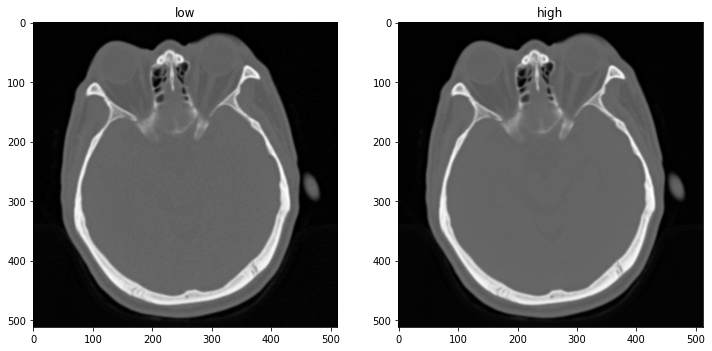

In [16]:
check_ds = Dataset(data=test_files, transform=test_transforms)
# check_loader = DataLoader(check_ds, batch_size=1, shuffle=False)
# check_data = next(iter(check_loader))

check_data = check_ds[300]

print(check_data['low_meta_dict']['filename_or_obj'])
print(check_data['high_meta_dict']['filename_or_obj'])

low = (check_data["low"][0])
high = (check_data["high"][0])
print(f"image shape: {low.shape}")

plt.figure("check", (12, 6))
plt.subplot(1, 2, 1)
plt.title("low")
plt.imshow(low, cmap="gray")

plt.subplot(1, 2, 2)
plt.title("high")
plt.imshow(high, cmap="gray")

plt.show()

In [17]:
import multiprocessing
print("CPU 갯수 = ", multiprocessing.cpu_count())

# Cachedataset 이거 뭔가 문제가 있음...
test_ds = Dataset(data=test_files, transform=test_transforms)
test_loader = DataLoader(test_ds, batch_size=1, shuffle=False, num_workers=12, drop_last=False)

CPU 갯수 =  64


## Create Model, Loss, Optimizer  Only Low -> High

In [18]:
from Pix2Pix_sunggu.model import *
from Pix2Pix_sunggu.util import *

device = 'cuda'

# 모델
netG = Pix2Pix(in_channels=1, out_channels=1, feature=64, norm='inorm').to(device)
netD = Discriminator(in_channels=2, out_channels=1, feature=64, norm='inorm').to(device)

## 네트워크 불러오기

In [19]:
## 네트워크 불러오기
checkpoint_dir = '/workspace/sunggu/4.Dose_img2img/model/Pix2Pix_2D_sinogram/epoch_100_model.pth'
checkpoint = torch.load(checkpoint_dir)

epoch = checkpoint['epoch']

netG.load_state_dict(checkpoint['netG_state_dict'])
netD.load_state_dict(checkpoint['netD_state_dict'])

netG.to('cuda')  
netD.to('cuda')  


FileNotFoundError: [Errno 2] No such file or directory: '/workspace/sunggu/4.Dose_img2img/model/Pix2Pix_2D_sinogram/epoch_100_model.pth'

###### 필요한 Weight만 Load

In [ ]:
# # Before
# model_dict = model.state_dict()
# print("이전 weight = ", model_dict['encoder._conv_stem.weight'][0])

# load_dir = '/workspace/sunggu/1.Hemorrhage/monai_experiment/model/Efficient3d_conv2d_Aux/'
# pretrained_dict =  torch.load(os.path.join(load_dir, "epoch_0_best_metric_model.pth")) 

# # 1. filter out unnecessary keys
# pretrained_dict = {k: v for k, v in pretrained_dict.items() if k in model_dict}
# # 2. overwrite entries in the existing state dict
# model_dict.update(pretrained_dict) 
# # 3. load the new state dict
# model.load_state_dict(model_dict)

# # After
# print("이후 weight = ", model_dict['encoder._conv_stem.weight'][0])

In [11]:
def diagnose_network(net, name='network'):
    """Calculate and print the mean of average absolute(gradients)
    Parameters:
        net (torch network) -- Torch network
        name (str) -- the name of the network
    """
    mean = 0.0
    count = 0
    for param in net.parameters():
        if param.grad is not None:
            mean += torch.mean(torch.abs(param.grad.data))
            count += 1
    if count > 0:
        mean = mean / count
    print(name)
    print(mean)

## Test

In [12]:
## 그밖에 부수적인 functions 설정하기
fn_tonumpy = lambda x: x.cpu().detach().numpy().transpose(0, 2, 3, 1)
fn_denorm = lambda x: (x * 0.5) + 0.5

In [13]:
def return_preprocessing(x):
    x = (4095.0)*x - 1024.0
    return x

def return_preprocessing_for_dcm(x):
    x = (4095.0)*x
    return x

In [14]:
import numpy as np
from pydicom import dcmread

def save_dicom(original_dcm_path, np_img, save_path):
    dcm = dcmread(original_dcm_path)
    
    print(np_img.max(), np_img.min(), np_img.dtype)
    
    dcm.PixelData = np_img.astype('uint16').squeeze().tobytes()
    
    dcm.save_as(save_path)
    print(save_path)

In [15]:
epoch

100

Test:   0%|          | 0/578 [00:00<?, ?it/s]2963.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00001.dcm
2871.8892 2.9704661 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00001.dcm
2959.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00001.dcm


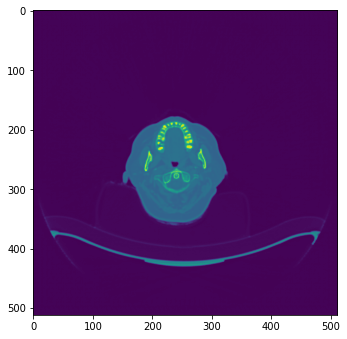

Test:   0%|          | 1/578 [00:02<19:25,  2.02s/it]2800.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00002.dcm
2830.2808 2.927996 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00002.dcm
2803.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00002.dcm


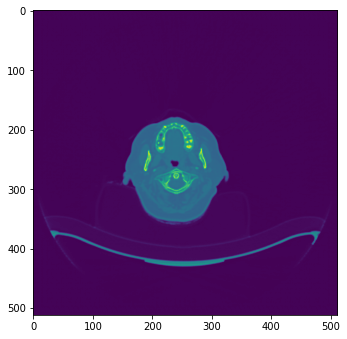

Test:   0%|          | 2/578 [00:02<11:22,  1.19s/it]2837.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00003.dcm
2798.0469 2.9056625 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00003.dcm
2834.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00003.dcm


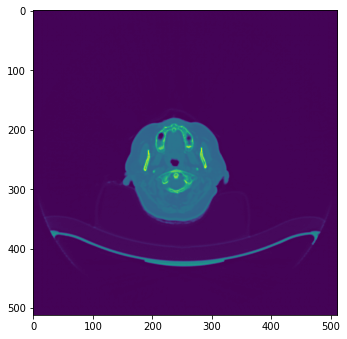

Test:   1%|          | 3/578 [00:03<07:58,  1.20it/s]2859.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00004.dcm
2823.315 2.9150596 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00004.dcm
2862.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00004.dcm


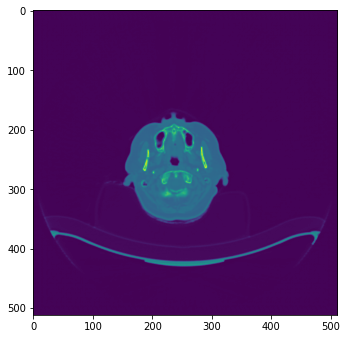

Test:   1%|          | 4/578 [00:03<06:27,  1.48it/s]2800.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00005.dcm
2760.4639 3.0344152 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00005.dcm
2802.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00005.dcm


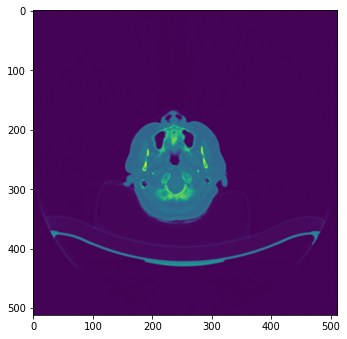

Test:   1%|          | 5/578 [00:03<05:37,  1.70it/s]2741.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00006.dcm
2766.4045 3.1737854 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00006.dcm
2740.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00006.dcm


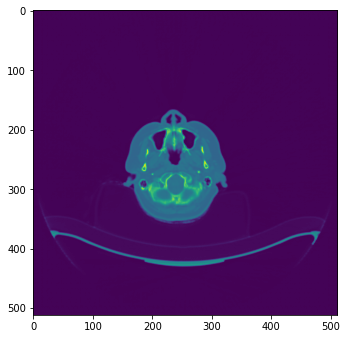

Test:   1%|          | 6/578 [00:04<05:06,  1.86it/s]2815.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00007.dcm
2780.263 3.205516 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00007.dcm
2803.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00007.dcm


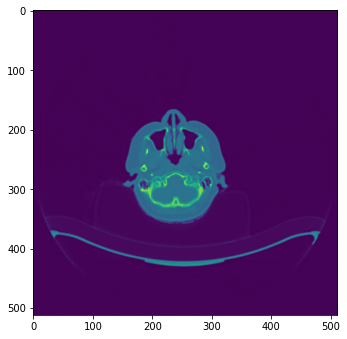

Test:   1%|          | 7/578 [00:04<04:36,  2.06it/s]2781.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00008.dcm
2667.3782 3.2694652 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00008.dcm
2777.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00008.dcm


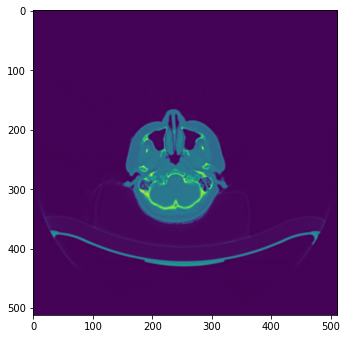

Test:   1%|▏         | 8/578 [00:05<04:19,  2.19it/s]2607.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00009.dcm
2623.946 3.3773491 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00009.dcm
2605.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00009.dcm


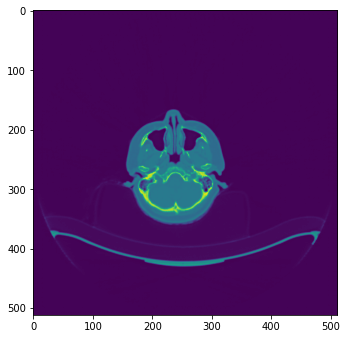

Test:   2%|▏         | 9/578 [00:05<04:12,  2.25it/s]2633.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00010.dcm
2673.5447 3.3811324 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00010.dcm
2629.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00010.dcm


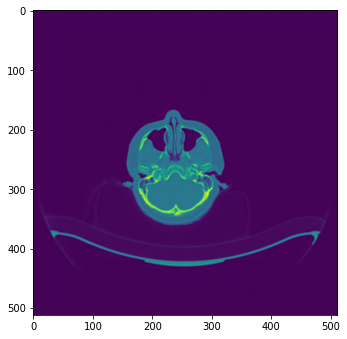

Test:   2%|▏         | 10/578 [00:05<04:14,  2.23it/s]2661.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00011.dcm
2676.2876 3.5159872 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00011.dcm
2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00011.dcm


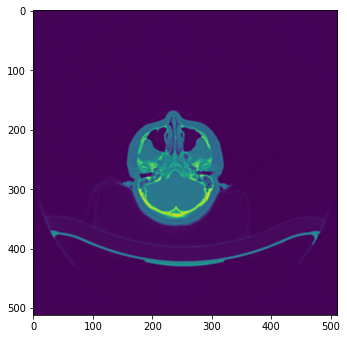

Test:   2%|▏         | 11/578 [00:06<03:58,  2.37it/s]2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00012.dcm
2740.0022 3.6625578 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00012.dcm
2788.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00012.dcm


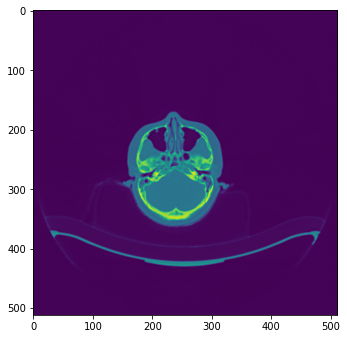

Test:   2%|▏         | 12/578 [00:06<03:57,  2.38it/s]2891.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00013.dcm
2881.1814 3.8486695 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00013.dcm
2888.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00013.dcm


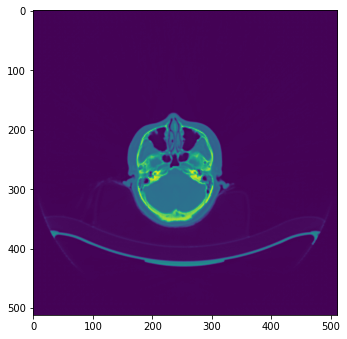

Test:   2%|▏         | 13/578 [00:07<03:57,  2.38it/s]2924.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00014.dcm
2861.474 3.5971441 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00014.dcm
2920.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00014.dcm


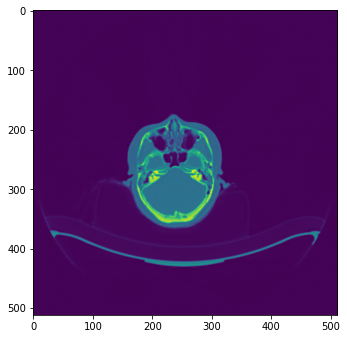

Test:   2%|▏         | 14/578 [00:07<03:53,  2.41it/s]2806.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00015.dcm
2822.7668 3.4406881 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00015.dcm
2800.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00015.dcm


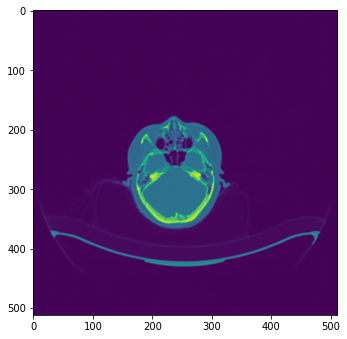

Test:   3%|▎         | 15/578 [00:08<04:00,  2.35it/s]2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00016.dcm
2729.8958 3.1978276 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00016.dcm
2781.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00016.dcm


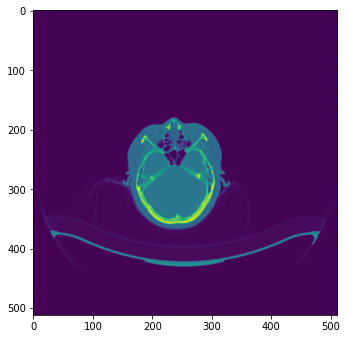

Test:   3%|▎         | 16/578 [00:08<03:56,  2.37it/s]2794.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00017.dcm
2722.0496 3.1133754 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00017.dcm
2795.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00017.dcm


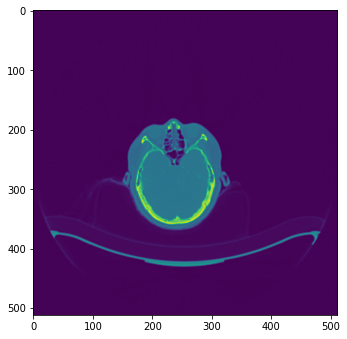

Test:   3%|▎         | 17/578 [00:08<03:49,  2.44it/s]2795.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00018.dcm
2684.302 3.0516229 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00018.dcm
2786.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00018.dcm


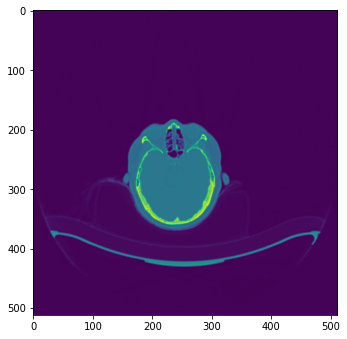

Test:   3%|▎         | 18/578 [00:09<03:49,  2.44it/s]2777.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00019.dcm
2688.7048 3.0142787 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00019.dcm
2778.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00019.dcm


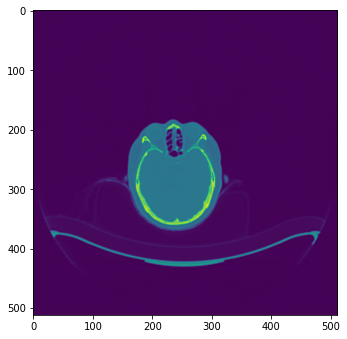

Test:   3%|▎         | 19/578 [00:09<03:47,  2.45it/s]2742.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00020.dcm
2697.4539 3.0120819 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00020.dcm
2740.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00020.dcm


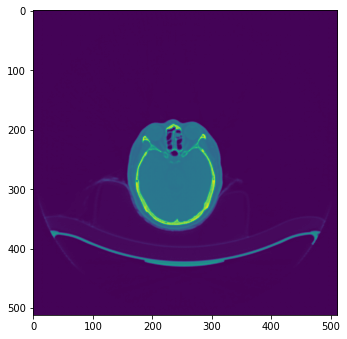

Test:   3%|▎         | 20/578 [00:10<03:57,  2.35it/s]2681.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00021.dcm
2653.2278 3.075787 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00021.dcm
2680.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00021.dcm


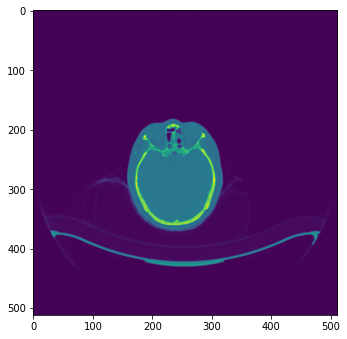

Test:   4%|▎         | 21/578 [00:10<03:46,  2.46it/s]2603.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00022.dcm
2641.7678 3.051257 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00022.dcm
2608.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00022.dcm


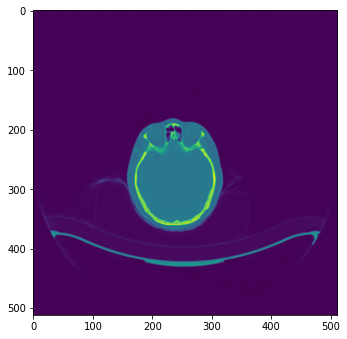

Test:   4%|▍         | 22/578 [00:10<03:37,  2.56it/s]2614.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00023.dcm
2659.6602 3.1314375 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00023.dcm
2615.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00023.dcm


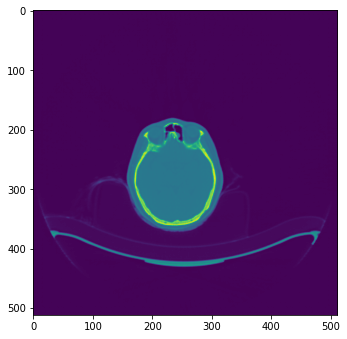

Test:   4%|▍         | 23/578 [00:11<03:33,  2.61it/s]2606.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00024.dcm
2622.8657 3.2462776 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00024.dcm
2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00024.dcm


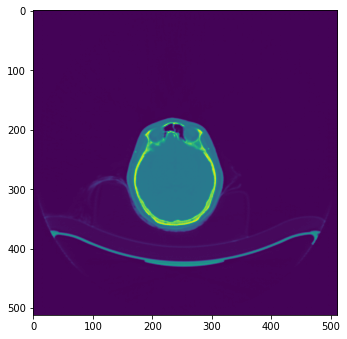

Test:   4%|▍         | 24/578 [00:11<03:32,  2.61it/s]2667.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00025.dcm
2640.4348 3.2876494 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00025.dcm
2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00025.dcm


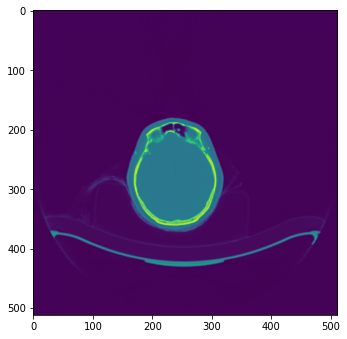

Test:   4%|▍         | 25/578 [00:11<03:26,  2.68it/s]2827.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00026.dcm
2799.8855 1.7964363 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00026.dcm
2824.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00026.dcm


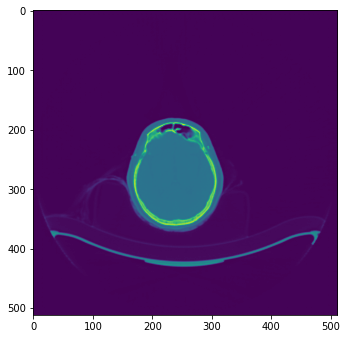

Test:   4%|▍         | 26/578 [00:12<03:29,  2.63it/s]2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00027.dcm
2780.589 2.8273125 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00027.dcm
2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00027.dcm


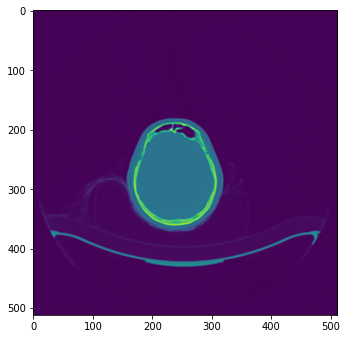

Test:   5%|▍         | 27/578 [00:12<03:27,  2.66it/s]2698.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00028.dcm
2756.8804 1.458018 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00028.dcm
2694.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00028.dcm


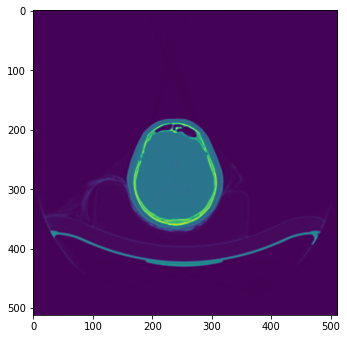

Test:   5%|▍         | 28/578 [00:13<03:19,  2.75it/s]2688.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00029.dcm
2660.169 2.0948253 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00029.dcm
2690.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100754_00029.dcm


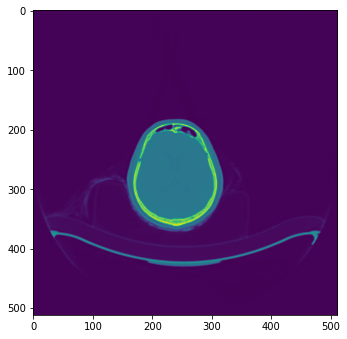

Test:   5%|▌         | 29/578 [00:13<03:18,  2.77it/s]2720.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00030.dcm
2657.6746 1.4572858 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00030.dcm
2716.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00030.dcm


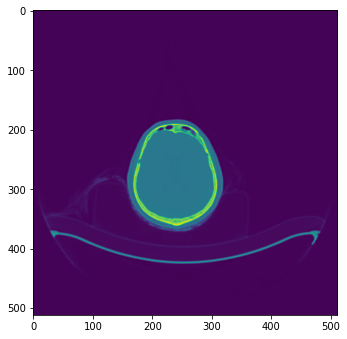

Test:   5%|▌         | 30/578 [00:13<03:30,  2.61it/s]2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00031.dcm
2571.575 3.2706857 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00031.dcm
2620.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00031.dcm


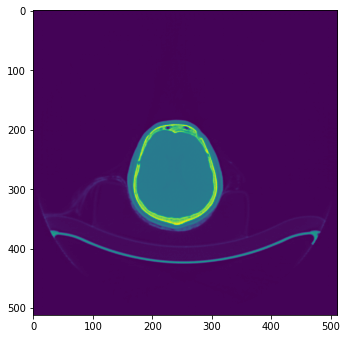

Test:   5%|▌         | 31/578 [00:14<03:41,  2.47it/s]2721.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00032.dcm
2588.249 3.0718818 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00032.dcm
2721.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00032.dcm


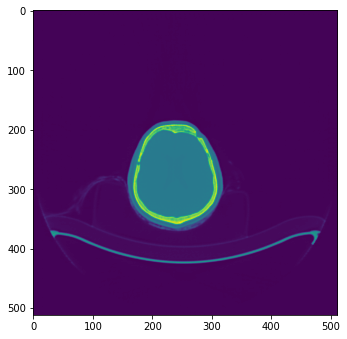

Test:   6%|▌         | 32/578 [00:14<03:41,  2.46it/s]2994.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00033.dcm
2628.0232 3.3537953 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00033.dcm
2995.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00033.dcm


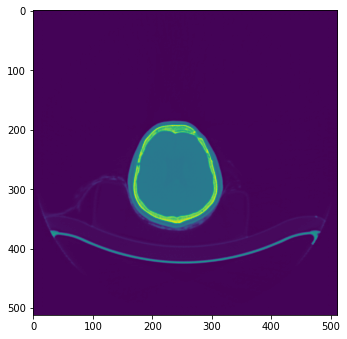

Test:   6%|▌         | 33/578 [00:15<03:37,  2.51it/s]3601.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00034.dcm
3069.6045 3.4212837 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00034.dcm
3595.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00034.dcm


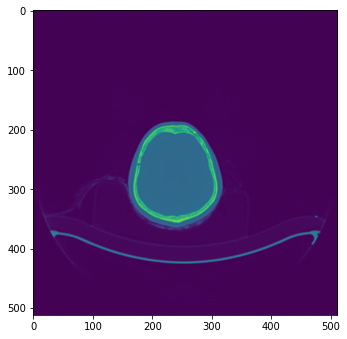

Test:   6%|▌         | 34/578 [00:15<03:27,  2.62it/s]3091.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00035.dcm
2636.2773 3.3087623 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00035.dcm
3092.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00035.dcm


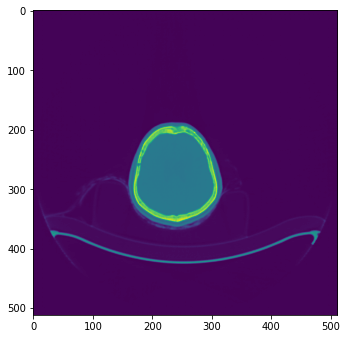

Test:   6%|▌         | 35/578 [00:15<03:32,  2.56it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113232_00036.dcm
3626.3772 3.1247253 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113232_00036.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00036.dcm


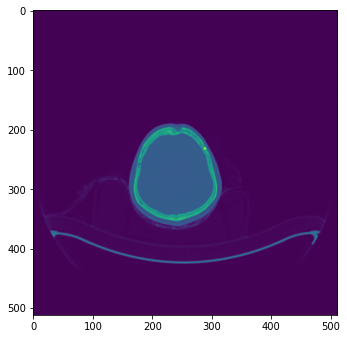

Test:   6%|▌         | 36/578 [00:16<04:00,  2.25it/s]3352.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00037.dcm
2968.4573 3.2680008 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00037.dcm
3346.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00037.dcm


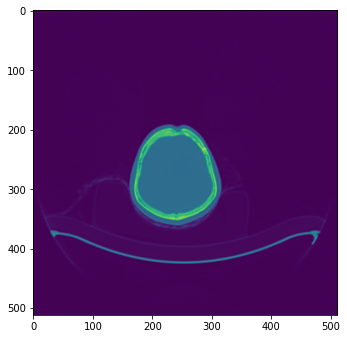

Test:   6%|▋         | 37/578 [00:16<03:51,  2.34it/s]3031.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00038.dcm
2669.2856 3.4317791 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00038.dcm
3021.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00038.dcm


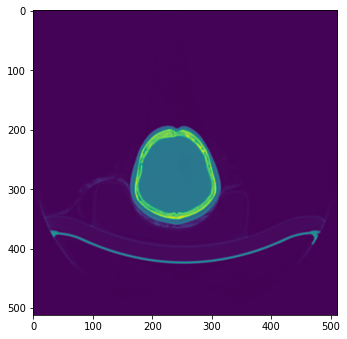

Test:   7%|▋         | 38/578 [00:17<04:02,  2.23it/s]3908.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00039.dcm
3127.99 3.2268732 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00039.dcm
3915.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00039.dcm


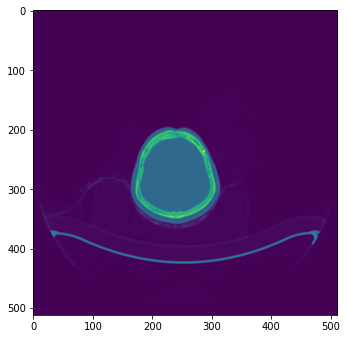

Test:   7%|▋         | 39/578 [00:17<03:50,  2.34it/s]3116.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00040.dcm
2712.2483 3.0434463 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00040.dcm
3120.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00040.dcm


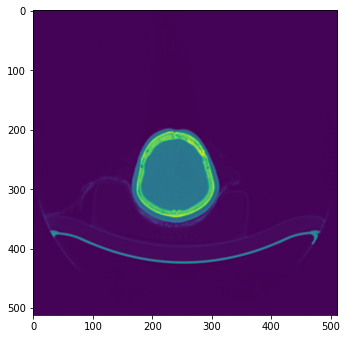

Test:   7%|▋         | 40/578 [00:18<03:41,  2.43it/s]3216.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00041.dcm
2803.651 3.0859163 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00041.dcm
3232.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00041.dcm


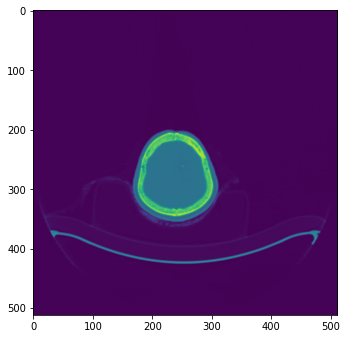

Test:   7%|▋         | 41/578 [00:18<03:29,  2.57it/s]2567.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00042.dcm
2551.1826 3.0162313 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00042.dcm
2569.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00042.dcm


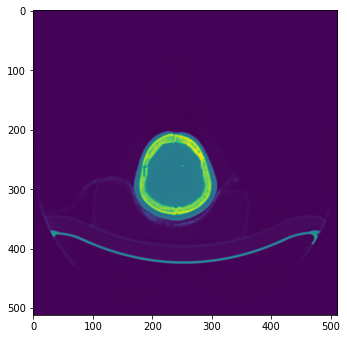

Test:   7%|▋         | 42/578 [00:18<03:33,  2.51it/s]2676.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00043.dcm
2656.0042 2.7761774 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00043.dcm
2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00043.dcm


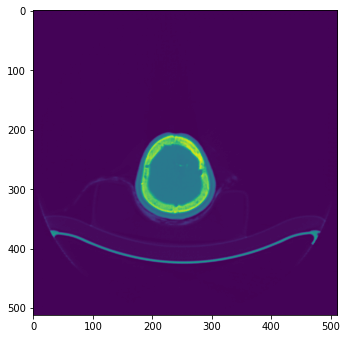

Test:   7%|▋         | 43/578 [00:19<03:29,  2.55it/s]2945.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00044.dcm
2719.4937 2.855748 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00044.dcm
2942.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00044.dcm


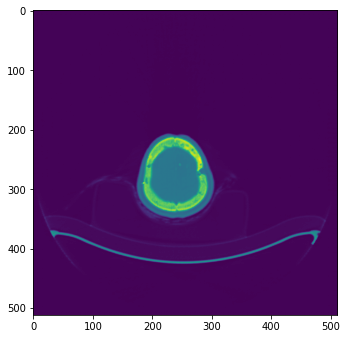

Test:   8%|▊         | 44/578 [00:19<03:28,  2.56it/s]2704.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00045.dcm
2747.3386 2.6991699 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00045.dcm
2699.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00045.dcm


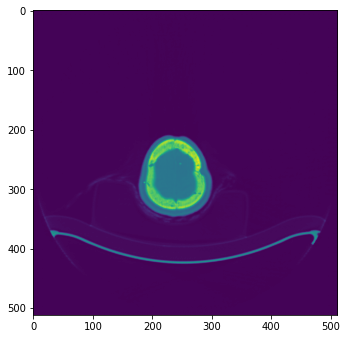

Test:   8%|▊         | 45/578 [00:19<03:23,  2.62it/s]2701.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00046.dcm
2677.3032 2.54247 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00046.dcm
2707.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00046.dcm


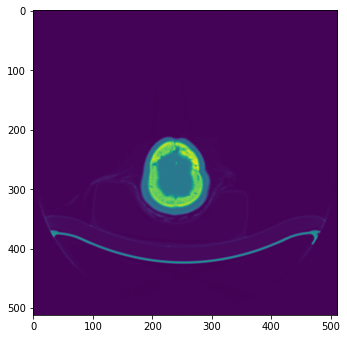

Test:   8%|▊         | 46/578 [00:20<03:16,  2.70it/s]2707.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00047.dcm
2761.8115 2.2446911 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00047.dcm
2707.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00047.dcm


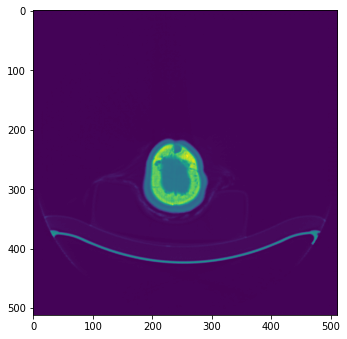

Test:   8%|▊         | 47/578 [00:20<03:20,  2.65it/s]2624.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00048.dcm
2654.0686 2.3235292 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00048.dcm
2628.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00048.dcm


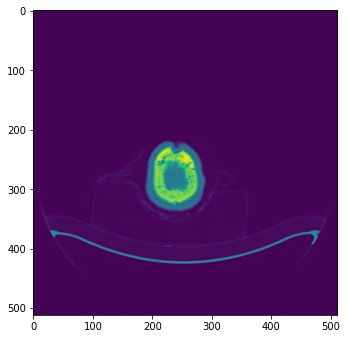

Test:   8%|▊         | 48/578 [00:21<03:24,  2.59it/s]2519.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00049.dcm
2566.467 1.9743714 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00049.dcm
2514.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00049.dcm


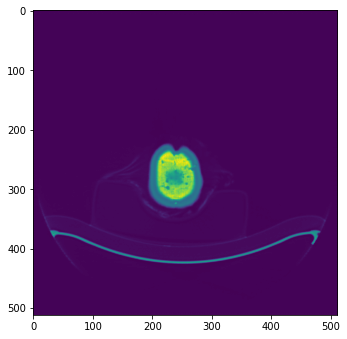

Test:   8%|▊         | 49/578 [00:21<03:28,  2.53it/s]3510.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00050.dcm
2915.267 1.8489137 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00050.dcm
3510.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00050.dcm


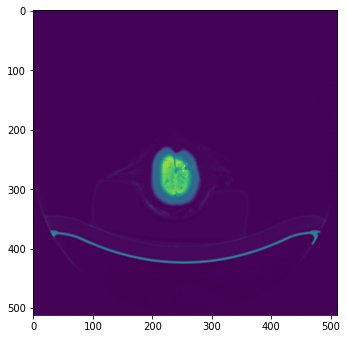

Test:   9%|▊         | 50/578 [00:21<03:30,  2.50it/s]2550.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00051.dcm
2582.7908 1.8301195 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00051.dcm
2554.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00051.dcm


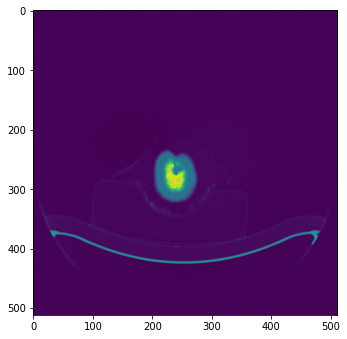

Test:   9%|▉         | 51/578 [00:22<03:32,  2.48it/s]2147.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00052.dcm
2274.8948 1.8915058 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00052.dcm
2147.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00052.dcm


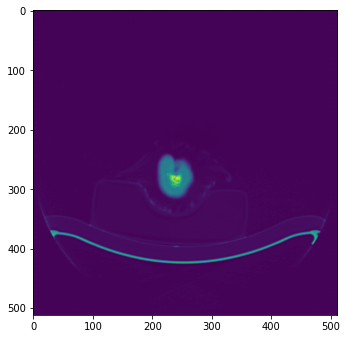

Test:   9%|▉         | 52/578 [00:22<03:34,  2.46it/s]1904.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00053.dcm
1994.9508 1.843788 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00053.dcm
1903.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00053.dcm


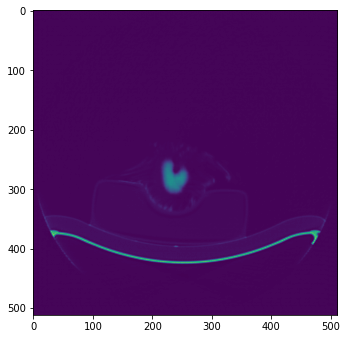

Test:   9%|▉         | 53/578 [00:23<03:29,  2.51it/s]1900.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00054.dcm
2017.358 1.7709298 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00054.dcm
1900.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00054.dcm


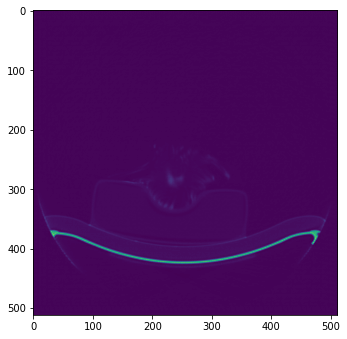

Test:   9%|▉         | 54/578 [00:23<03:14,  2.69it/s]1892.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00055.dcm
2046.7173 1.8000975 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00055.dcm
1895.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00055.dcm


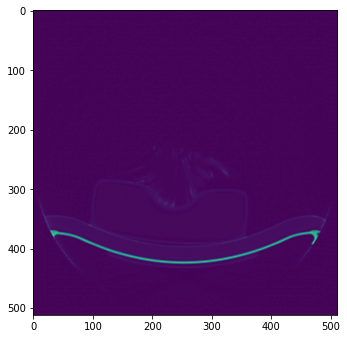

Test:  10%|▉         | 55/578 [00:23<03:04,  2.83it/s]1910.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/gt_low_AHN_YEO_F77_001_20201117_113233_00056.dcm
2081.5178 1.4329996 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YEO_F77/pred_high_AHN_YEO_F77_001_20201117_113233_00056.dcm
1908.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YEO_F77/gt_high_AHN_YEO_F77_001_20201117_100755_00056.dcm


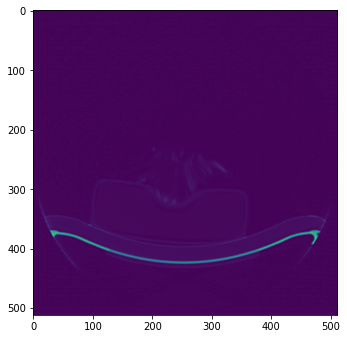

Test:  10%|▉         | 56/578 [00:24<03:19,  2.62it/s]2763.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00001.dcm
2663.2852 4.819502 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00001.dcm
2761.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00001.dcm


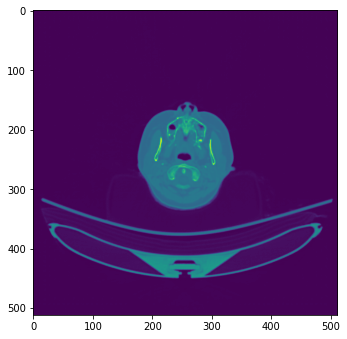

Test:  10%|▉         | 57/578 [00:24<03:15,  2.66it/s]2745.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00002.dcm
2585.9167 4.820356 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00002.dcm
2733.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00002.dcm


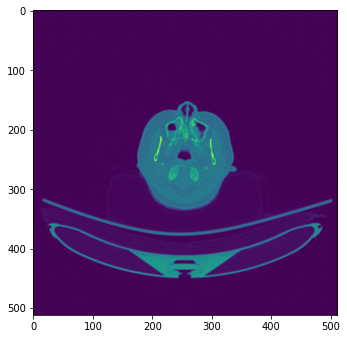

Test:  10%|█         | 58/578 [00:24<03:16,  2.65it/s]2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00003.dcm
2560.7832 4.2908225 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00003.dcm
2644.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00003.dcm


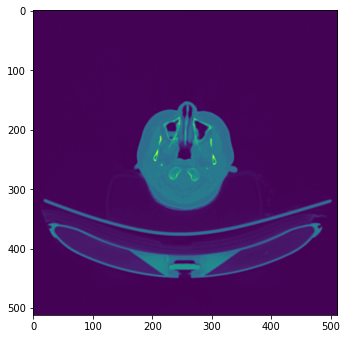

Test:  10%|█         | 59/578 [00:25<03:07,  2.77it/s]2763.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00004.dcm
2662.5388 3.536734 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00004.dcm
2768.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00004.dcm


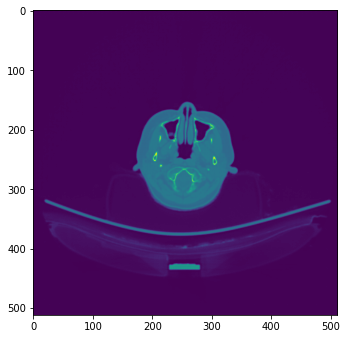

Test:  10%|█         | 60/578 [00:25<03:09,  2.74it/s]2741.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00005.dcm
2756.242 3.7149131 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00005.dcm
2736.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00005.dcm


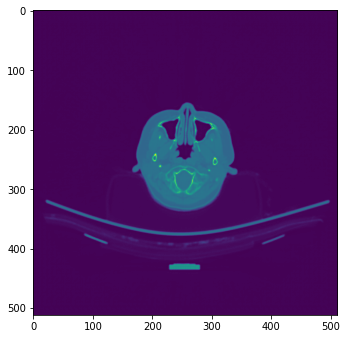

Test:  11%|█         | 61/578 [00:25<03:09,  2.74it/s]2663.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00006.dcm
2636.8096 3.3151083 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00006.dcm
2664.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00006.dcm


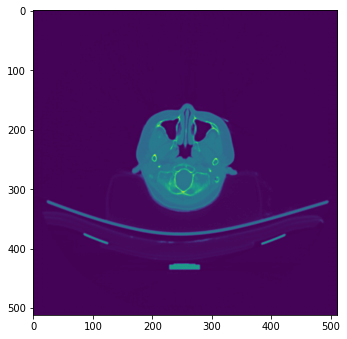

Test:  11%|█         | 62/578 [00:26<03:14,  2.66it/s]2546.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00007.dcm
2516.3787 3.588601 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00007.dcm
2549.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00007.dcm


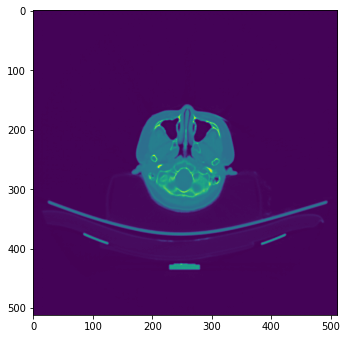

Test:  11%|█         | 63/578 [00:26<03:32,  2.42it/s]2542.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00008.dcm
2456.905 4.1648765 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00008.dcm
2545.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00008.dcm


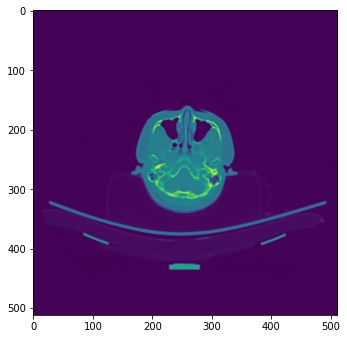

Test:  11%|█         | 64/578 [00:27<03:30,  2.44it/s]2533.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00009.dcm
2484.1382 4.175128 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00009.dcm
2536.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00009.dcm


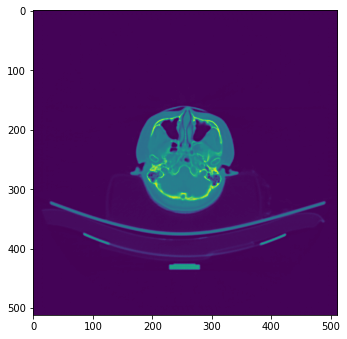

Test:  11%|█         | 65/578 [00:27<03:27,  2.48it/s]2585.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00010.dcm
2591.1057 5.0360017 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00010.dcm
2588.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00010.dcm


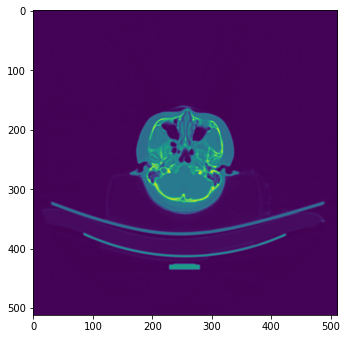

Test:  11%|█▏        | 66/578 [00:28<03:34,  2.39it/s]2915.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00011.dcm
2827.068 4.8696604 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00011.dcm
2915.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00011.dcm


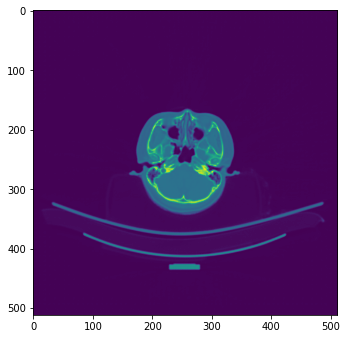

Test:  12%|█▏        | 67/578 [00:28<03:29,  2.44it/s]2991.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00012.dcm
2972.5842 4.762387 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00012.dcm
2998.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00012.dcm


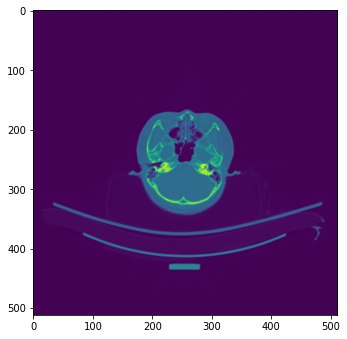

Test:  12%|█▏        | 68/578 [00:28<03:29,  2.43it/s]2980.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00013.dcm
2973.207 4.96412 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00013.dcm
2985.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00013.dcm


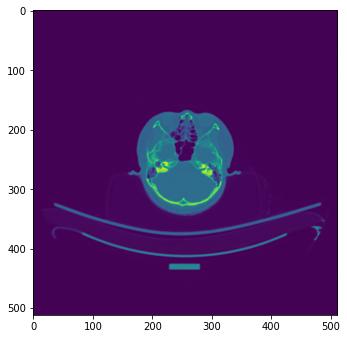

Test:  12%|█▏        | 69/578 [00:29<03:20,  2.54it/s]2929.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00014.dcm
2930.882 4.232609 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00014.dcm
2926.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00014.dcm


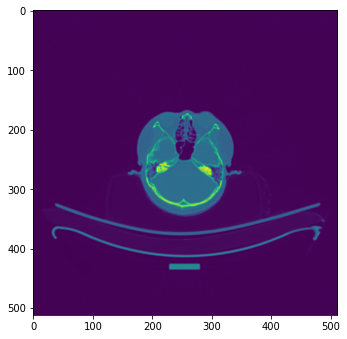

Test:  12%|█▏        | 70/578 [00:29<03:28,  2.44it/s]2948.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00015.dcm
2921.1177 4.330119 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00015.dcm
2947.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00015.dcm


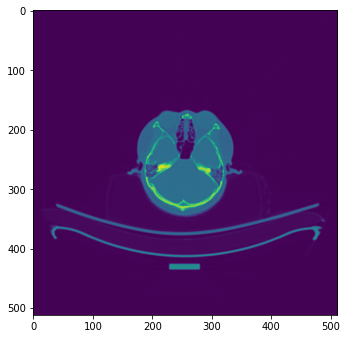

Test:  12%|█▏        | 71/578 [00:30<03:25,  2.47it/s]2759.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00016.dcm
2778.9556 4.0297775 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00016.dcm
2759.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00016.dcm


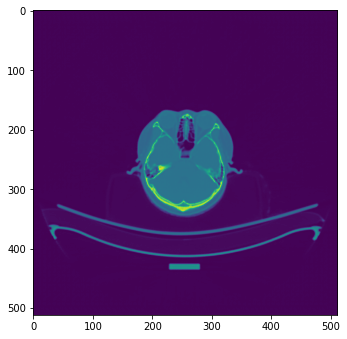

Test:  12%|█▏        | 72/578 [00:30<03:25,  2.46it/s]2685.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00017.dcm
2709.302 3.8629482 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00017.dcm
2682.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00017.dcm


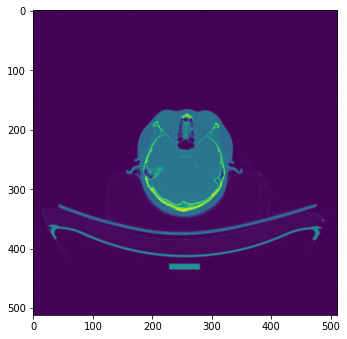

Test:  13%|█▎        | 73/578 [00:30<03:26,  2.44it/s]2672.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00018.dcm
2714.1494 3.8457406 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00018.dcm
2661.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00018.dcm


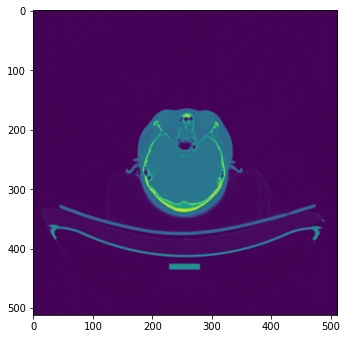

Test:  13%|█▎        | 74/578 [00:31<03:46,  2.22it/s]2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00019.dcm
2699.1565 3.8306074 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00019.dcm
2663.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00019.dcm


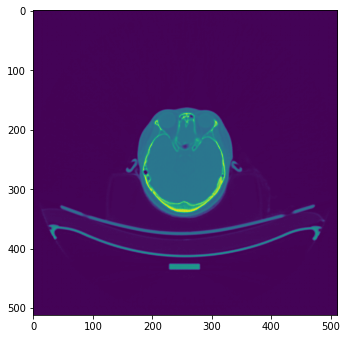

Test:  13%|█▎        | 75/578 [00:31<03:39,  2.29it/s]2634.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00020.dcm
2701.7954 3.9392235 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00020.dcm
2630.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00020.dcm


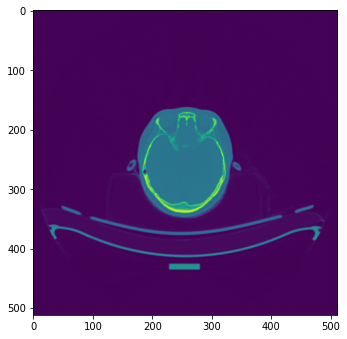

Test:  13%|█▎        | 76/578 [00:32<03:35,  2.33it/s]2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00021.dcm
2699.4297 3.9099338 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00021.dcm
2634.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00021.dcm


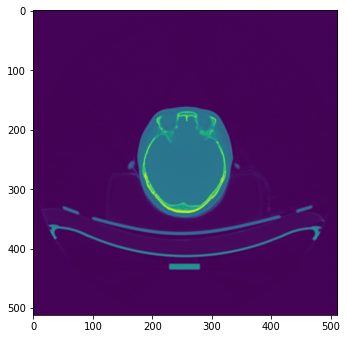

Test:  13%|█▎        | 77/578 [00:32<03:37,  2.31it/s]2649.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00022.dcm
2668.0574 4.097266 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00022.dcm
2652.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00022.dcm


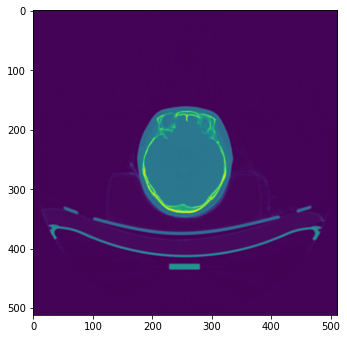

Test:  13%|█▎        | 78/578 [00:33<03:46,  2.21it/s]2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00023.dcm
2729.4512 3.9882839 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00023.dcm
2674.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00023.dcm


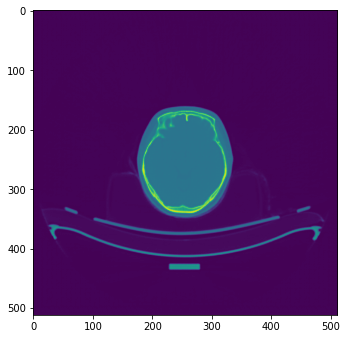

Test:  14%|█▎        | 79/578 [00:33<03:41,  2.26it/s]2661.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00024.dcm
2697.7148 4.1247253 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00024.dcm
2661.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00024.dcm


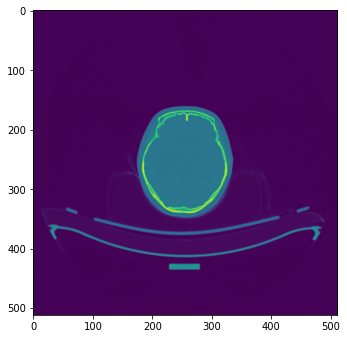

Test:  14%|█▍        | 80/578 [00:34<03:41,  2.25it/s]2633.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00025.dcm
2683.7031 3.9420304 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00025.dcm
2627.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00025.dcm


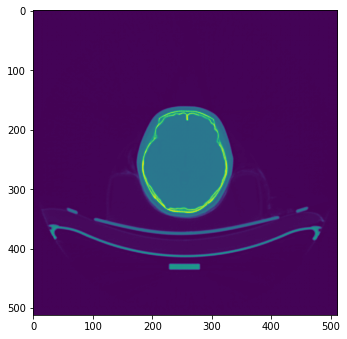

Test:  14%|█▍        | 81/578 [00:34<03:32,  2.33it/s]2618.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00026.dcm
2631.2585 3.5699291 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00026.dcm
2615.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00026.dcm


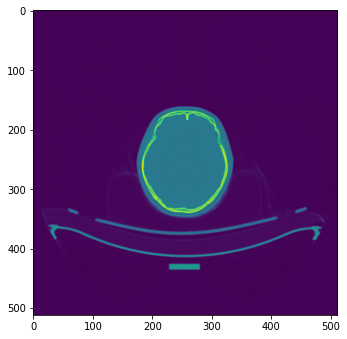

Test:  14%|█▍        | 82/578 [00:34<03:31,  2.34it/s]2635.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151442_00027.dcm
2635.3218 3.7483523 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151442_00027.dcm
2639.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00027.dcm


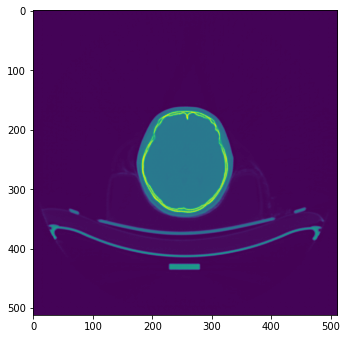

Test:  14%|█▍        | 83/578 [00:35<03:25,  2.41it/s]2635.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00028.dcm
2621.0652 3.8312178 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00028.dcm
2637.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00028.dcm


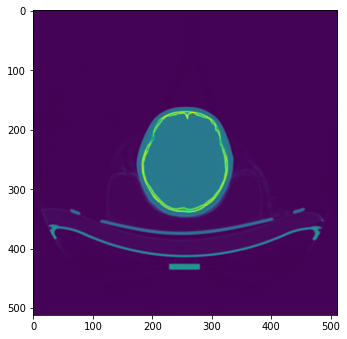

Test:  15%|█▍        | 84/578 [00:35<03:27,  2.38it/s]2637.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00029.dcm
2655.123 3.8264582 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00029.dcm
2632.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00029.dcm


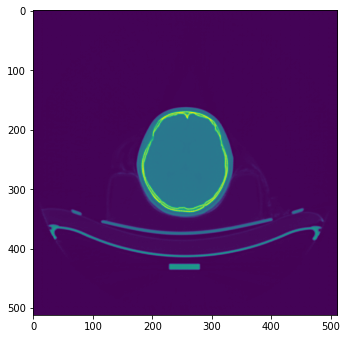

Test:  15%|█▍        | 85/578 [00:36<03:27,  2.38it/s]2621.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00030.dcm
2650.1846 3.5843298 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00030.dcm
2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00030.dcm


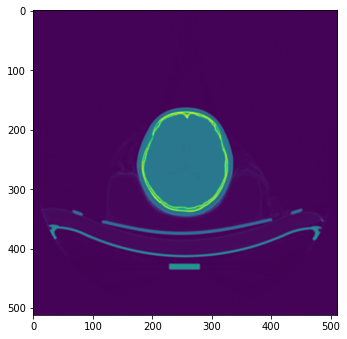

Test:  15%|█▍        | 86/578 [00:36<03:24,  2.41it/s]2618.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00031.dcm
2619.1086 3.6381497 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00031.dcm
2612.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00031.dcm


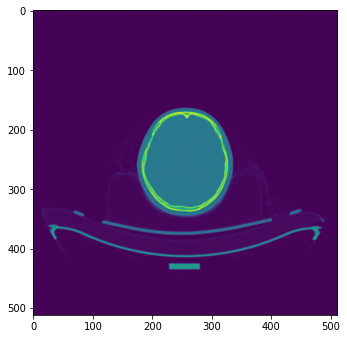

Test:  15%|█▌        | 87/578 [00:36<03:20,  2.45it/s]2584.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00032.dcm
2582.5637 3.5462532 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00032.dcm
2593.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00032.dcm


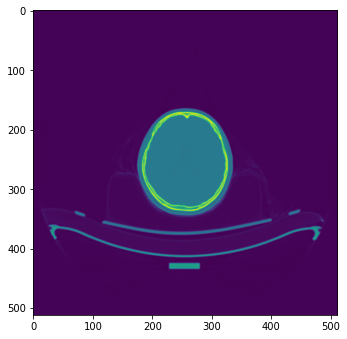

Test:  15%|█▌        | 88/578 [00:37<03:19,  2.46it/s]2565.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00033.dcm
2561.9272 3.8595312 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00033.dcm
2563.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133951_00033.dcm


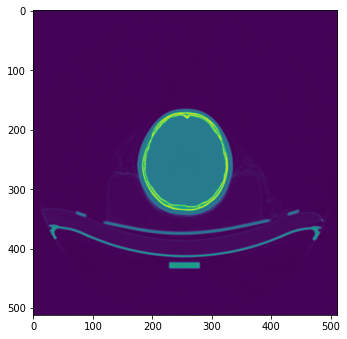

Test:  15%|█▌        | 89/578 [00:37<03:14,  2.51it/s]2585.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00034.dcm
2545.4434 3.7584815 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00034.dcm
2586.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00034.dcm


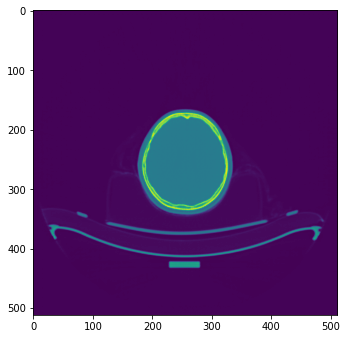

Test:  16%|█▌        | 90/578 [00:38<03:26,  2.37it/s]2575.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00035.dcm
2550.8943 3.5288014 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00035.dcm
2571.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00035.dcm


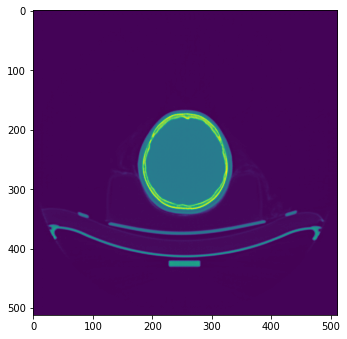

Test:  16%|█▌        | 91/578 [00:38<03:17,  2.46it/s]2584.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00036.dcm
2508.2146 3.8882108 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00036.dcm
2574.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00036.dcm


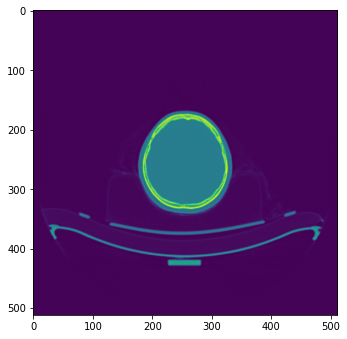

Test:  16%|█▌        | 92/578 [00:39<03:41,  2.19it/s]2601.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00037.dcm
2494.8806 4.880278 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00037.dcm
2589.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00037.dcm


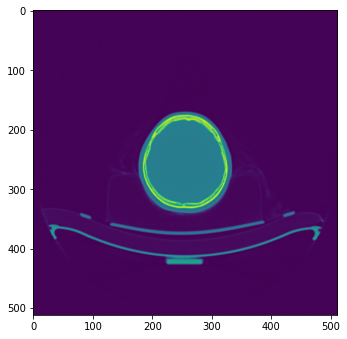

Test:  16%|█▌        | 93/578 [00:39<03:42,  2.17it/s]2551.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00038.dcm
2495.3298 5.088235 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00038.dcm
2553.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00038.dcm


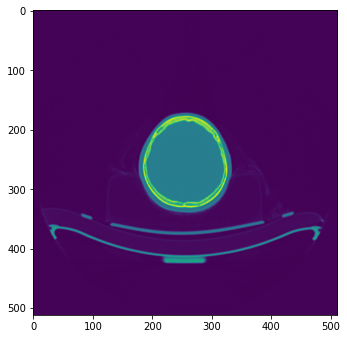

Test:  16%|█▋        | 94/578 [00:40<03:37,  2.23it/s]2571.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00039.dcm
2498.0754 5.804125 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00039.dcm
2564.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00039.dcm


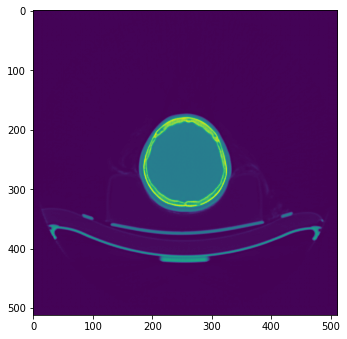

Test:  16%|█▋        | 95/578 [00:40<03:34,  2.26it/s]2543.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00040.dcm
2458.632 5.6432753 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00040.dcm
2547.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00040.dcm


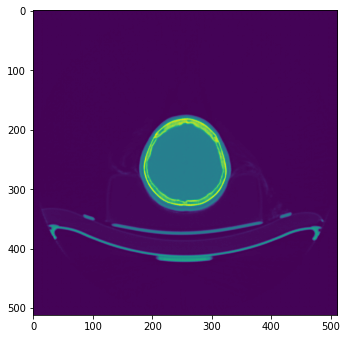

Test:  17%|█▋        | 96/578 [00:40<03:23,  2.37it/s]2532.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00041.dcm
2475.3713 4.6414447 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00041.dcm
2532.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00041.dcm


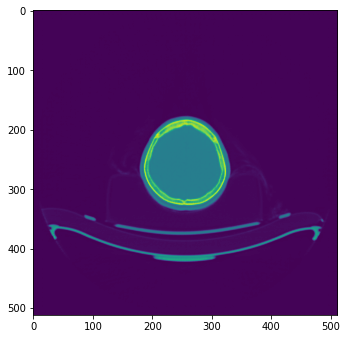

Test:  17%|█▋        | 97/578 [00:41<03:19,  2.41it/s]2501.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00042.dcm
2452.1104 3.085184 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00042.dcm
2496.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00042.dcm


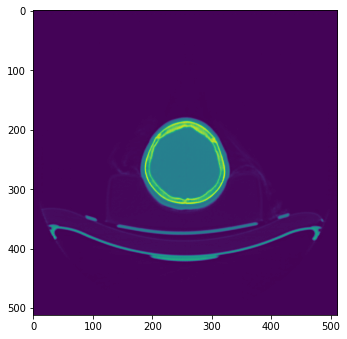

Test:  17%|█▋        | 98/578 [00:41<03:10,  2.52it/s]2439.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00043.dcm
2408.959 3.4175005 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00043.dcm
2433.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00043.dcm


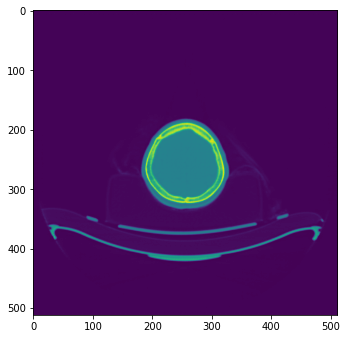

Test:  17%|█▋        | 99/578 [00:41<03:03,  2.60it/s]2389.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00044.dcm
2395.6218 3.141811 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00044.dcm
2392.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00044.dcm


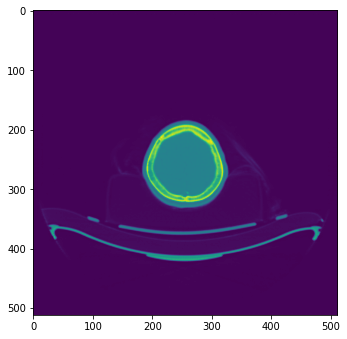

Test:  17%|█▋        | 100/578 [00:42<03:00,  2.64it/s]2390.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00045.dcm
2376.5217 3.198804 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00045.dcm
2395.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00045.dcm


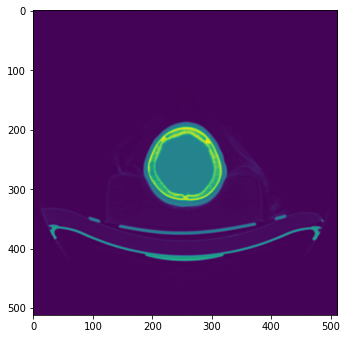

Test:  17%|█▋        | 101/578 [00:42<03:04,  2.59it/s]2420.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00046.dcm
2435.7734 2.922748 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00046.dcm
2421.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00046.dcm


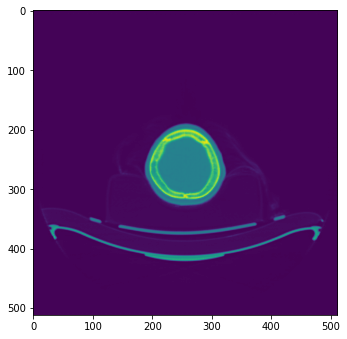

Test:  18%|█▊        | 102/578 [00:43<03:03,  2.60it/s]2420.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00047.dcm
2443.6318 2.7660482 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00047.dcm
2425.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00047.dcm


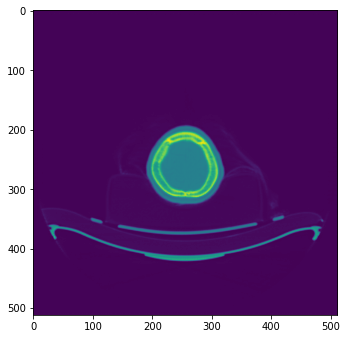

Test:  18%|█▊        | 103/578 [00:43<03:11,  2.49it/s]2363.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00048.dcm
2374.3938 2.69319 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00048.dcm
2362.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00048.dcm


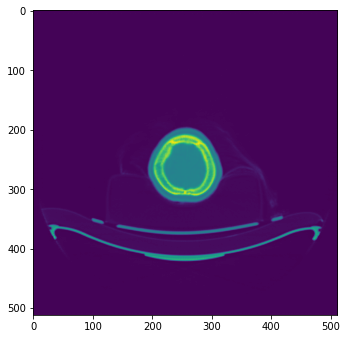

Test:  18%|█▊        | 104/578 [00:43<03:13,  2.45it/s]2406.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00049.dcm
2426.4673 2.5617523 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00049.dcm
2401.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00049.dcm


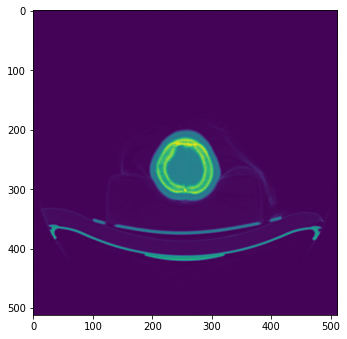

Test:  18%|█▊        | 105/578 [00:44<03:12,  2.46it/s]2428.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00050.dcm
2399.6362 2.5208688 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00050.dcm
2419.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00050.dcm


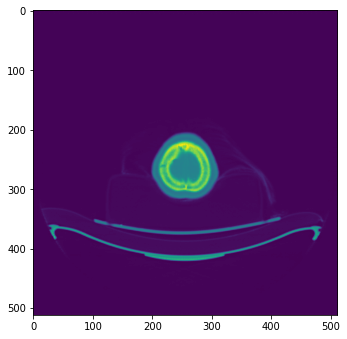

Test:  18%|█▊        | 106/578 [00:44<03:09,  2.49it/s]2389.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00051.dcm
2400.619 2.4803514 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00051.dcm
2388.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00051.dcm


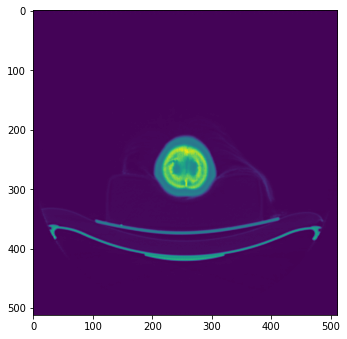

Test:  19%|█▊        | 107/578 [00:45<03:17,  2.39it/s]2373.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00052.dcm
2365.4417 2.4580178 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00052.dcm
2378.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00052.dcm


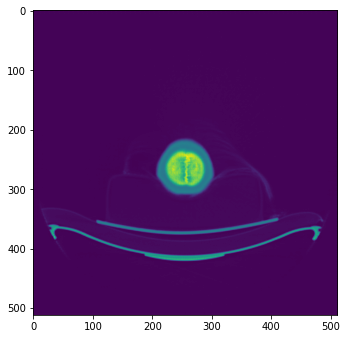

Test:  19%|█▊        | 108/578 [00:45<03:11,  2.45it/s]2302.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00053.dcm
2346.015 2.4238465 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00053.dcm
2301.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00053.dcm


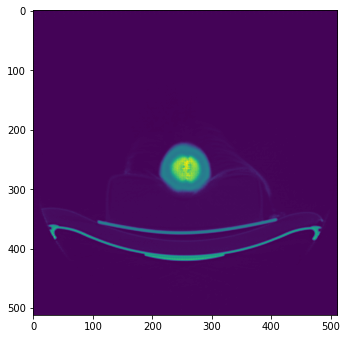

Test:  19%|█▉        | 109/578 [00:45<03:04,  2.54it/s]1729.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00054.dcm
1860.3021 2.3630705 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00054.dcm
1727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00054.dcm


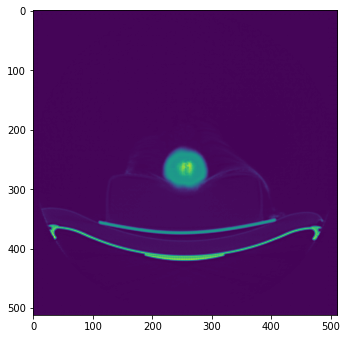

Test:  19%|█▉        | 110/578 [00:46<03:13,  2.42it/s]1744.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00055.dcm
1872.9116 2.1410787 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00055.dcm
1747.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00055.dcm


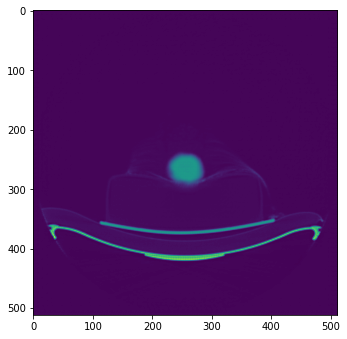

Test:  19%|█▉        | 111/578 [00:46<03:03,  2.55it/s]1755.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00056.dcm
1867.9374 2.2130826 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00056.dcm
1754.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00056.dcm


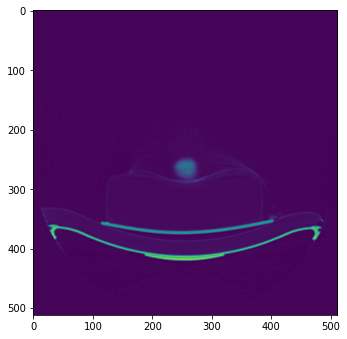

Test:  19%|█▉        | 112/578 [00:47<03:01,  2.57it/s]1743.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/gt_low_AHN_YOO_SIL_F77_001_20201117_151443_00057.dcm
1842.5591 2.461801 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/AHN_YOO_SIL_F77/pred_high_AHN_YOO_SIL_F77_001_20201117_151443_00057.dcm
1740.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/AHN_YOO_SIL_F77/gt_high_AHN_YOO_SIL_F77_001_20201117_133952_00057.dcm


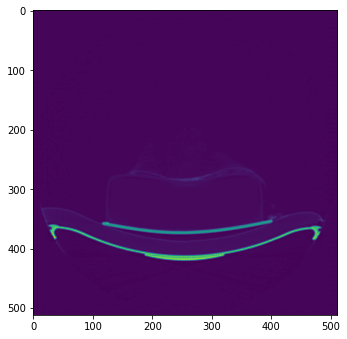

Test:  20%|█▉        | 113/578 [00:47<03:04,  2.52it/s]1717.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181317_00001.dcm
1832.6824 2.4206736 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181317_00001.dcm
1717.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00001.dcm


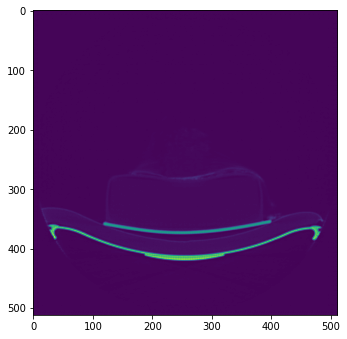

Test:  20%|█▉        | 114/578 [00:48<03:09,  2.45it/s]1741.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181317_00002.dcm
1888.4469 2.4018793 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181317_00002.dcm
1740.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00002.dcm


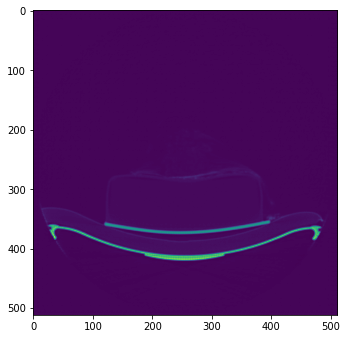

Test:  20%|█▉        | 115/578 [00:48<03:05,  2.49it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00003.dcm
3625.7566 1.6637783 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00003.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00003.dcm


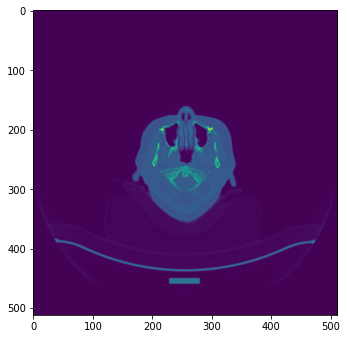

Test:  20%|██        | 116/578 [00:48<03:02,  2.53it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00004.dcm
3639.1284 3.0648034 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00004.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00004.dcm


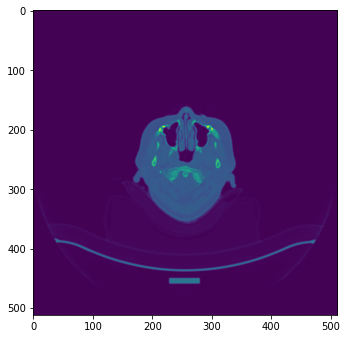

Test:  20%|██        | 117/578 [00:49<03:01,  2.54it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00005.dcm
3594.638 3.3786914 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00005.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00005.dcm


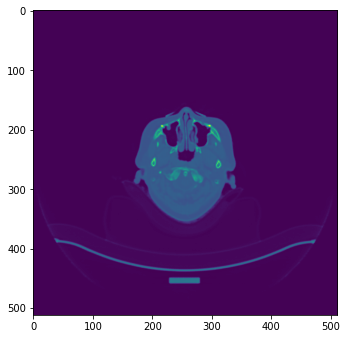

Test:  20%|██        | 118/578 [00:49<02:52,  2.66it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00006.dcm
3456.0046 3.5627286 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00006.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00006.dcm


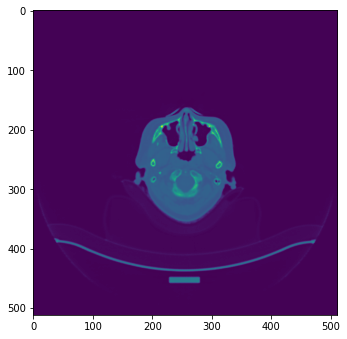

Test:  21%|██        | 119/578 [00:49<02:49,  2.70it/s]3408.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00007.dcm
3044.6873 3.2339516 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00007.dcm
3411.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00007.dcm


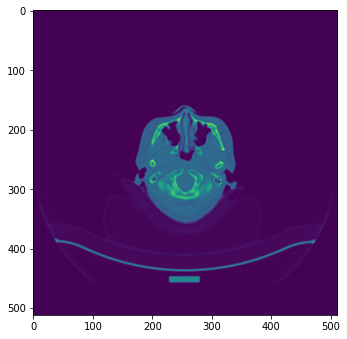

Test:  21%|██        | 120/578 [00:50<02:51,  2.67it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00008.dcm
3413.9314 3.7528677 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00008.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00008.dcm


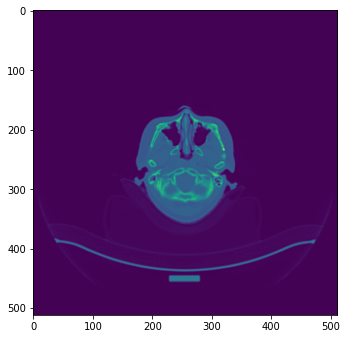

Test:  21%|██        | 121/578 [00:50<02:51,  2.66it/s]3339.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00009.dcm
3102.9976 4.1580424 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00009.dcm
3341.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00009.dcm


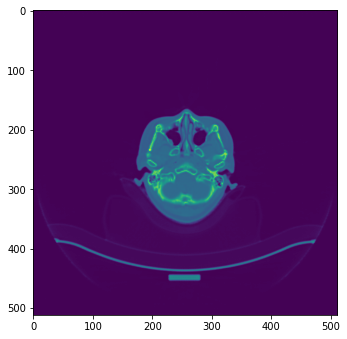

Test:  21%|██        | 122/578 [00:50<02:51,  2.66it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00010.dcm
3530.1858 4.415426 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00010.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00010.dcm


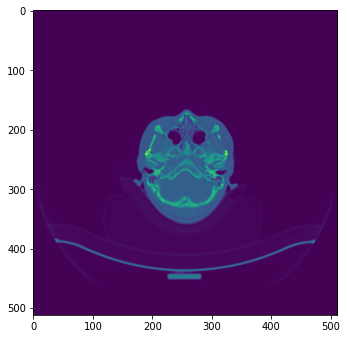

Test:  21%|██▏       | 123/578 [00:51<02:51,  2.65it/s]3874.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00011.dcm
3222.7969 5.972296 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00011.dcm
3881.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00011.dcm


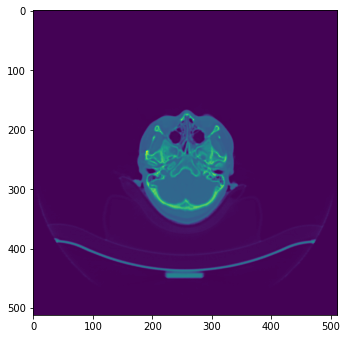

Test:  21%|██▏       | 124/578 [00:51<02:43,  2.77it/s]2752.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00012.dcm
2750.1365 4.082865 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00012.dcm
2764.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00012.dcm


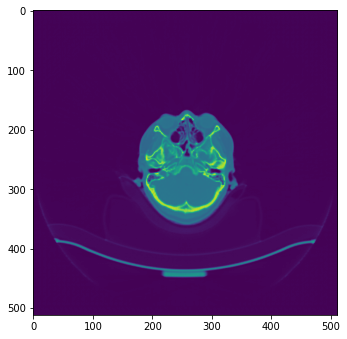

Test:  22%|██▏       | 125/578 [00:52<02:51,  2.64it/s]2863.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00013.dcm
2806.613 5.017329 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00013.dcm
2847.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00013.dcm


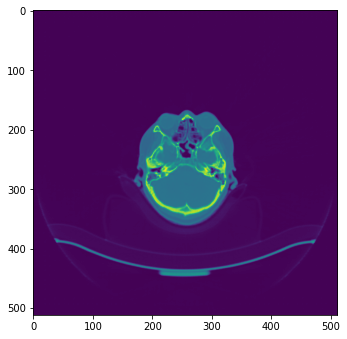

Test:  22%|██▏       | 126/578 [00:52<02:52,  2.62it/s]2936.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00014.dcm
2902.3738 4.9332438 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00014.dcm
2928.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00014.dcm


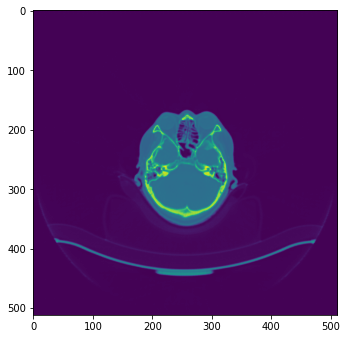

Test:  22%|██▏       | 127/578 [00:52<02:56,  2.55it/s]2870.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00015.dcm
2867.2354 3.7874053 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00015.dcm
2872.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00015.dcm


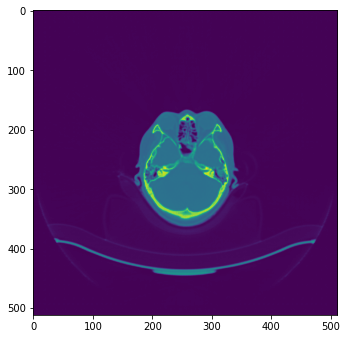

Test:  22%|██▏       | 128/578 [00:53<03:13,  2.33it/s]2746.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00016.dcm
2778.7886 2.606053 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00016.dcm
2755.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00016.dcm


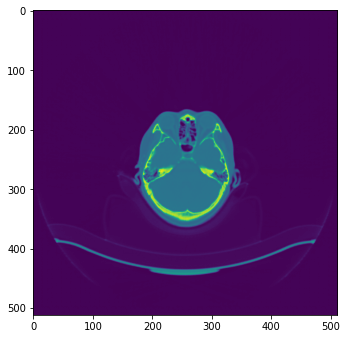

Test:  22%|██▏       | 129/578 [00:53<03:04,  2.43it/s]2697.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00017.dcm
2754.7913 3.819868 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00017.dcm
2699.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00017.dcm


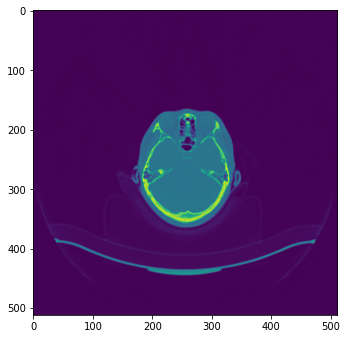

Test:  22%|██▏       | 130/578 [00:54<02:57,  2.52it/s]2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00018.dcm
2690.6274 3.527947 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00018.dcm
2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00018.dcm


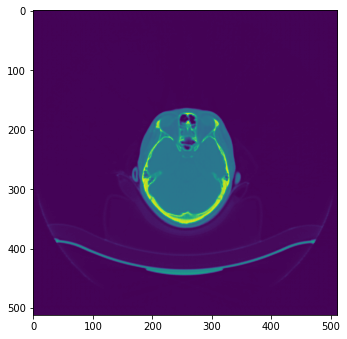

Test:  23%|██▎       | 131/578 [00:54<02:55,  2.55it/s]2656.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00019.dcm
2732.3193 3.4560652 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00019.dcm
2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00019.dcm


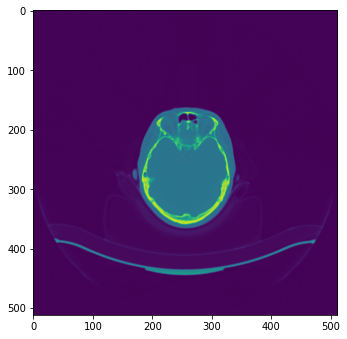

Test:  23%|██▎       | 132/578 [00:54<02:50,  2.61it/s]2667.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00020.dcm
2696.6255 3.4365387 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00020.dcm
2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00020.dcm


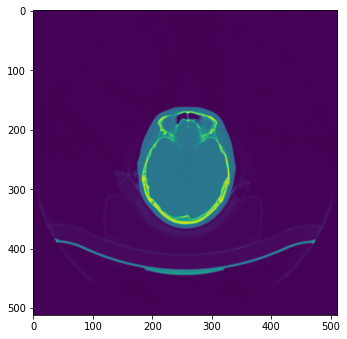

Test:  23%|██▎       | 133/578 [00:55<02:51,  2.59it/s]2686.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00021.dcm
2710.683 3.4897485 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00021.dcm
2685.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00021.dcm


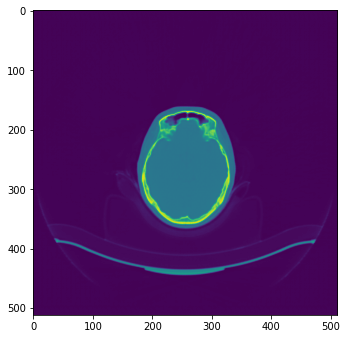

Test:  23%|██▎       | 134/578 [00:55<02:59,  2.48it/s]2727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00022.dcm
2776.1384 1.7874053 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00022.dcm
2726.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00022.dcm


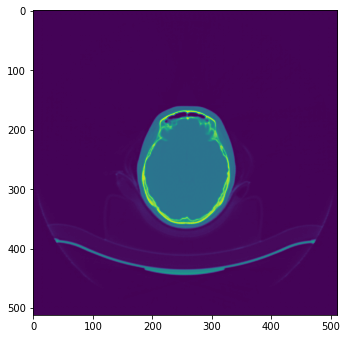

Test:  23%|██▎       | 135/578 [00:56<02:54,  2.53it/s]2721.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00023.dcm
2877.2346 2.852697 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00023.dcm
2724.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00023.dcm


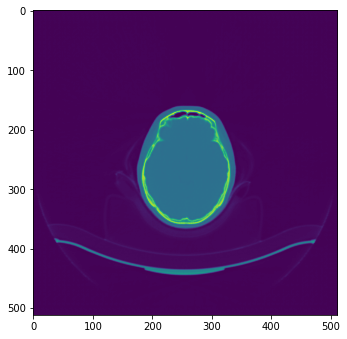

Test:  24%|██▎       | 136/578 [00:56<03:04,  2.40it/s]2761.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00024.dcm
2804.834 2.0228214 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00024.dcm
2752.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00024.dcm


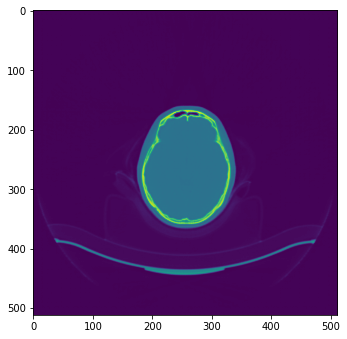

Test:  24%|██▎       | 137/578 [00:56<03:02,  2.42it/s]2744.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00025.dcm
2746.1284 2.0888453 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00025.dcm
2743.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00025.dcm


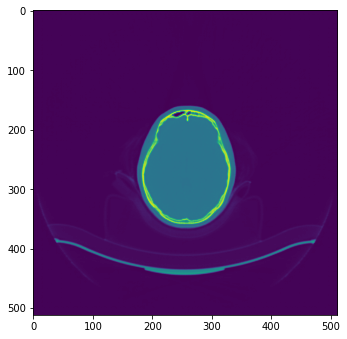

Test:  24%|██▍       | 138/578 [00:57<03:00,  2.44it/s]2743.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00026.dcm
2742.4143 3.3179154 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00026.dcm
2747.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00026.dcm


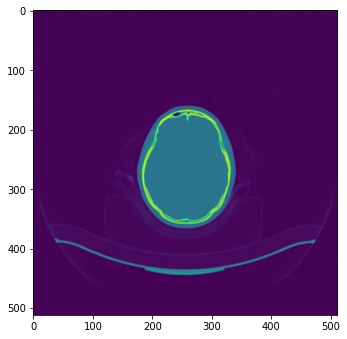

Test:  24%|██▍       | 139/578 [00:57<03:01,  2.42it/s]2719.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00027.dcm
2761.9949 3.2346838 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00027.dcm
2722.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00027.dcm


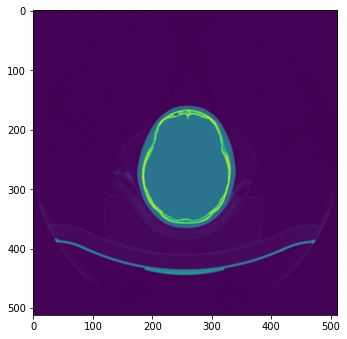

Test:  24%|██▍       | 140/578 [00:58<03:00,  2.42it/s]2726.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00028.dcm
2755.4312 3.33854 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00028.dcm
2727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00028.dcm


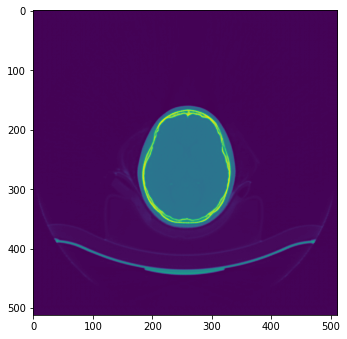

Test:  24%|██▍       | 141/578 [00:58<03:03,  2.38it/s]2717.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00029.dcm
2740.2502 3.3515985 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00029.dcm
2711.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00029.dcm


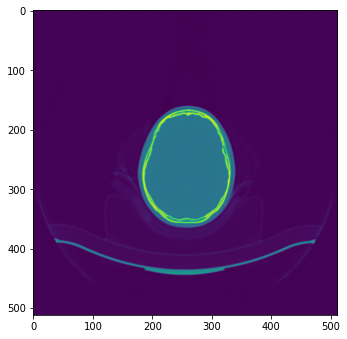

Test:  25%|██▍       | 142/578 [00:59<03:04,  2.37it/s]2703.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00030.dcm
2689.1443 3.2689772 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00030.dcm
2701.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00030.dcm


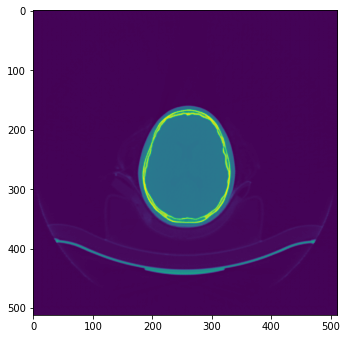

Test:  25%|██▍       | 143/578 [00:59<03:01,  2.39it/s]2691.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00031.dcm
2685.2842 3.1823282 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00031.dcm
2685.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00031.dcm


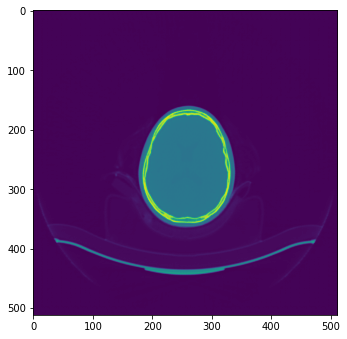

Test:  25%|██▍       | 144/578 [00:59<02:54,  2.48it/s]2661.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00032.dcm
2663.462 3.2494507 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00032.dcm
2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00032.dcm


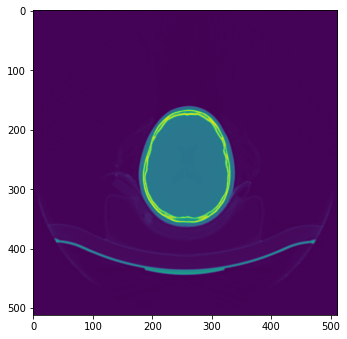

Test:  25%|██▌       | 145/578 [01:00<02:50,  2.54it/s]2674.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00033.dcm
2599.0317 3.2754452 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00033.dcm
2663.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00033.dcm


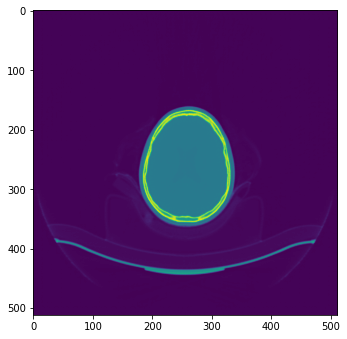

Test:  25%|██▌       | 146/578 [01:00<03:06,  2.31it/s]2656.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00034.dcm
2644.8435 3.3359773 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00034.dcm
2658.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00034.dcm


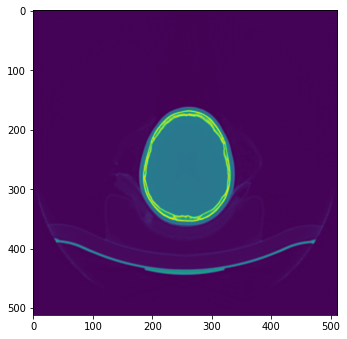

Test:  25%|██▌       | 147/578 [01:01<03:03,  2.35it/s]2643.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00035.dcm
2634.8828 3.2222357 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00035.dcm
2646.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00035.dcm


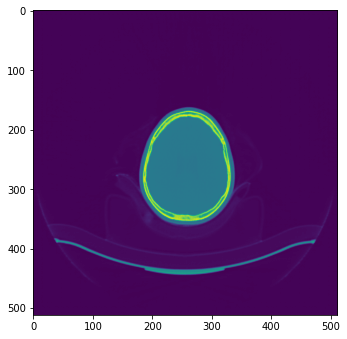

Test:  26%|██▌       | 148/578 [01:01<03:08,  2.28it/s]2655.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00036.dcm
2646.737 3.259702 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00036.dcm
2658.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00036.dcm


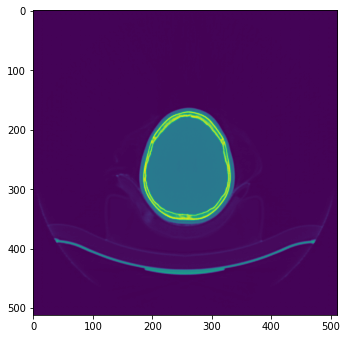

Test:  26%|██▌       | 149/578 [01:02<03:06,  2.30it/s]2683.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00037.dcm
2678.67 3.2500608 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00037.dcm
2690.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00037.dcm


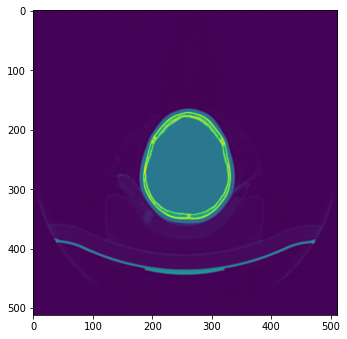

Test:  26%|██▌       | 150/578 [01:02<03:04,  2.32it/s]2672.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00038.dcm
2657.8154 3.2670245 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00038.dcm
2673.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00038.dcm


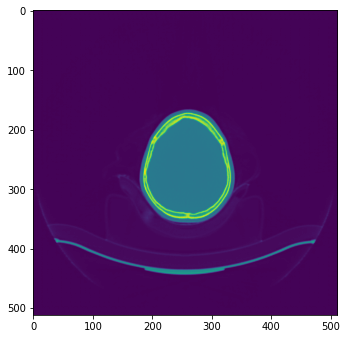

Test:  26%|██▌       | 151/578 [01:02<03:03,  2.32it/s]2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00039.dcm
2635.5908 3.154503 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00039.dcm
2656.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00039.dcm


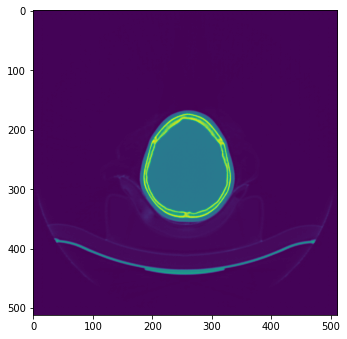

Test:  26%|██▋       | 152/578 [01:03<02:54,  2.45it/s]2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00040.dcm
2596.439 3.22968 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00040.dcm
2601.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00040.dcm


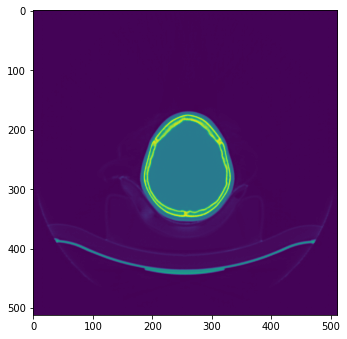

Test:  26%|██▋       | 153/578 [01:03<02:45,  2.57it/s]2574.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00041.dcm
2616.0222 3.1890407 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00041.dcm
2570.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00041.dcm


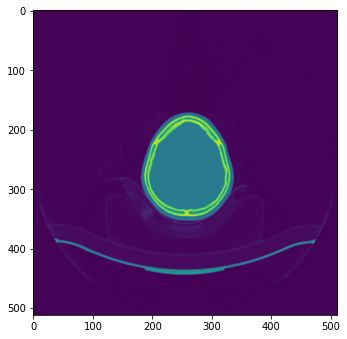

Test:  27%|██▋       | 154/578 [01:04<03:12,  2.21it/s]2594.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00042.dcm
2598.3032 3.2064924 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00042.dcm
2593.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00042.dcm


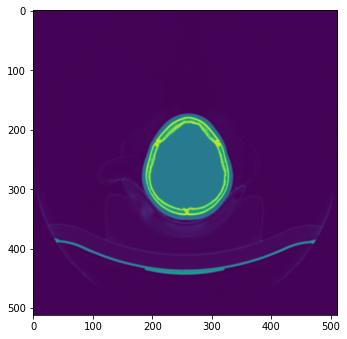

Test:  27%|██▋       | 155/578 [01:04<02:57,  2.38it/s]2600.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00043.dcm
2601.1467 3.1554794 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00043.dcm
2593.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00043.dcm


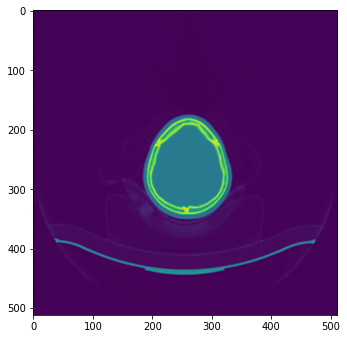

Test:  27%|██▋       | 156/578 [01:04<02:58,  2.36it/s]2631.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00044.dcm
2608.3372 3.0927505 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00044.dcm
2627.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00044.dcm


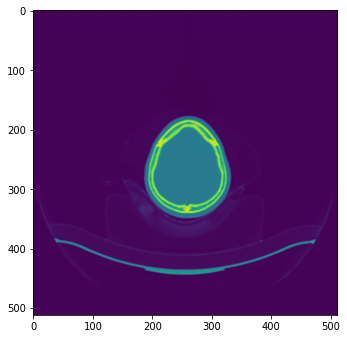

Test:  27%|██▋       | 157/578 [01:05<02:54,  2.42it/s]2603.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00045.dcm
2648.3699 2.9968266 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00045.dcm
2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00045.dcm


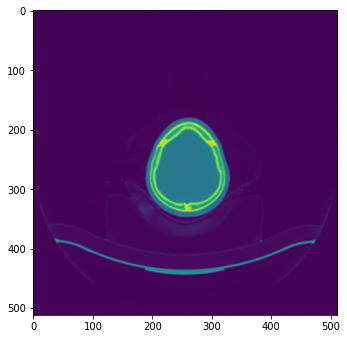

Test:  27%|██▋       | 158/578 [01:05<02:50,  2.46it/s]2628.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00046.dcm
2620.0605 3.0408833 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00046.dcm
2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00046.dcm


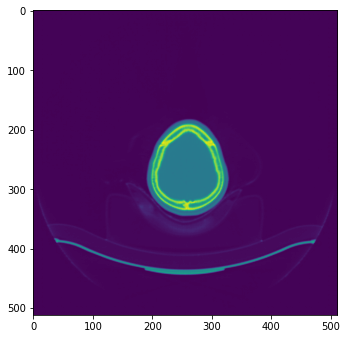

Test:  28%|██▊       | 159/578 [01:06<02:45,  2.53it/s]2634.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00047.dcm
2632.117 2.9470344 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00047.dcm
2625.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00047.dcm


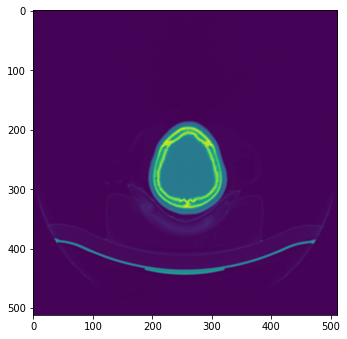

Test:  28%|██▊       | 160/578 [01:06<02:41,  2.59it/s]2619.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00048.dcm
2635.6245 2.8505 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00048.dcm
2619.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00048.dcm


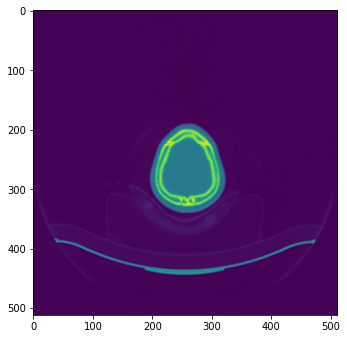

Test:  28%|██▊       | 161/578 [01:06<02:43,  2.54it/s]2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00049.dcm
2564.217 2.723334 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00049.dcm
2620.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00049.dcm


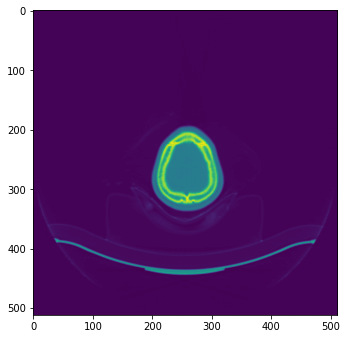

Test:  28%|██▊       | 162/578 [01:07<02:40,  2.59it/s]2585.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00050.dcm
2612.9429 2.6685379 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00050.dcm
2582.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00050.dcm


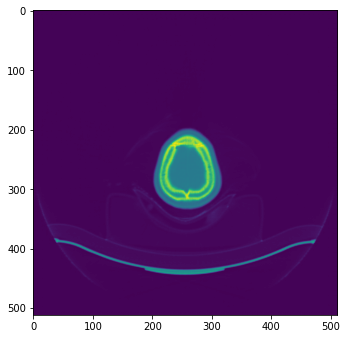

Test:  28%|██▊       | 163/578 [01:07<02:43,  2.54it/s]2584.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00051.dcm
2612.7712 2.6520624 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00051.dcm
2583.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00051.dcm


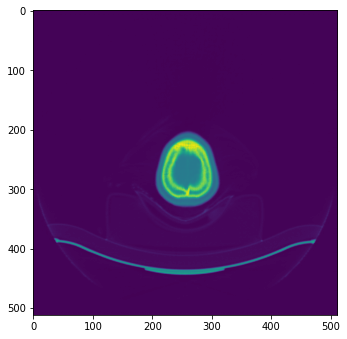

Test:  28%|██▊       | 164/578 [01:08<02:55,  2.36it/s]2554.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00052.dcm
2603.8914 2.6803758 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00052.dcm
2555.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00052.dcm


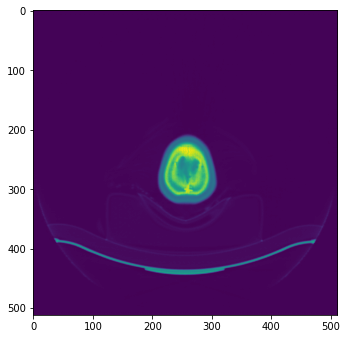

Test:  29%|██▊       | 165/578 [01:08<02:47,  2.47it/s]2532.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00053.dcm
2595.3887 2.3246276 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00053.dcm
2538.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00053.dcm


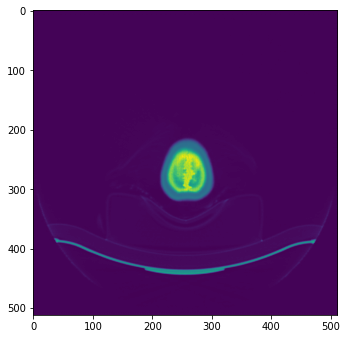

Test:  29%|██▊       | 166/578 [01:08<02:42,  2.54it/s]2572.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00054.dcm
2600.5466 2.2085671 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00054.dcm
2572.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00054.dcm


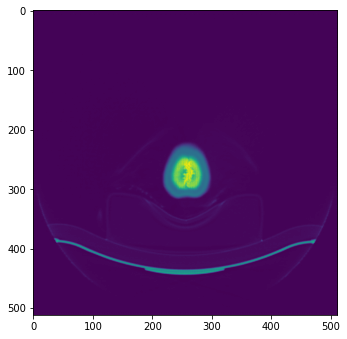

Test:  29%|██▉       | 167/578 [01:09<02:36,  2.63it/s]2313.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00055.dcm
2382.969 1.9376372 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00055.dcm
2317.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00055.dcm


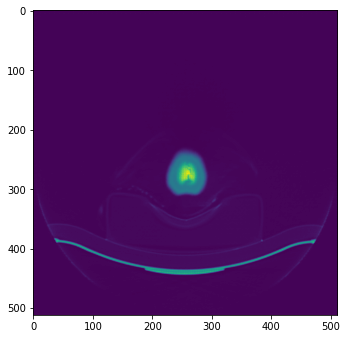

Test:  29%|██▉       | 168/578 [01:09<02:37,  2.61it/s]1648.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00056.dcm
1867.5272 1.7219915 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00056.dcm
1647.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00056.dcm


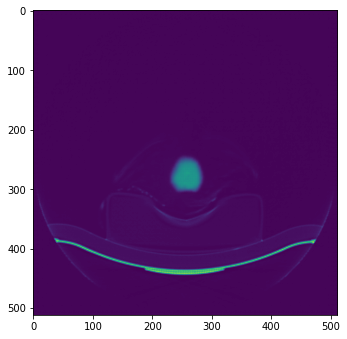

Test:  29%|██▉       | 169/578 [01:10<02:32,  2.68it/s]1680.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00057.dcm
1935.4778 1.678179 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00057.dcm
1677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00057.dcm


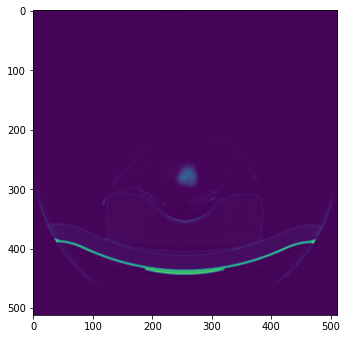

Test:  29%|██▉       | 170/578 [01:10<02:39,  2.56it/s]1702.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00058.dcm
1945.7501 1.7930192 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00058.dcm
1701.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00058.dcm


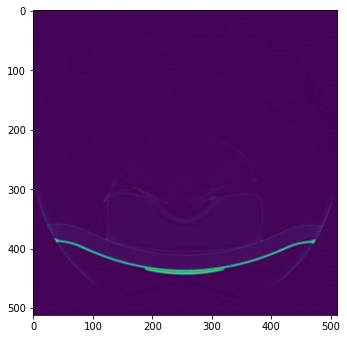

Test:  30%|██▉       | 171/578 [01:10<02:40,  2.53it/s]1687.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00059.dcm
1926.0515 1.8764949 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00059.dcm
1689.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164154_00059.dcm


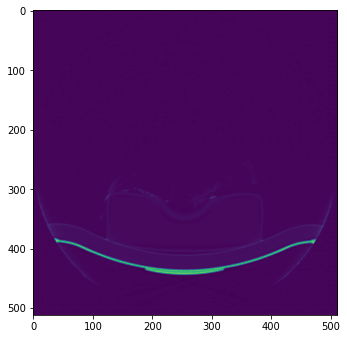

Test:  30%|██▉       | 172/578 [01:11<02:35,  2.61it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00060.dcm
3546.8557 5.2986326 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00060.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164155_00060.dcm


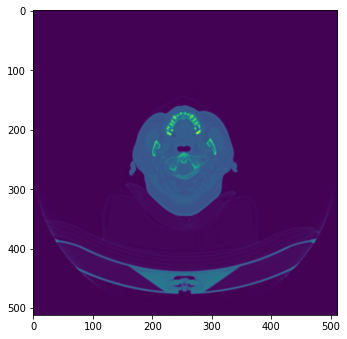

Test:  30%|██▉       | 173/578 [01:11<02:46,  2.44it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/gt_low_BAE_SO_DAM_F17_001_20201117_181318_00061.dcm
3340.6614 5.08616 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/BAE_SO_DAM_F17/pred_high_BAE_SO_DAM_F17_001_20201117_181318_00061.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/BAE_SO_DAM_F17/gt_high_BAE_SO_DAM_F17_001_20201117_164155_00061.dcm


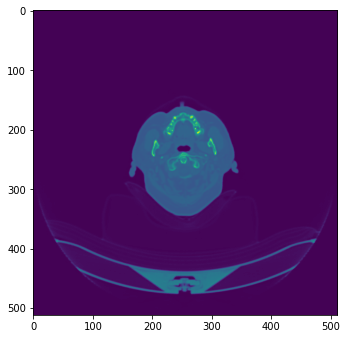

Test:  30%|███       | 174/578 [01:12<02:39,  2.53it/s]2839.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00001.dcm
2805.3838 5.487796 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00001.dcm
2835.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00001.dcm


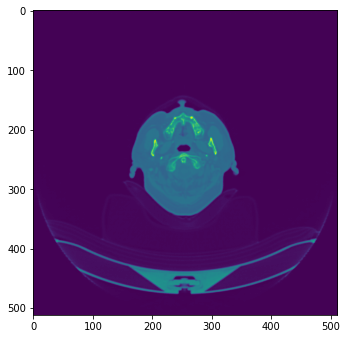

Test:  30%|███       | 175/578 [01:12<02:45,  2.43it/s]2759.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00002.dcm
2740.2642 5.1403465 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00002.dcm
2756.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00002.dcm


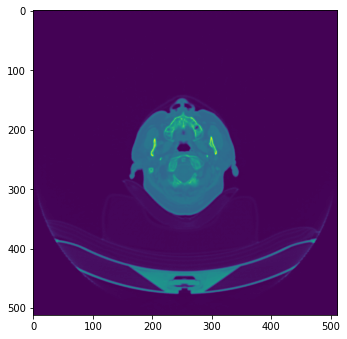

Test:  30%|███       | 176/578 [01:12<02:46,  2.42it/s]2694.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00003.dcm
2671.8538 5.1340003 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00003.dcm
2686.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00003.dcm


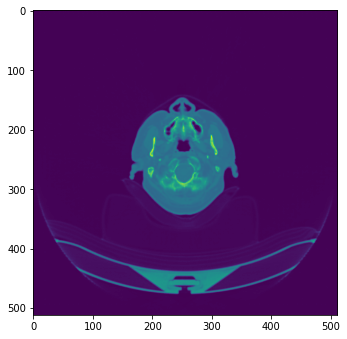

Test:  31%|███       | 177/578 [01:13<02:50,  2.36it/s]2644.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00004.dcm
2627.8752 5.7312665 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00004.dcm
2648.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00004.dcm


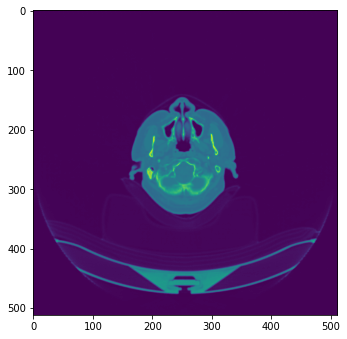

Test:  31%|███       | 178/578 [01:13<02:45,  2.41it/s]2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00005.dcm
2584.9192 5.5820107 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00005.dcm
2618.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00005.dcm


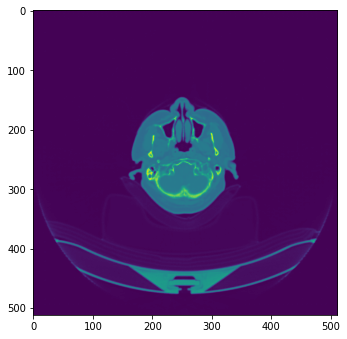

Test:  31%|███       | 179/578 [01:14<02:50,  2.35it/s]2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00006.dcm
2575.8906 4.8369536 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00006.dcm
2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00006.dcm


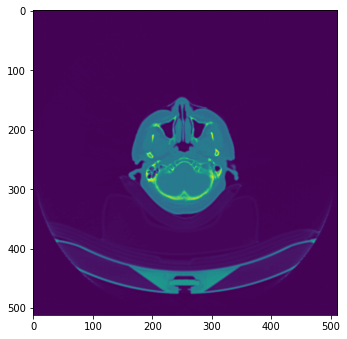

Test:  31%|███       | 180/578 [01:14<02:48,  2.36it/s]2637.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00007.dcm
2634.3772 5.6108127 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00007.dcm
2643.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170620_00007.dcm


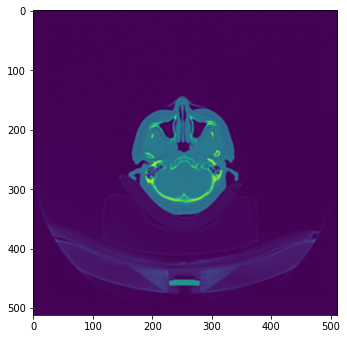

Test:  31%|███▏      | 181/578 [01:15<02:46,  2.39it/s]2642.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00008.dcm
2649.426 5.694166 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00008.dcm
2645.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00008.dcm


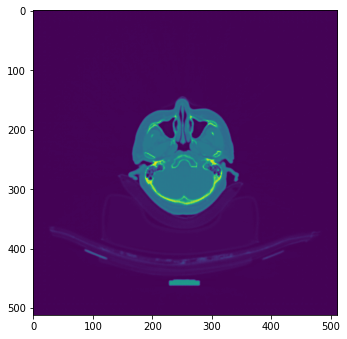

Test:  31%|███▏      | 182/578 [01:15<03:00,  2.20it/s]2658.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00009.dcm
2681.1055 3.9716864 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00009.dcm
2656.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00009.dcm


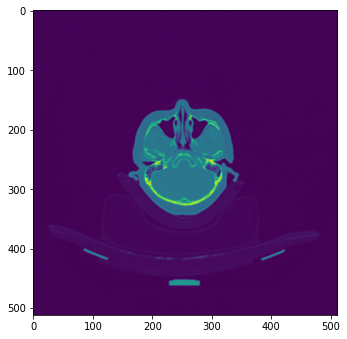

Test:  32%|███▏      | 183/578 [01:15<02:56,  2.24it/s]2607.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00010.dcm
2621.3662 5.757993 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00010.dcm
2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00010.dcm


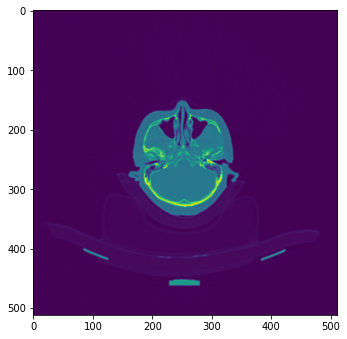

Test:  32%|███▏      | 184/578 [01:16<02:50,  2.31it/s]2741.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00011.dcm
2710.2188 5.8813763 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00011.dcm
2733.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00011.dcm


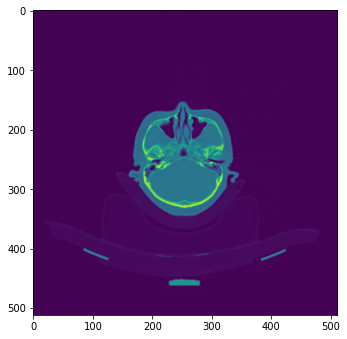

Test:  32%|███▏      | 185/578 [01:16<02:41,  2.44it/s]2973.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00012.dcm
2931.7168 6.0651693 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00012.dcm
2969.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00012.dcm


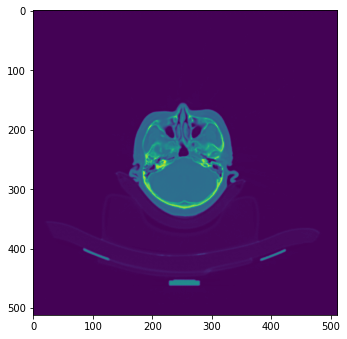

Test:  32%|███▏      | 186/578 [01:17<02:45,  2.37it/s]3047.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00013.dcm
2953.915 5.678911 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00013.dcm
3042.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00013.dcm


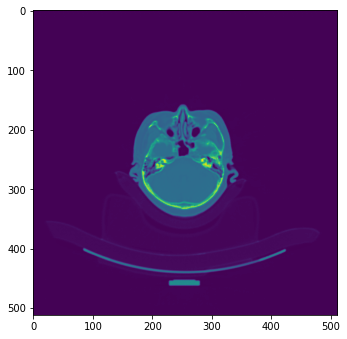

Test:  32%|███▏      | 187/578 [01:17<02:40,  2.43it/s]2969.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00014.dcm
2953.4658 3.6593847 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00014.dcm
2969.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00014.dcm


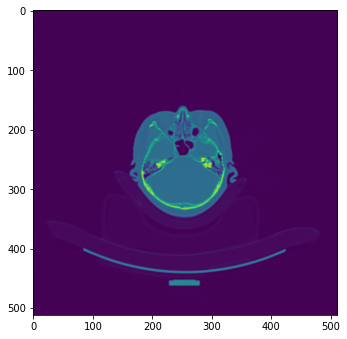

Test:  33%|███▎      | 188/578 [01:18<02:41,  2.41it/s]2827.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00015.dcm
2841.873 3.5616302 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00015.dcm
2835.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00015.dcm


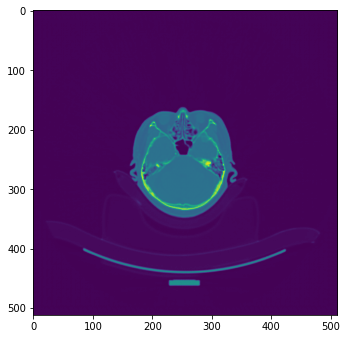

Test:  33%|███▎      | 189/578 [01:18<02:36,  2.48it/s]2681.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00016.dcm
2671.0298 3.367586 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00016.dcm
2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00016.dcm


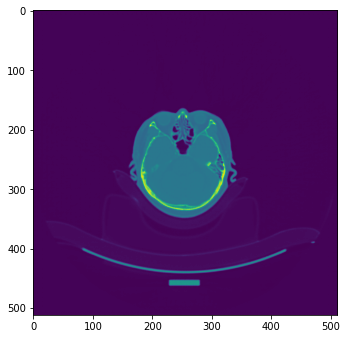

Test:  33%|███▎      | 190/578 [01:18<02:41,  2.41it/s]2674.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00017.dcm
2631.5364 3.4560652 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00017.dcm
2681.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00017.dcm


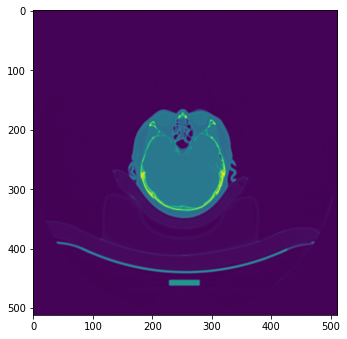

Test:  33%|███▎      | 191/578 [01:19<02:37,  2.46it/s]2685.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00018.dcm
2684.1047 3.7075906 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00018.dcm
2689.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00018.dcm


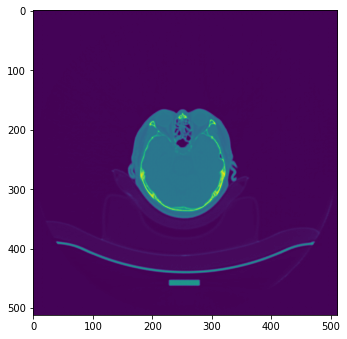

Test:  33%|███▎      | 192/578 [01:19<02:40,  2.40it/s]2650.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00019.dcm
2701.1497 3.7714179 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00019.dcm
2652.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00019.dcm


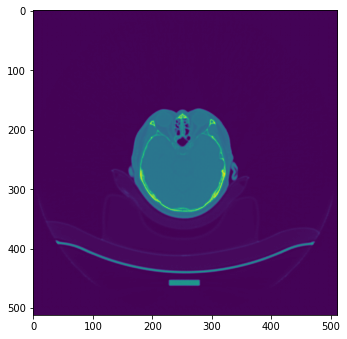

Test:  33%|███▎      | 193/578 [01:20<02:42,  2.37it/s]2624.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00020.dcm
2570.9736 3.485599 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00020.dcm
2625.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00020.dcm


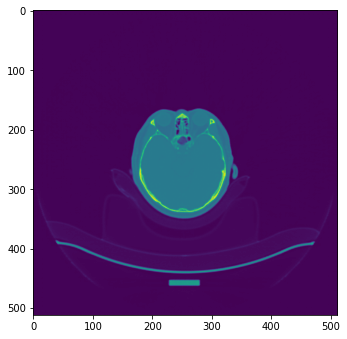

Test:  34%|███▎      | 194/578 [01:20<02:43,  2.35it/s]2615.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00021.dcm
2548.7703 3.4535024 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00021.dcm
2610.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00021.dcm


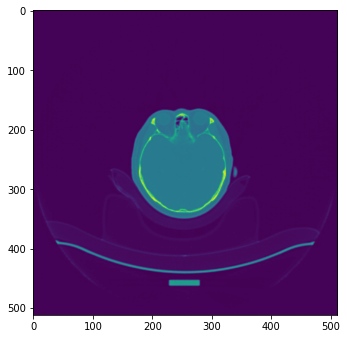

Test:  34%|███▎      | 195/578 [01:20<02:46,  2.31it/s]2576.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00022.dcm
2548.9248 3.2650719 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00022.dcm
2575.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00022.dcm


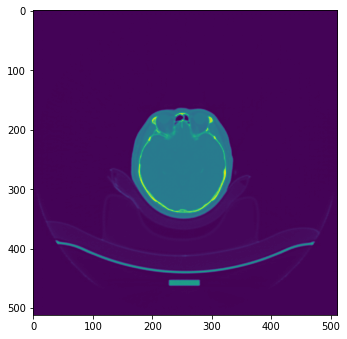

Test:  34%|███▍      | 196/578 [01:21<02:42,  2.36it/s]2537.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00023.dcm
2475.71 3.4268975 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00023.dcm
2536.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00023.dcm


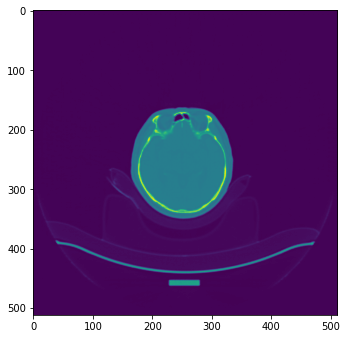

Test:  34%|███▍      | 197/578 [01:21<02:42,  2.35it/s]2518.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00024.dcm
2524.1194 3.675494 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00024.dcm
2513.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00024.dcm


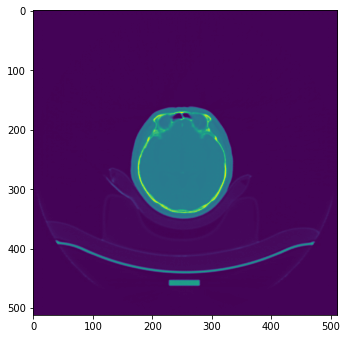

Test:  34%|███▍      | 198/578 [01:22<02:35,  2.44it/s]2489.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00025.dcm
2615.1792 3.5655355 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00025.dcm
2489.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00025.dcm


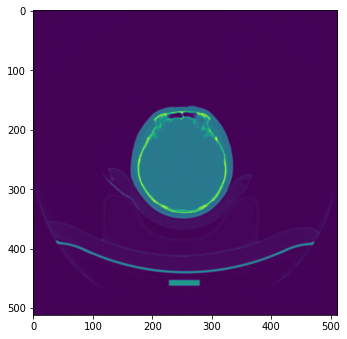

Test:  34%|███▍      | 199/578 [01:22<02:41,  2.34it/s]2577.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00026.dcm
2590.1543 3.2313886 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00026.dcm
2585.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00026.dcm


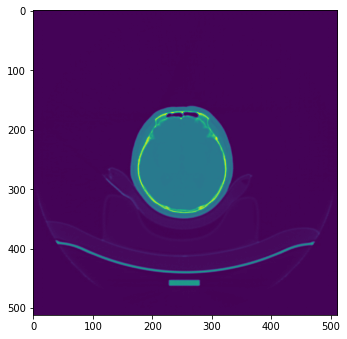

Test:  35%|███▍      | 200/578 [01:23<02:52,  2.19it/s]2539.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00027.dcm
2536.858 3.4078593 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00027.dcm
2545.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00027.dcm


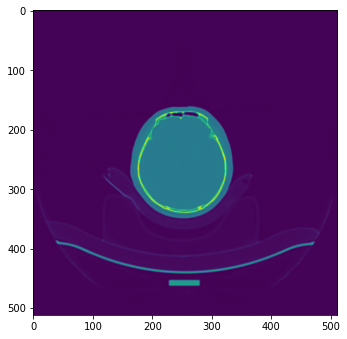

Test:  35%|███▍      | 201/578 [01:23<02:42,  2.32it/s]2533.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00028.dcm
2515.965 3.4502072 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00028.dcm
2534.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00028.dcm


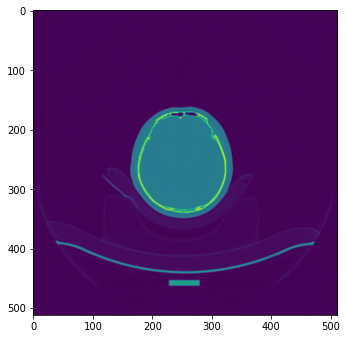

Test:  35%|███▍      | 202/578 [01:23<02:34,  2.44it/s]2558.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00029.dcm
2503.9478 3.401513 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00029.dcm
2561.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00029.dcm


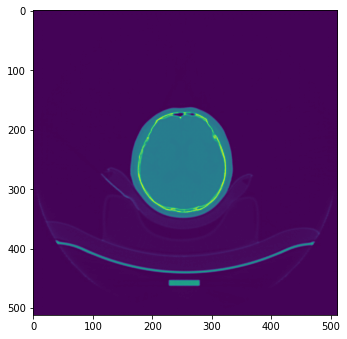

Test:  35%|███▌      | 203/578 [01:24<02:37,  2.38it/s]2524.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00030.dcm
2479.7893 3.0610201 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00030.dcm
2520.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00030.dcm


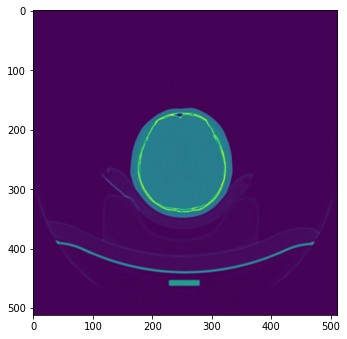

Test:  35%|███▌      | 204/578 [01:24<02:34,  2.42it/s]2514.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00031.dcm
2498.0178 2.9832802 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00031.dcm
2508.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00031.dcm


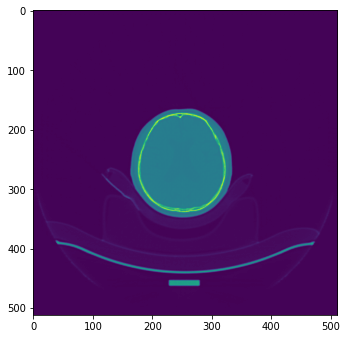

Test:  35%|███▌      | 205/578 [01:25<02:30,  2.48it/s]2539.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00032.dcm
2505.8464 2.9834023 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00032.dcm
2534.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00032.dcm


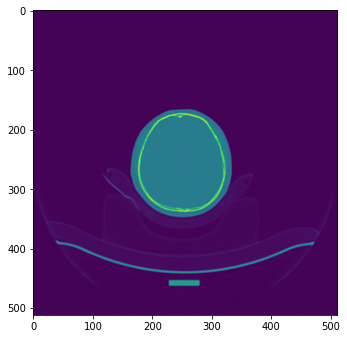

Test:  36%|███▌      | 206/578 [01:25<02:29,  2.48it/s]2477.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00033.dcm
2449.5413 2.9148154 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00033.dcm
2479.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00033.dcm


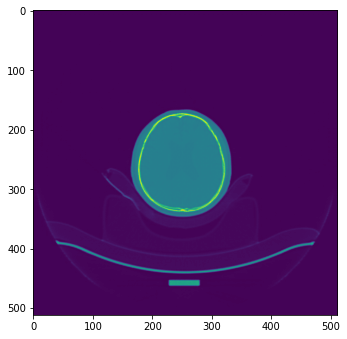

Test:  36%|███▌      | 207/578 [01:25<02:30,  2.46it/s]2497.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00034.dcm
2451.4631 2.7908225 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00034.dcm
2497.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00034.dcm


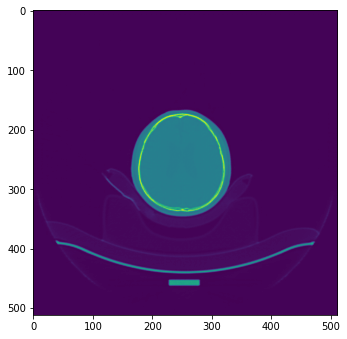

Test:  36%|███▌      | 208/578 [01:26<02:29,  2.47it/s]2512.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00035.dcm
2480.5576 2.9210396 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00035.dcm
2509.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00035.dcm


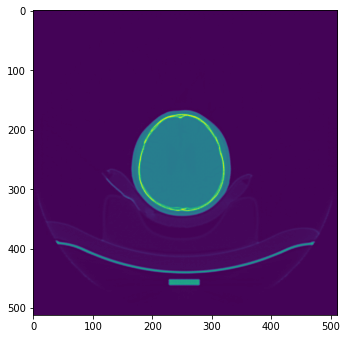

Test:  36%|███▌      | 209/578 [01:26<02:33,  2.40it/s]2464.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00036.dcm
2447.5369 3.1347325 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00036.dcm
2460.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00036.dcm


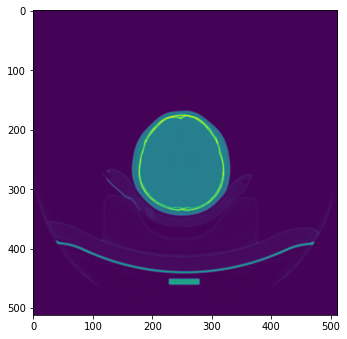

Test:  36%|███▋      | 210/578 [01:27<02:34,  2.38it/s]2516.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00037.dcm
2491.782 2.9447155 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00037.dcm
2511.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00037.dcm


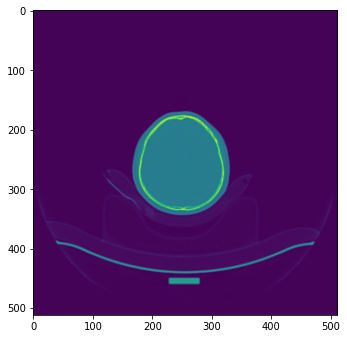

Test:  37%|███▋      | 211/578 [01:27<02:37,  2.32it/s]2447.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00038.dcm
2425.8892 3.139492 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00038.dcm
2445.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00038.dcm


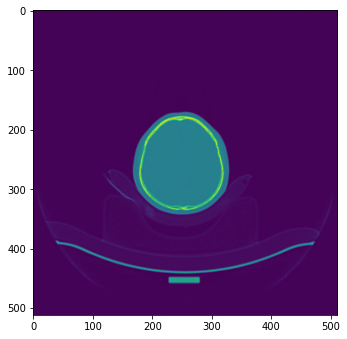

Test:  37%|███▋      | 212/578 [01:28<02:40,  2.28it/s]2410.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00039.dcm
2400.8728 2.9902365 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00039.dcm
2411.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00039.dcm


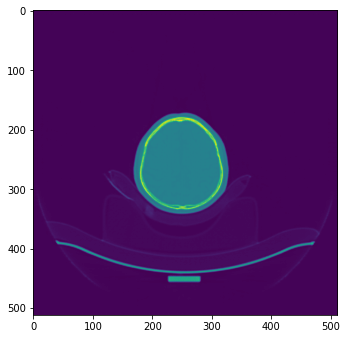

Test:  37%|███▋      | 213/578 [01:28<02:38,  2.31it/s]2382.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00040.dcm
2376.0894 3.8840613 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00040.dcm
2381.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00040.dcm


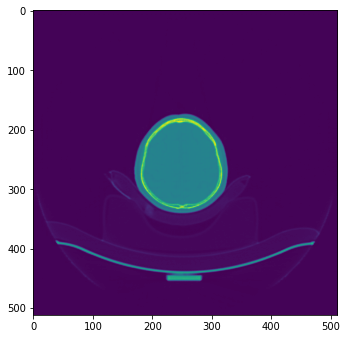

Test:  37%|███▋      | 214/578 [01:28<02:39,  2.28it/s]2382.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00041.dcm
2352.8074 5.3236513 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00041.dcm
2376.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00041.dcm


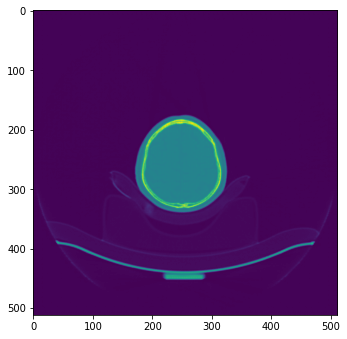

Test:  37%|███▋      | 215/578 [01:29<02:38,  2.30it/s]2329.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00042.dcm
2321.8538 4.4847445 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00042.dcm
2325.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00042.dcm


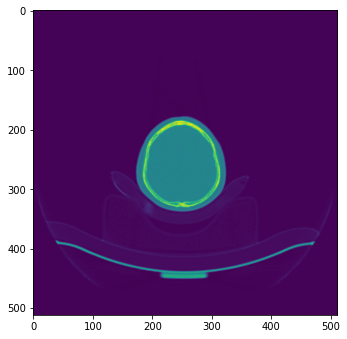

Test:  37%|███▋      | 216/578 [01:29<02:36,  2.31it/s]2273.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00043.dcm
2324.9822 4.7156453 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00043.dcm
2273.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00043.dcm


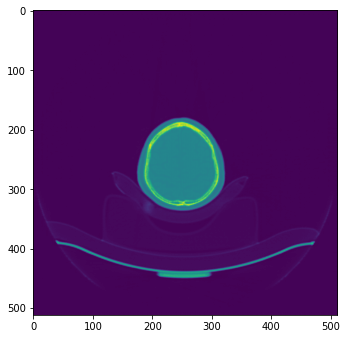

Test:  38%|███▊      | 217/578 [01:30<02:33,  2.36it/s]2298.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00044.dcm
2286.2979 4.5535755 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00044.dcm
2296.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00044.dcm


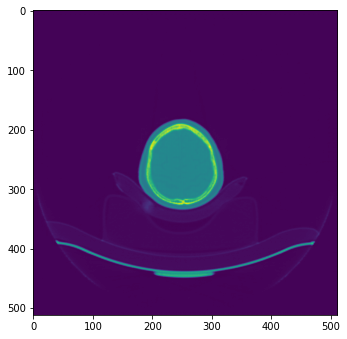

Test:  38%|███▊      | 218/578 [01:30<02:37,  2.28it/s]2351.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00045.dcm
2337.62 3.1833048 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00045.dcm
2355.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00045.dcm


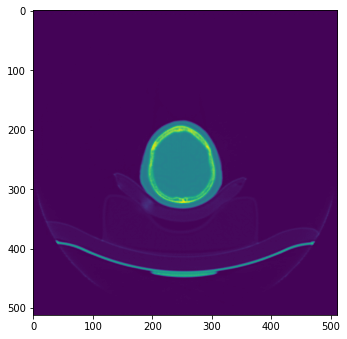

Test:  38%|███▊      | 219/578 [01:31<02:42,  2.21it/s]2324.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00046.dcm
2364.3357 2.6415668 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00046.dcm
2323.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00046.dcm


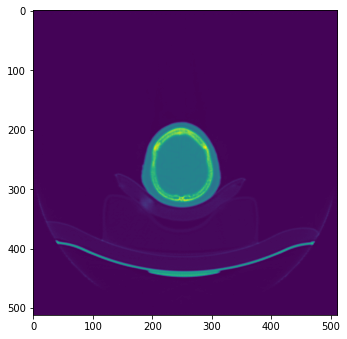

Test:  38%|███▊      | 220/578 [01:31<02:32,  2.35it/s]2434.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00047.dcm
2453.4248 2.644984 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00047.dcm
2436.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00047.dcm


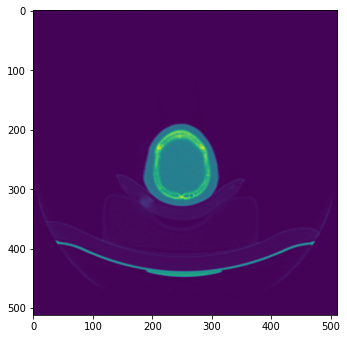

Test:  38%|███▊      | 221/578 [01:32<02:33,  2.32it/s]2422.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00048.dcm
2382.9531 2.3725896 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00048.dcm
2420.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00048.dcm


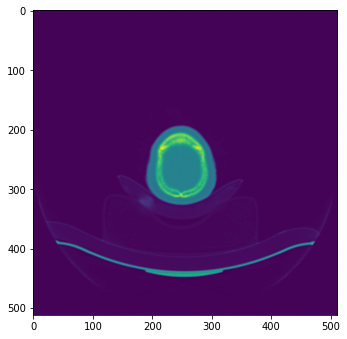

Test:  38%|███▊      | 222/578 [01:32<02:32,  2.33it/s]2387.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00049.dcm
2375.0828 2.2670245 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00049.dcm
2392.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00049.dcm


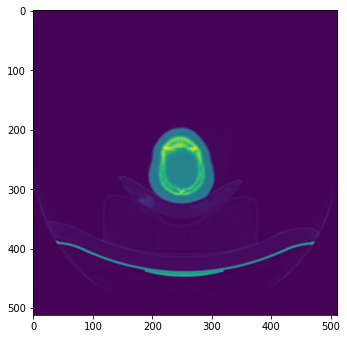

Test:  39%|███▊      | 223/578 [01:32<02:33,  2.31it/s]2365.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00050.dcm
2388.783 2.0806687 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00050.dcm
2363.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00050.dcm


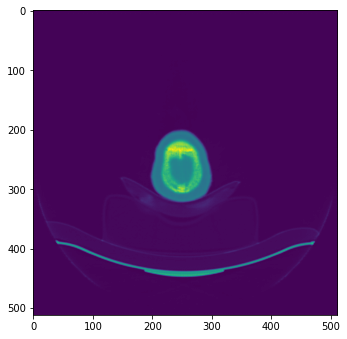

Test:  39%|███▉      | 224/578 [01:33<02:27,  2.40it/s]2430.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00051.dcm
2440.3398 2.1785452 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00051.dcm
2425.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00051.dcm


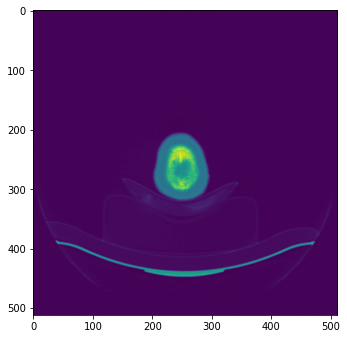

Test:  39%|███▉      | 225/578 [01:33<02:24,  2.45it/s]2344.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00052.dcm
2383.6282 1.8566023 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00052.dcm
2346.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00052.dcm


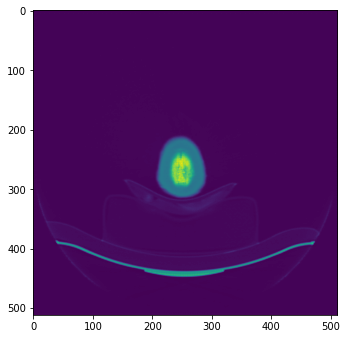

Test:  39%|███▉      | 226/578 [01:34<02:23,  2.45it/s]1898.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00053.dcm
1952.894 1.7266291 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00053.dcm
1895.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00053.dcm


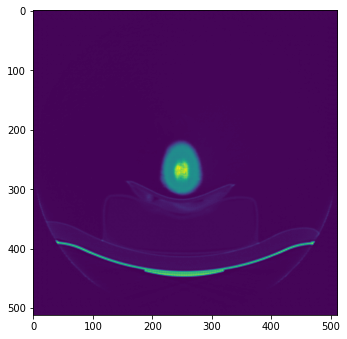

Test:  39%|███▉      | 227/578 [01:34<02:19,  2.52it/s]1594.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00054.dcm
1647.1029 1.6828166 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00054.dcm
1590.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00054.dcm


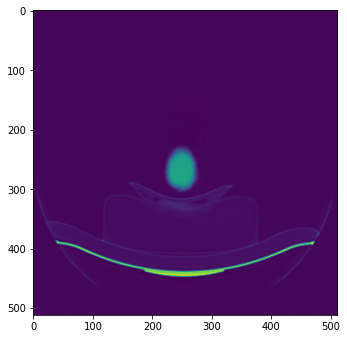

Test:  39%|███▉      | 228/578 [01:34<02:22,  2.45it/s]1608.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00055.dcm
1659.5906 1.9123747 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00055.dcm
1605.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00055.dcm


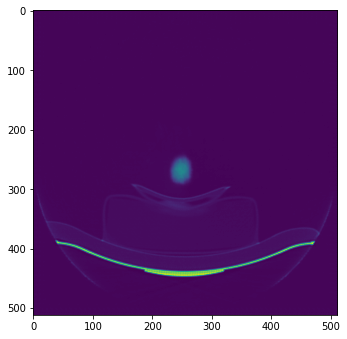

Test:  40%|███▉      | 229/578 [01:35<02:23,  2.43it/s]1659.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/gt_low_CHA_EUN_F29_001_20201119_092625_00056.dcm
1681.9594 1.8701488 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_EUN_F29/pred_high_CHA_EUN_F29_001_20201119_092625_00056.dcm
1672.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_EUN_F29/gt_high_CHA_EUN_F29_001_20201118_170621_00056.dcm


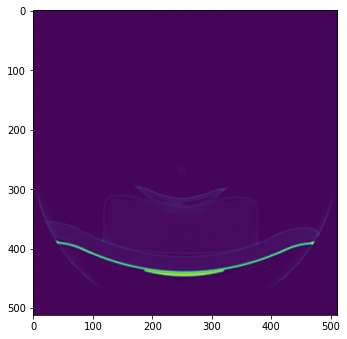

Test:  40%|███▉      | 230/578 [01:35<02:25,  2.39it/s]2926.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00001.dcm
2815.1519 3.9215276 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00001.dcm
2930.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00001.dcm


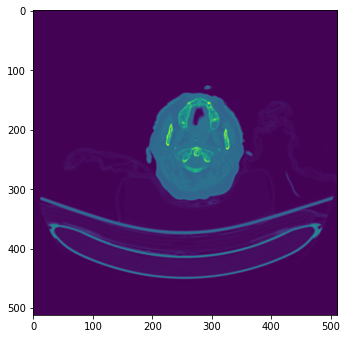

Test:  40%|███▉      | 231/578 [01:36<02:29,  2.32it/s]2853.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00002.dcm
2740.3828 4.3403707 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00002.dcm
2849.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00002.dcm


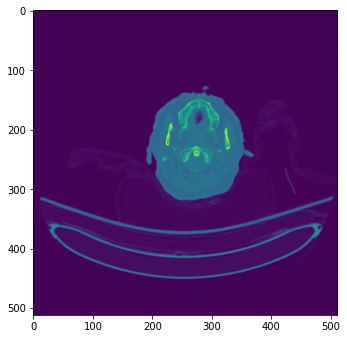

Test:  40%|████      | 232/578 [01:36<02:22,  2.42it/s]2781.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00003.dcm
2719.761 4.1900167 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00003.dcm
2777.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00003.dcm


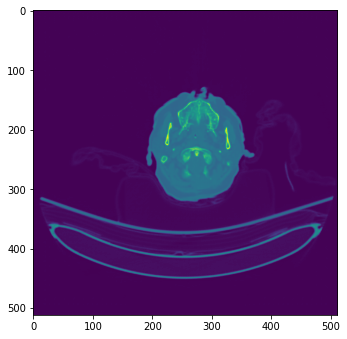

Test:  40%|████      | 233/578 [01:36<02:24,  2.39it/s]2722.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00004.dcm
2737.498 4.841591 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00004.dcm
2722.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00004.dcm


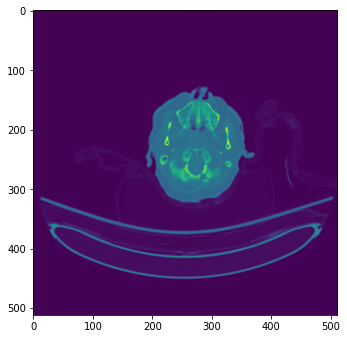

Test:  40%|████      | 234/578 [01:37<02:26,  2.35it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00005.dcm
3420.1838 5.4009027 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00005.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00005.dcm


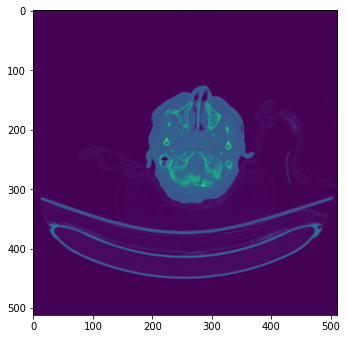

Test:  41%|████      | 235/578 [01:37<02:32,  2.25it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00006.dcm
3149.7566 5.281547 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00006.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00006.dcm


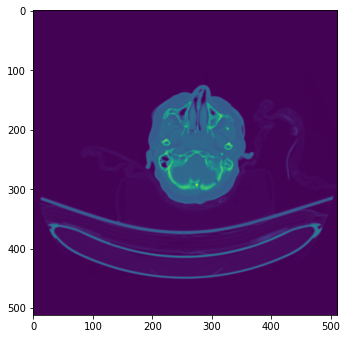

Test:  41%|████      | 236/578 [01:38<02:45,  2.07it/s]2652.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00007.dcm
2680.4683 4.9159136 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00007.dcm
2648.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00007.dcm


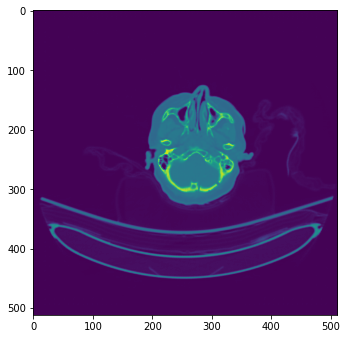

Test:  41%|████      | 237/578 [01:38<02:40,  2.12it/s]2610.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00008.dcm
2628.2236 5.3673415 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00008.dcm
2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00008.dcm


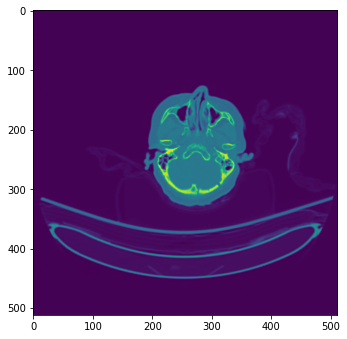

Test:  41%|████      | 238/578 [01:39<02:44,  2.06it/s]2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00009.dcm
2744.0508 5.748352 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00009.dcm
2682.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00009.dcm


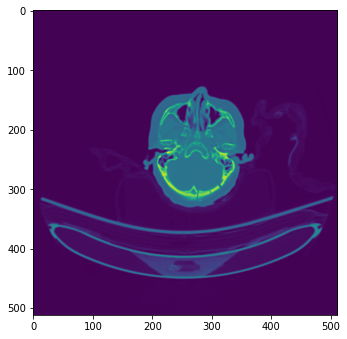

Test:  41%|████▏     | 239/578 [01:39<02:37,  2.15it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00010.dcm
3446.8389 5.973761 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00010.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00010.dcm


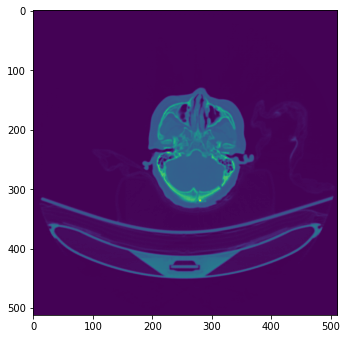

Test:  42%|████▏     | 240/578 [01:40<02:32,  2.22it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00011.dcm
3430.9033 5.2228456 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00011.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00011.dcm


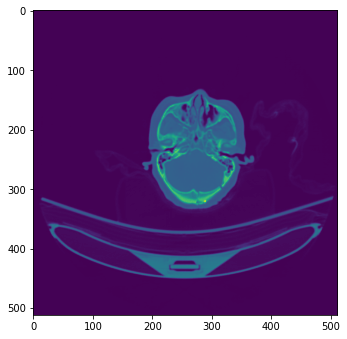

Test:  42%|████▏     | 241/578 [01:40<02:26,  2.30it/s]2948.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00012.dcm
2900.554 5.315963 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00012.dcm
2955.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00012.dcm


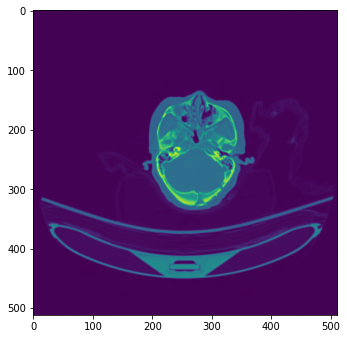

Test:  42%|████▏     | 242/578 [01:41<02:24,  2.32it/s]4047.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00013.dcm
3333.2502 4.8036366 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00013.dcm
4057.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00013.dcm


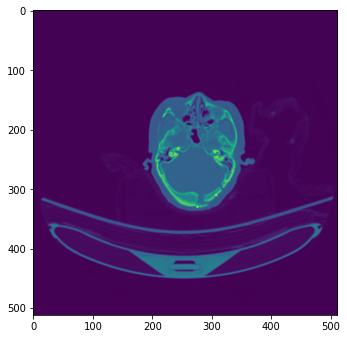

Test:  42%|████▏     | 243/578 [01:41<02:23,  2.34it/s]2949.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00014.dcm
2793.2249 5.0652914 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00014.dcm
2945.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00014.dcm


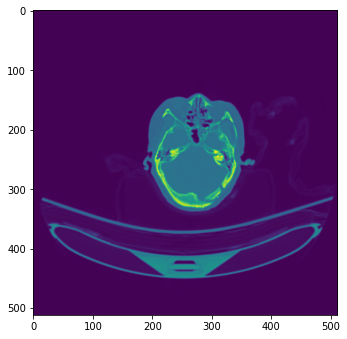

Test:  42%|████▏     | 244/578 [01:42<02:49,  1.97it/s]3099.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00015.dcm
2681.0112 5.1922135 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00015.dcm
3103.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00015.dcm


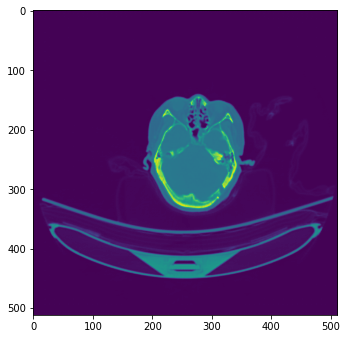

Test:  42%|████▏     | 245/578 [01:42<02:44,  2.03it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00016.dcm
3448.136 5.391994 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00016.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00016.dcm


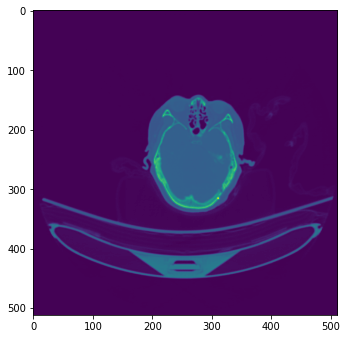

Test:  43%|████▎     | 246/578 [01:43<02:35,  2.14it/s]2607.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00017.dcm
2624.1108 5.6197214 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00017.dcm
2607.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00017.dcm


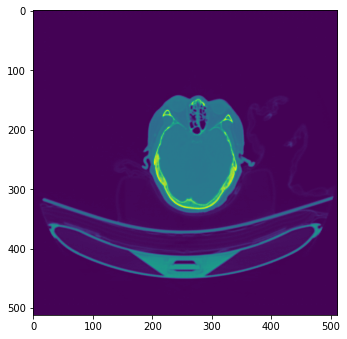

Test:  43%|████▎     | 247/578 [01:43<02:32,  2.17it/s]2628.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00018.dcm
2635.0854 5.753844 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00018.dcm
2626.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00018.dcm


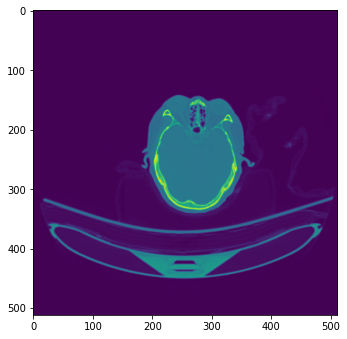

Test:  43%|████▎     | 248/578 [01:43<02:25,  2.26it/s]2588.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00019.dcm
2565.5671 5.5046372 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00019.dcm
2584.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00019.dcm


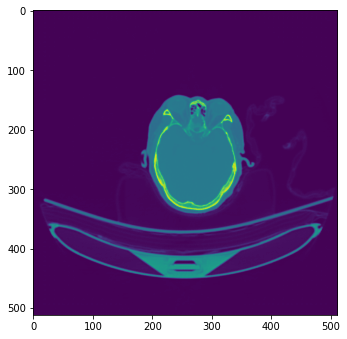

Test:  43%|████▎     | 249/578 [01:44<02:25,  2.27it/s]2624.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00020.dcm
2636.2307 5.5759087 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00020.dcm
2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00020.dcm


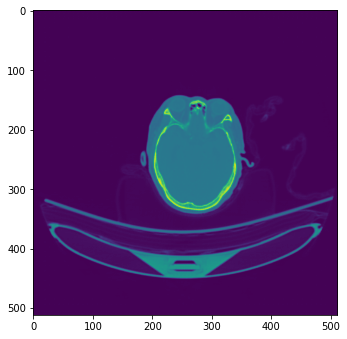

Test:  43%|████▎     | 250/578 [01:44<02:21,  2.32it/s]2597.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00021.dcm
2537.395 5.614596 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00021.dcm
2594.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00021.dcm


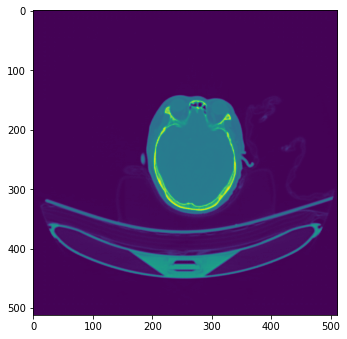

Test:  43%|████▎     | 251/578 [01:45<02:13,  2.45it/s]2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00022.dcm
2553.2092 5.2546983 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00022.dcm
2593.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00022.dcm


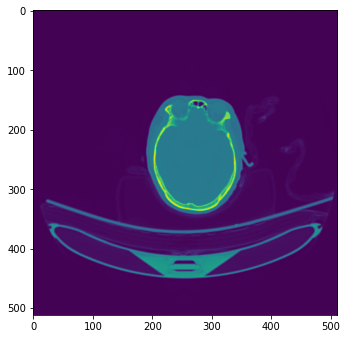

Test:  44%|████▎     | 252/578 [01:45<02:12,  2.45it/s]2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00023.dcm
2588.6995 4.8097386 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00023.dcm
2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00023.dcm


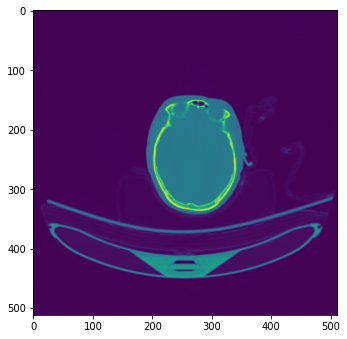

Test:  44%|████▍     | 253/578 [01:45<02:03,  2.62it/s]2643.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00024.dcm
2610.2083 5.2515254 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00024.dcm
2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00024.dcm


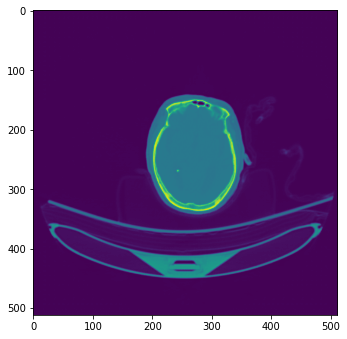

Test:  44%|████▍     | 254/578 [01:46<02:09,  2.49it/s]2623.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00025.dcm
2627.1145 4.076153 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00025.dcm
2625.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00025.dcm


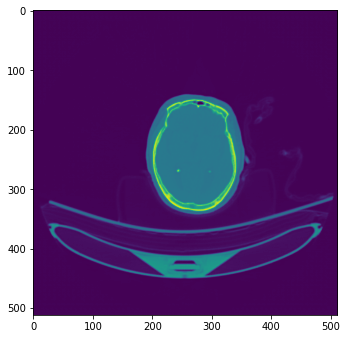

Test:  44%|████▍     | 255/578 [01:46<02:06,  2.56it/s]2598.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00026.dcm
2630.8064 5.9882836 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00026.dcm
2595.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00026.dcm


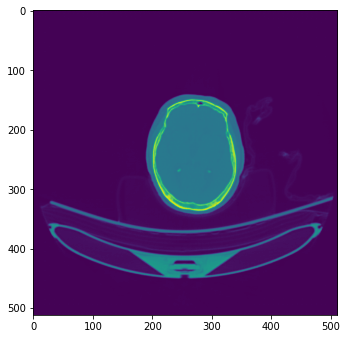

Test:  44%|████▍     | 256/578 [01:47<02:11,  2.45it/s]2588.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00027.dcm
2620.1375 5.8485475 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00027.dcm
2590.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100733_00027.dcm


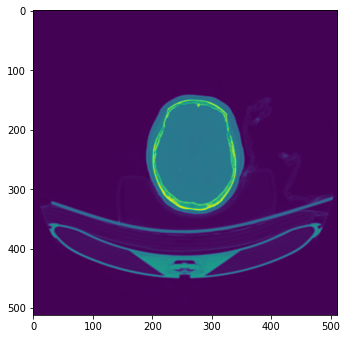

Test:  44%|████▍     | 257/578 [01:47<02:16,  2.36it/s]2603.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00028.dcm
2601.4368 6.2163773 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00028.dcm
2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00028.dcm


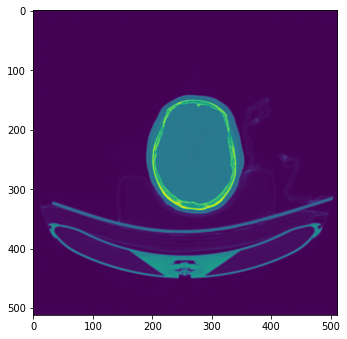

Test:  45%|████▍     | 258/578 [01:48<02:19,  2.30it/s]2616.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00029.dcm
2605.8005 6.285208 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00029.dcm
2621.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00029.dcm


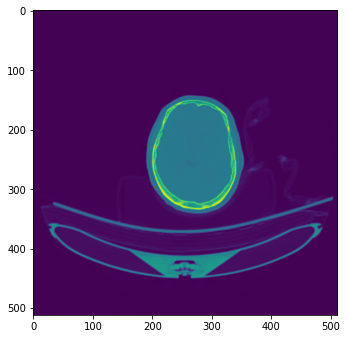

Test:  45%|████▍     | 259/578 [01:48<02:16,  2.34it/s]2607.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00030.dcm
2637.688 6.1197214 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00030.dcm
2601.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00030.dcm


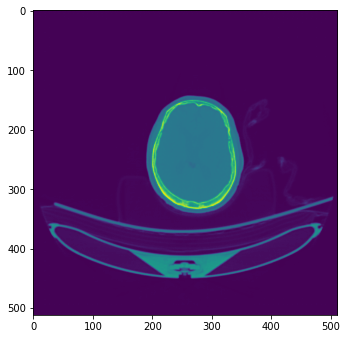

Test:  45%|████▍     | 260/578 [01:48<02:11,  2.41it/s]2574.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00031.dcm
2617.1816 5.798267 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00031.dcm
2572.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00031.dcm


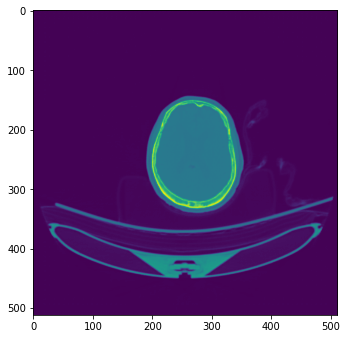

Test:  45%|████▌     | 261/578 [01:49<02:10,  2.43it/s]2591.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00032.dcm
2600.1023 5.9517937 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00032.dcm
2593.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00032.dcm


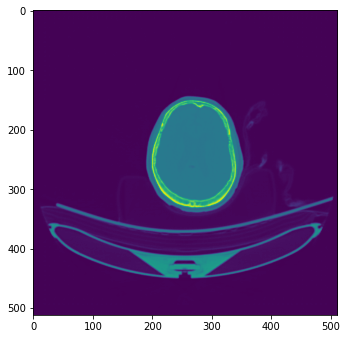

Test:  45%|████▌     | 262/578 [01:49<02:11,  2.41it/s]2586.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00033.dcm
2581.906 5.6746397 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00033.dcm
2587.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00033.dcm


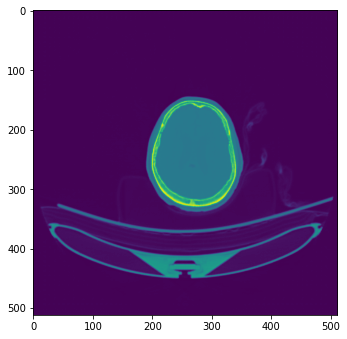

Test:  46%|████▌     | 263/578 [01:50<02:10,  2.42it/s]2568.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00034.dcm
2542.6096 5.3129115 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00034.dcm
2569.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00034.dcm


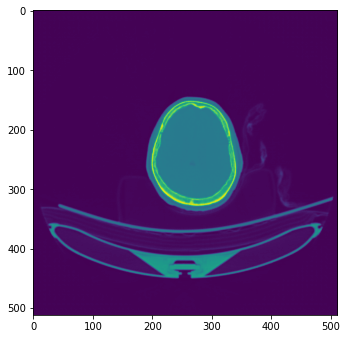

Test:  46%|████▌     | 264/578 [01:50<02:03,  2.53it/s]2572.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00035.dcm
2542.7883 5.4552107 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00035.dcm
2567.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00035.dcm


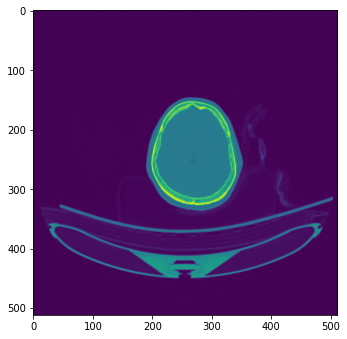

Test:  46%|████▌     | 265/578 [01:50<01:59,  2.62it/s]2575.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00036.dcm
2641.72 4.7324867 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00036.dcm
2569.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00036.dcm


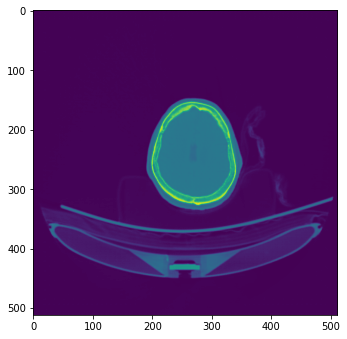

Test:  46%|████▌     | 266/578 [01:51<01:57,  2.65it/s]2601.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00037.dcm
2624.6384 7.0534534 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00037.dcm
2602.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00037.dcm


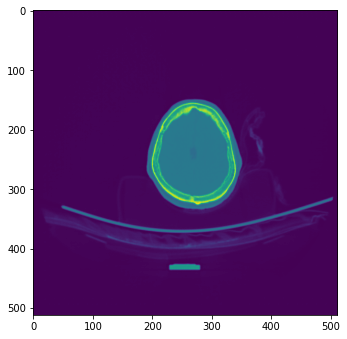

Test:  46%|████▌     | 267/578 [01:51<01:58,  2.63it/s]2510.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00038.dcm
2560.5623 5.3345127 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00038.dcm
2508.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00038.dcm


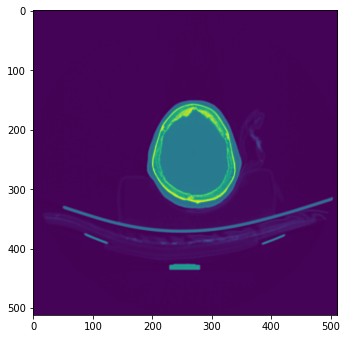

Test:  46%|████▋     | 268/578 [01:51<01:56,  2.67it/s]2528.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00039.dcm
2556.4573 5.0547957 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00039.dcm
2527.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00039.dcm


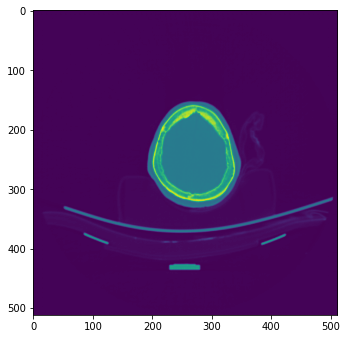

Test:  47%|████▋     | 269/578 [01:52<01:57,  2.64it/s]2516.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00040.dcm
2509.094 6.115206 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00040.dcm
2511.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00040.dcm


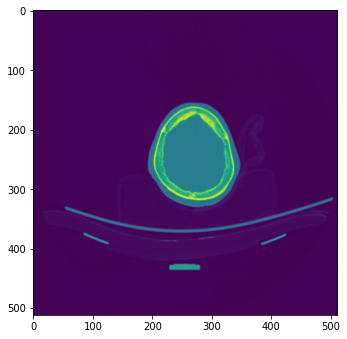

Test:  47%|████▋     | 270/578 [01:52<02:01,  2.53it/s]2499.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00041.dcm
2510.9263 5.3677077 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00041.dcm
2496.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00041.dcm


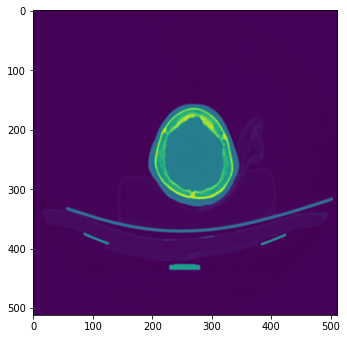

Test:  47%|████▋     | 271/578 [01:53<02:03,  2.49it/s]2512.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00042.dcm
2515.9285 4.926043 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00042.dcm
2514.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00042.dcm


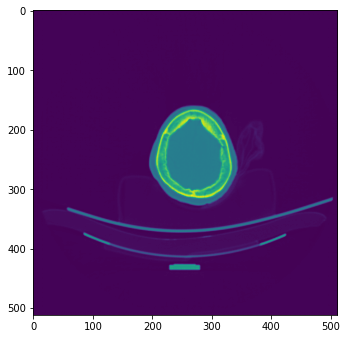

Test:  47%|████▋     | 272/578 [01:53<02:20,  2.17it/s]2530.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00043.dcm
2522.9338 4.325848 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00043.dcm
2527.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00043.dcm


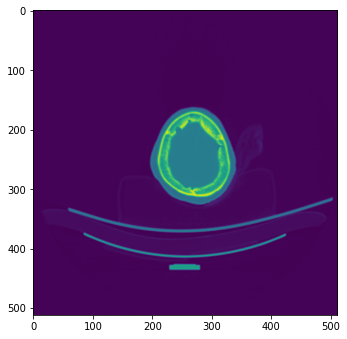

Test:  47%|████▋     | 273/578 [01:54<02:15,  2.25it/s]2522.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00044.dcm
2513.1797 3.955821 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00044.dcm
2526.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00044.dcm


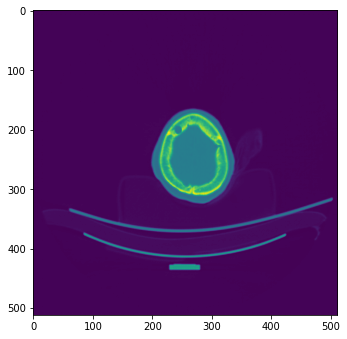

Test:  47%|████▋     | 274/578 [01:54<02:11,  2.30it/s]2527.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00045.dcm
2522.0156 4.06639 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00045.dcm
2523.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00045.dcm


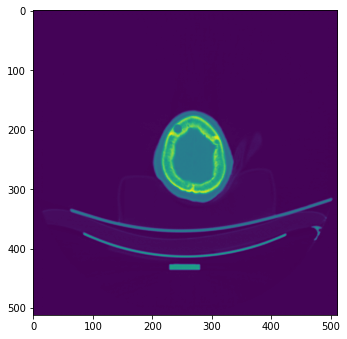

Test:  48%|████▊     | 275/578 [01:54<02:05,  2.41it/s]2543.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00046.dcm
2582.9956 4.259336 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00046.dcm
2536.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00046.dcm


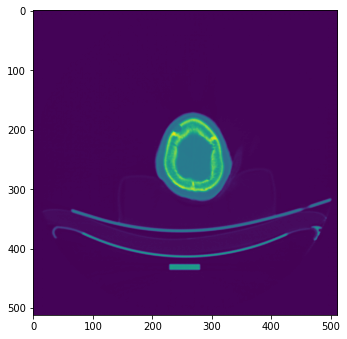

Test:  48%|████▊     | 276/578 [01:55<02:04,  2.42it/s]2497.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00047.dcm
2556.4866 3.8520865 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00047.dcm
2494.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00047.dcm


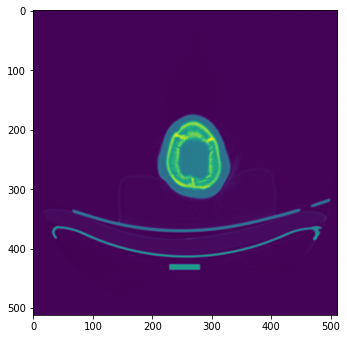

Test:  48%|████▊     | 277/578 [01:55<02:01,  2.47it/s]2525.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00048.dcm
2510.2258 3.76617 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00048.dcm
2523.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00048.dcm


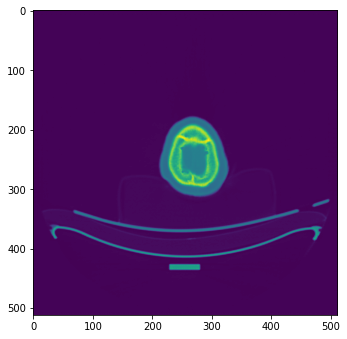

Test:  48%|████▊     | 278/578 [01:56<02:00,  2.50it/s]2491.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00049.dcm
2506.9746 3.3195019 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00049.dcm
2487.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00049.dcm


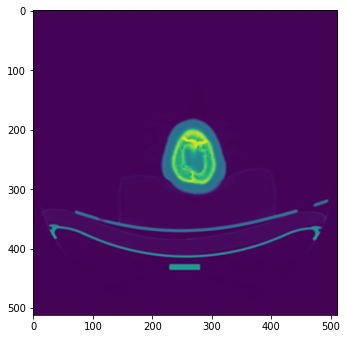

Test:  48%|████▊     | 279/578 [01:56<01:56,  2.56it/s]2491.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00050.dcm
2549.6 3.3744202 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00050.dcm
2489.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00050.dcm


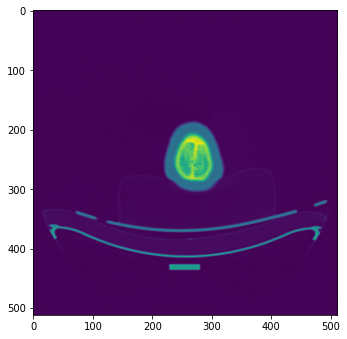

Test:  48%|████▊     | 280/578 [01:56<01:54,  2.59it/s]2489.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00051.dcm
2560.3176 3.2223577 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00051.dcm
2491.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00051.dcm


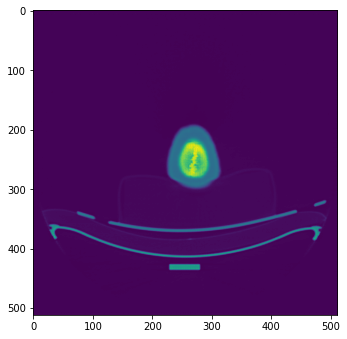

Test:  49%|████▊     | 281/578 [01:57<01:58,  2.51it/s]2417.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00052.dcm
2472.8577 3.195875 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00052.dcm
2416.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00052.dcm


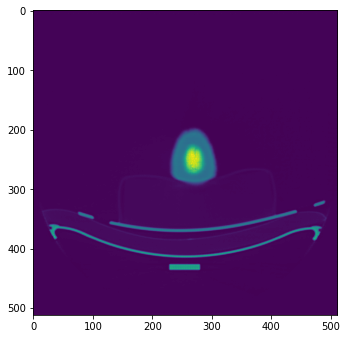

Test:  49%|████▉     | 282/578 [01:57<01:56,  2.53it/s]1717.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00053.dcm
1697.7617 2.6311934 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00053.dcm
1715.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00053.dcm


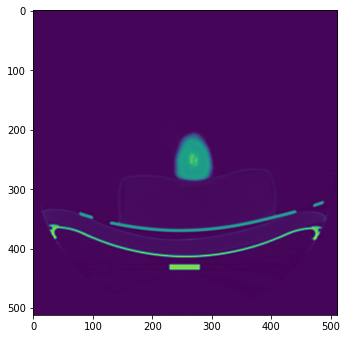

Test:  49%|████▉     | 283/578 [01:58<01:55,  2.55it/s]1728.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00054.dcm
1710.1826 2.6519403 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00054.dcm
1727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00054.dcm


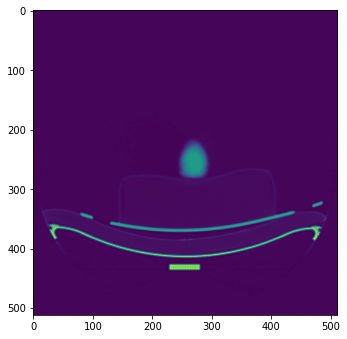

Test:  49%|████▉     | 284/578 [01:58<01:57,  2.51it/s]1721.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/gt_low_CHA_JOO_HYE_M80_001_20201118_112447_00055.dcm
1718.473 2.7853305 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_HYE_M80/pred_high_CHA_JOO_HYE_M80_001_20201118_112447_00055.dcm
1728.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_HYE_M80/gt_high_CHA_JOO_HYE_M80_001_20201118_100734_00055.dcm


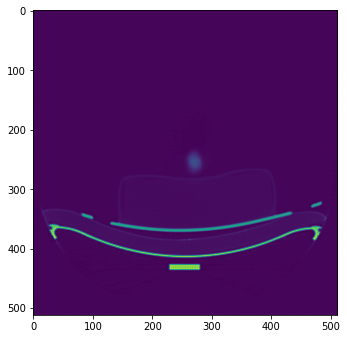

Test:  49%|████▉     | 285/578 [01:58<01:53,  2.58it/s]1717.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00001.dcm
1718.0863 2.6986818 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00001.dcm
1723.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00001.dcm


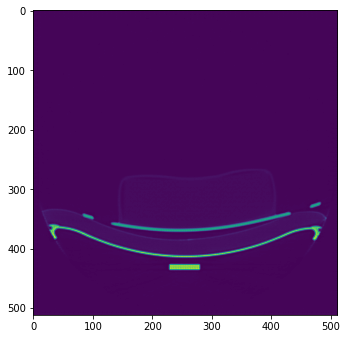

Test:  49%|████▉     | 286/578 [01:59<01:57,  2.48it/s]1729.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00002.dcm
1724.5239 2.8627043 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00002.dcm
1728.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00002.dcm


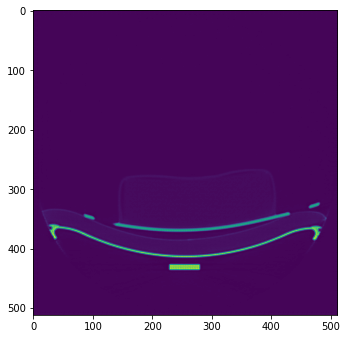

Test:  50%|████▉     | 287/578 [01:59<01:53,  2.56it/s]2970.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00003.dcm
2883.7544 3.1709785 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00003.dcm
2967.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00003.dcm


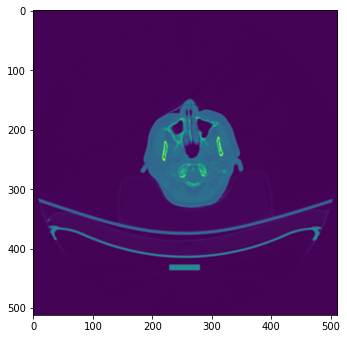

Test:  50%|████▉     | 288/578 [01:59<01:50,  2.63it/s]2913.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00004.dcm
2870.6597 3.2405417 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00004.dcm
2911.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00004.dcm


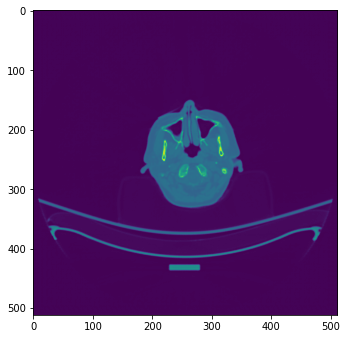

Test:  50%|█████     | 289/578 [02:00<01:46,  2.70it/s]2879.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00005.dcm
2796.1697 3.247498 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00005.dcm
2875.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00005.dcm


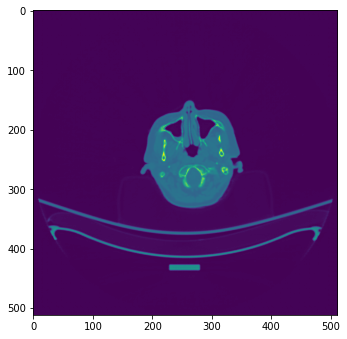

Test:  50%|█████     | 290/578 [02:00<01:56,  2.48it/s]2793.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00006.dcm
2719.0452 3.6320477 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00006.dcm
2794.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00006.dcm


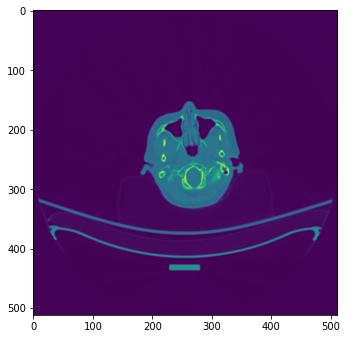

Test:  50%|█████     | 291/578 [02:01<01:53,  2.52it/s]2771.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00007.dcm
2723.3633 3.8346348 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00007.dcm
2769.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00007.dcm


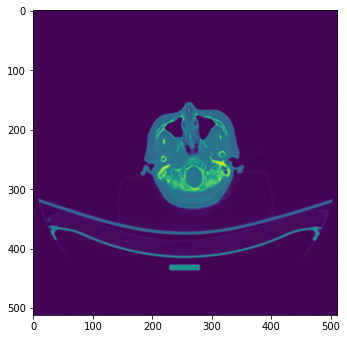

Test:  51%|█████     | 292/578 [02:01<01:57,  2.44it/s]2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00008.dcm
2687.6973 3.5652914 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00008.dcm
2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00008.dcm


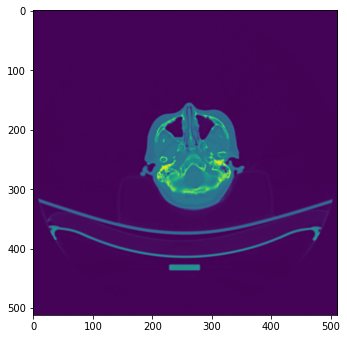

Test:  51%|█████     | 293/578 [02:02<01:55,  2.47it/s]2779.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00009.dcm
2767.7468 3.6487672 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00009.dcm
2779.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00009.dcm


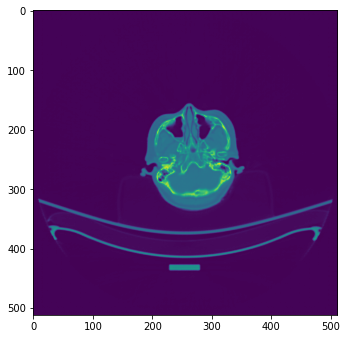

Test:  51%|█████     | 294/578 [02:02<01:59,  2.38it/s]2795.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00010.dcm
2806.3674 3.7669024 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00010.dcm
2798.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00010.dcm


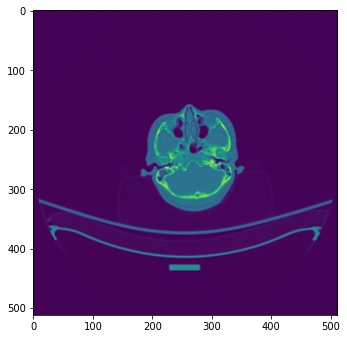

Test:  51%|█████     | 295/578 [02:02<01:58,  2.38it/s]2941.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00011.dcm
2860.8137 3.913839 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00011.dcm
2950.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00011.dcm


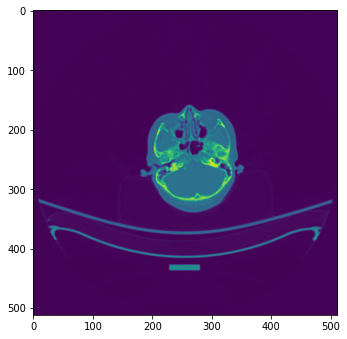

Test:  51%|█████     | 296/578 [02:03<01:59,  2.36it/s]2937.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00012.dcm
2942.022 4.0751767 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00012.dcm
2948.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00012.dcm


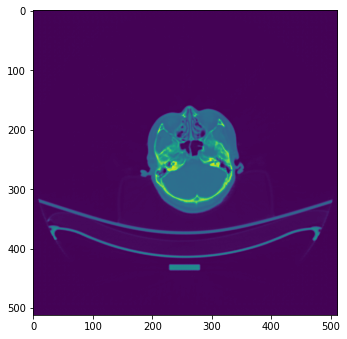

Test:  51%|█████▏    | 297/578 [02:03<01:57,  2.39it/s]2972.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00013.dcm
2921.503 3.8544054 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00013.dcm
2965.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00013.dcm


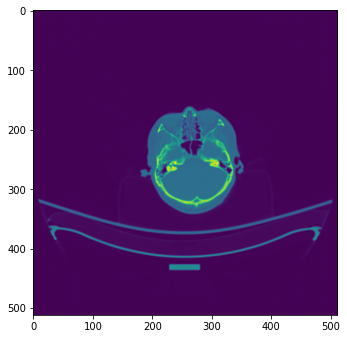

Test:  52%|█████▏    | 298/578 [02:04<01:55,  2.42it/s]2895.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00014.dcm
2967.482 3.913107 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00014.dcm
2903.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00014.dcm


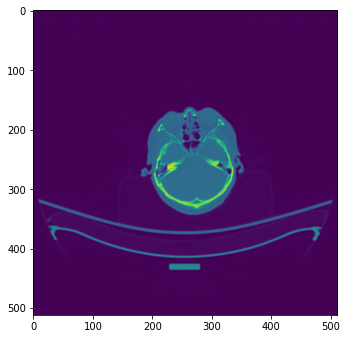

Test:  52%|█████▏    | 299/578 [02:04<01:58,  2.35it/s]2738.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00015.dcm
2749.4949 3.925555 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00015.dcm
2742.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00015.dcm


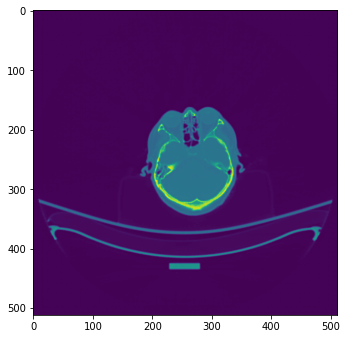

Test:  52%|█████▏    | 300/578 [02:04<01:55,  2.41it/s]2781.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00016.dcm
2730.9346 3.6941662 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00016.dcm
2780.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00016.dcm


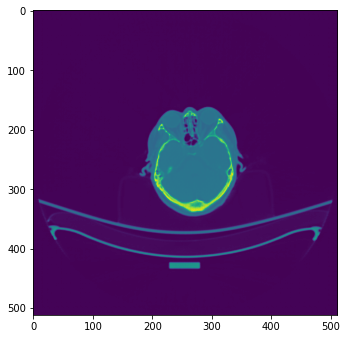

Test:  52%|█████▏    | 301/578 [02:05<01:58,  2.34it/s]2745.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00017.dcm
2708.7676 3.7258968 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00017.dcm
2746.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00017.dcm


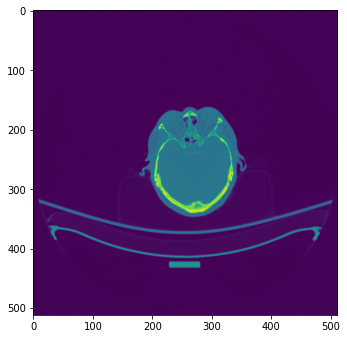

Test:  52%|█████▏    | 302/578 [02:05<01:53,  2.42it/s]2695.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00018.dcm
2740.5762 3.96473 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00018.dcm
2699.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00018.dcm


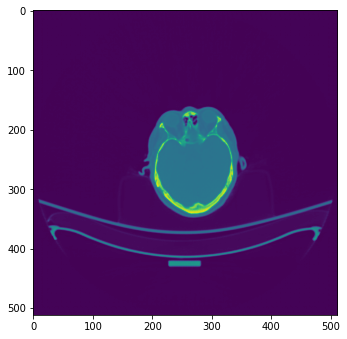

Test:  52%|█████▏    | 303/578 [02:06<01:52,  2.44it/s]2706.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00019.dcm
2707.0325 4.325604 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00019.dcm
2703.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00019.dcm


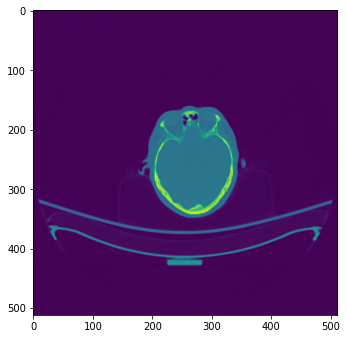

Test:  53%|█████▎    | 304/578 [02:06<01:56,  2.35it/s]2688.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00020.dcm
2685.4343 5.4328775 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00020.dcm
2689.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00020.dcm


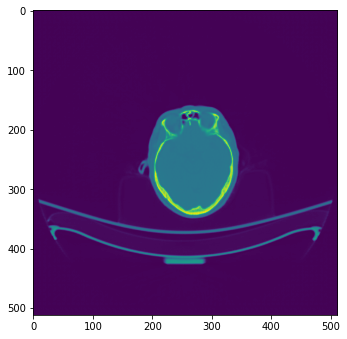

Test:  53%|█████▎    | 305/578 [02:07<02:00,  2.26it/s]2654.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00021.dcm
2690.495 5.272028 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00021.dcm
2664.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00021.dcm


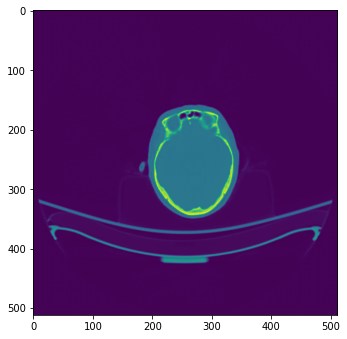

Test:  53%|█████▎    | 306/578 [02:07<01:59,  2.28it/s]2671.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00022.dcm
2704.9487 6.1105685 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00022.dcm
2666.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00022.dcm


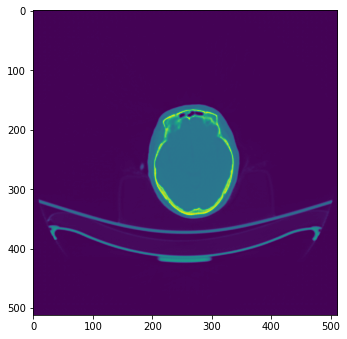

Test:  53%|█████▎    | 307/578 [02:08<02:00,  2.25it/s]2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00023.dcm
2702.3909 5.835977 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00023.dcm
2676.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00023.dcm


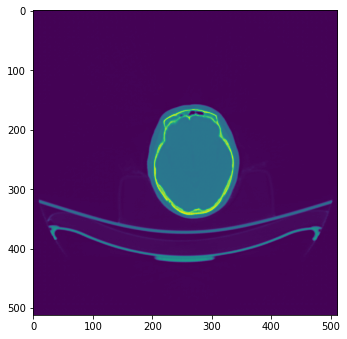

Test:  53%|█████▎    | 308/578 [02:08<02:07,  2.12it/s]2687.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00024.dcm
2678.6516 4.0025625 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00024.dcm
2690.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00024.dcm


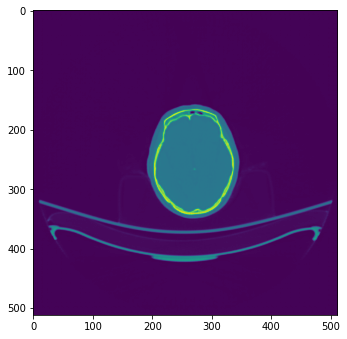

Test:  53%|█████▎    | 309/578 [02:09<02:05,  2.15it/s]2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00025.dcm
2701.9287 3.1001952 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00025.dcm
2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00025.dcm


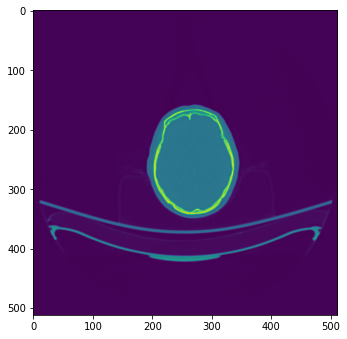

Test:  54%|█████▎    | 310/578 [02:09<02:04,  2.16it/s]2620.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00026.dcm
2639.0234 3.5219672 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00026.dcm
2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00026.dcm


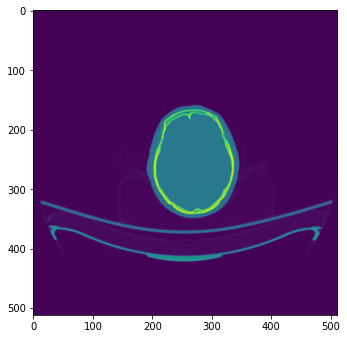

Test:  54%|█████▍    | 311/578 [02:09<02:01,  2.20it/s]2625.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00027.dcm
2619.4038 3.4924333 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00027.dcm
2621.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00027.dcm


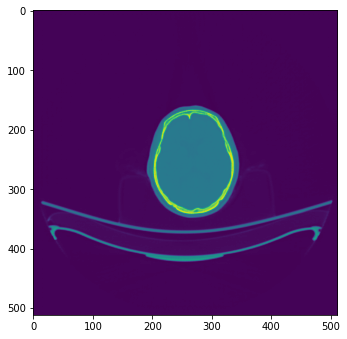

Test:  54%|█████▍    | 312/578 [02:10<02:06,  2.10it/s]2615.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00028.dcm
2631.3472 3.232121 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00028.dcm
2608.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00028.dcm


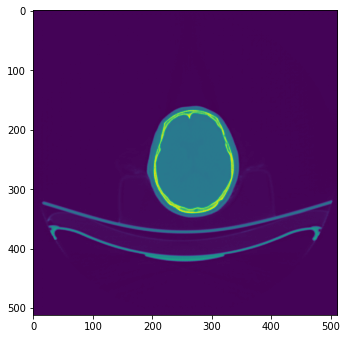

Test:  54%|█████▍    | 313/578 [02:10<01:57,  2.25it/s]2656.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00029.dcm
2588.5283 3.295704 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00029.dcm
2657.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00029.dcm


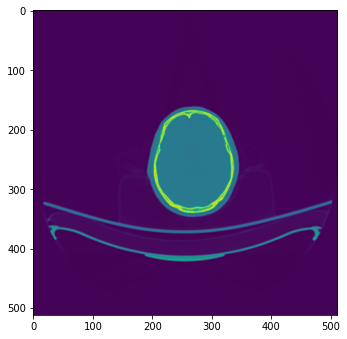

Test:  54%|█████▍    | 314/578 [02:11<01:54,  2.31it/s]2672.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00030.dcm
2629.9524 3.3275566 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00030.dcm
2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00030.dcm


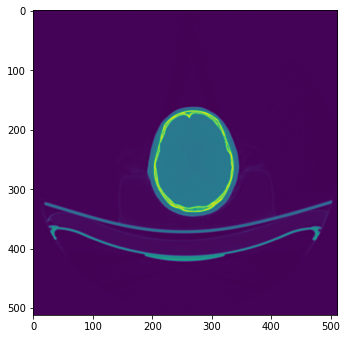

Test:  54%|█████▍    | 315/578 [02:11<01:52,  2.35it/s]2670.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00031.dcm
2629.4185 3.298267 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00031.dcm
2670.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00031.dcm


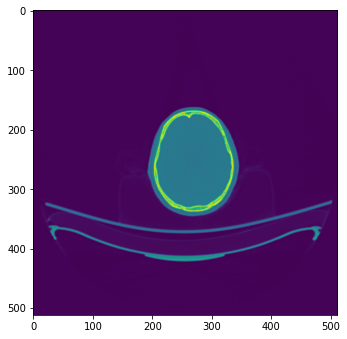

Test:  55%|█████▍    | 316/578 [02:12<01:51,  2.35it/s]2649.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00032.dcm
2652.048 3.2554307 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00032.dcm
2652.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00032.dcm


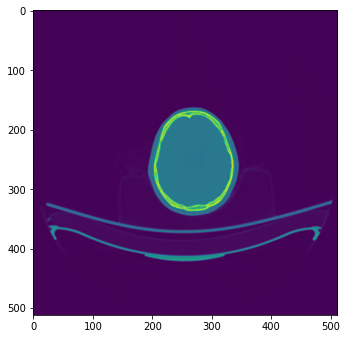

Test:  55%|█████▍    | 317/578 [02:12<01:53,  2.29it/s]2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00033.dcm
2591.8003 3.2860627 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00033.dcm
2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00033.dcm


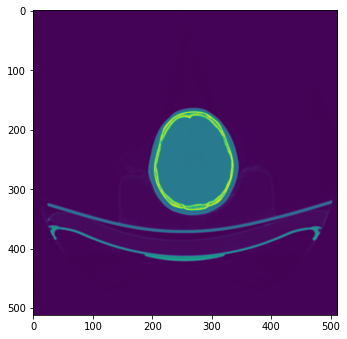

Test:  55%|█████▌    | 318/578 [02:12<01:49,  2.38it/s]2587.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00034.dcm
2581.179 3.2239442 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00034.dcm
2591.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00034.dcm


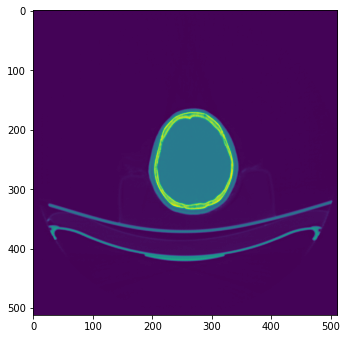

Test:  55%|█████▌    | 319/578 [02:13<01:48,  2.40it/s]2563.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00035.dcm
2539.5002 3.1244812 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00035.dcm
2560.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00035.dcm


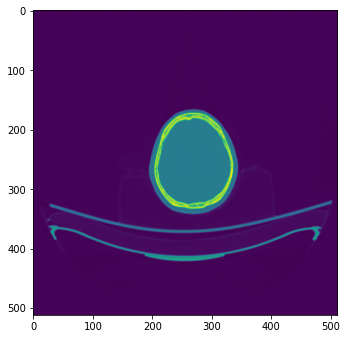

Test:  55%|█████▌    | 320/578 [02:13<01:42,  2.52it/s]2577.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00036.dcm
2530.836 3.073224 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00036.dcm
2574.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00036.dcm


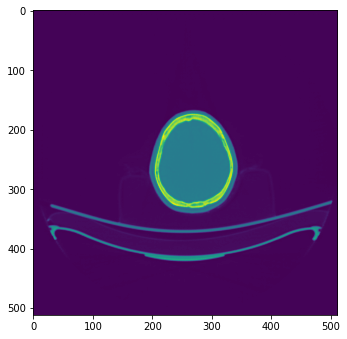

Test:  56%|█████▌    | 321/578 [02:14<01:38,  2.62it/s]2573.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00037.dcm
2571.5083 3.1375394 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00037.dcm
2574.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00037.dcm


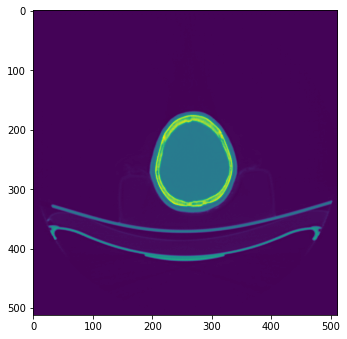

Test:  56%|█████▌    | 322/578 [02:14<01:35,  2.69it/s]2559.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00038.dcm
2556.3 3.0831094 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00038.dcm
2554.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00038.dcm


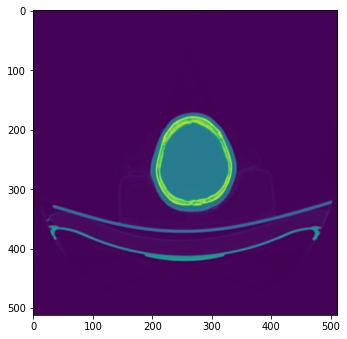

Test:  56%|█████▌    | 323/578 [02:14<01:35,  2.66it/s]2512.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00039.dcm
2489.9875 2.970832 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00039.dcm
2513.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00039.dcm


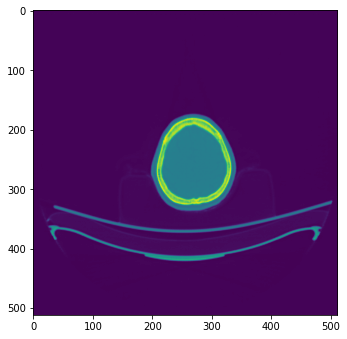

Test:  56%|█████▌    | 324/578 [02:15<01:41,  2.49it/s]2539.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00040.dcm
2549.3838 2.9527702 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00040.dcm
2535.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00040.dcm


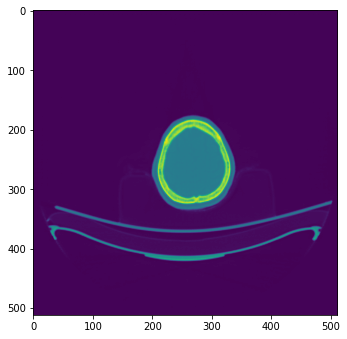

Test:  56%|█████▌    | 325/578 [02:15<01:42,  2.46it/s]2535.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00041.dcm
2532.4524 2.9591162 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00041.dcm
2536.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00041.dcm


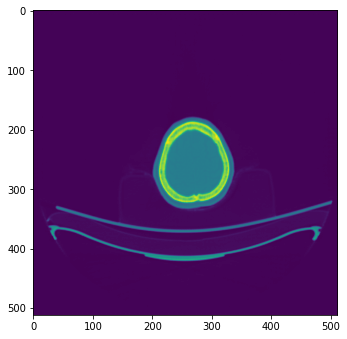

Test:  56%|█████▋    | 326/578 [02:16<01:50,  2.27it/s]2526.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00042.dcm
2542.9858 2.8573344 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00042.dcm
2529.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00042.dcm


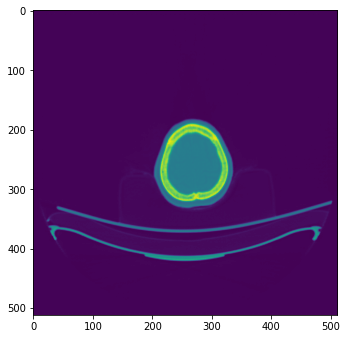

Test:  57%|█████▋    | 327/578 [02:16<01:44,  2.40it/s]2555.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00043.dcm
2563.7444 2.7388332 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00043.dcm
2559.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00043.dcm


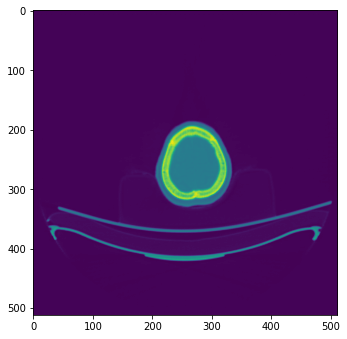

Test:  57%|█████▋    | 328/578 [02:16<01:43,  2.42it/s]2569.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00044.dcm
2605.2432 2.633268 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00044.dcm
2566.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00044.dcm


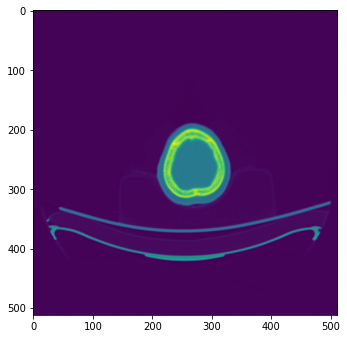

Test:  57%|█████▋    | 329/578 [02:17<01:43,  2.41it/s]2572.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00045.dcm
2577.6174 2.6078837 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00045.dcm
2567.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00045.dcm


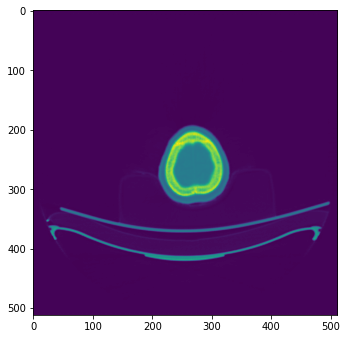

Test:  57%|█████▋    | 330/578 [02:17<01:42,  2.42it/s]2550.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00046.dcm
2565.9866 2.5256283 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00046.dcm
2547.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00046.dcm


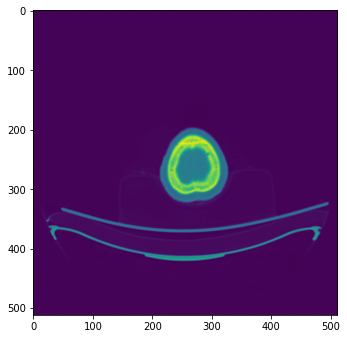

Test:  57%|█████▋    | 331/578 [02:18<01:43,  2.39it/s]2533.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00047.dcm
2579.5469 2.437027 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00047.dcm
2528.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00047.dcm


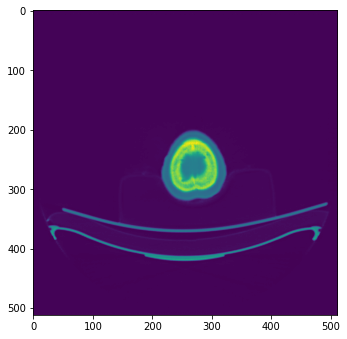

Test:  57%|█████▋    | 332/578 [02:18<01:41,  2.41it/s]2529.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130129_00048.dcm
2549.4133 2.4445934 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130129_00048.dcm
2528.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00048.dcm


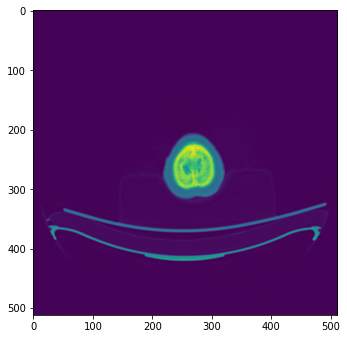

Test:  58%|█████▊    | 333/578 [02:19<01:43,  2.38it/s]2501.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00049.dcm
2560.5034 2.1563337 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00049.dcm
2498.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00049.dcm


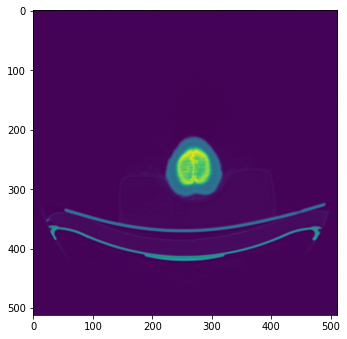

Test:  58%|█████▊    | 334/578 [02:19<01:39,  2.46it/s]2452.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00050.dcm
2501.312 2.078838 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00050.dcm
2451.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00050.dcm


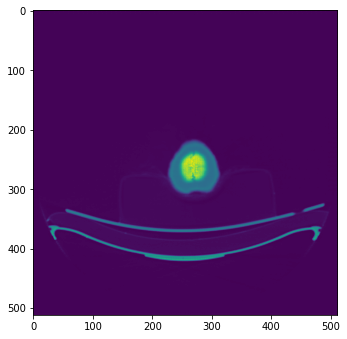

Test:  58%|█████▊    | 335/578 [02:19<01:41,  2.39it/s]1825.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00051.dcm
1944.2218 1.8902855 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00051.dcm
1828.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00051.dcm


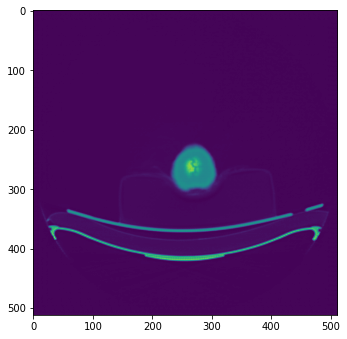

Test:  58%|█████▊    | 336/578 [02:20<01:39,  2.44it/s]1860.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00052.dcm
2003.5239 1.8058335 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00052.dcm
1864.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104751_00052.dcm


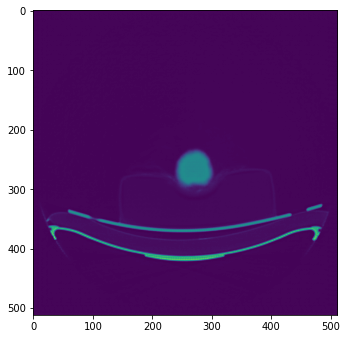

Test:  58%|█████▊    | 337/578 [02:20<01:42,  2.34it/s]1831.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00053.dcm
2023.2241 1.8761288 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00053.dcm
1835.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104752_00053.dcm


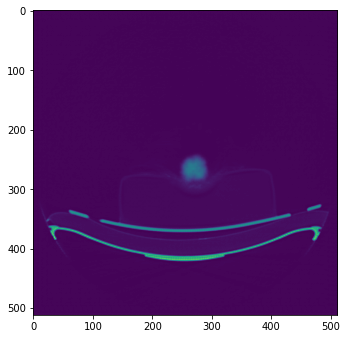

Test:  58%|█████▊    | 338/578 [02:21<01:45,  2.27it/s]1844.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00054.dcm
2038.4181 2.0349035 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00054.dcm
1839.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104752_00054.dcm


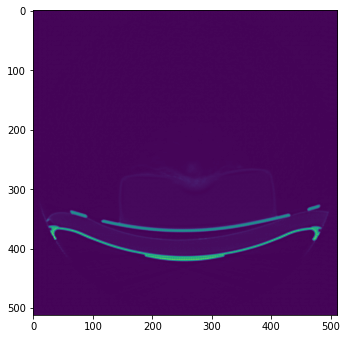

Test:  59%|█████▊    | 339/578 [02:21<01:42,  2.32it/s]1864.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00055.dcm
2016.1547 2.1415668 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00055.dcm
1865.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104752_00055.dcm


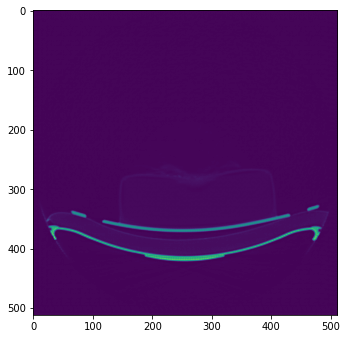

Test:  59%|█████▉    | 340/578 [02:21<01:42,  2.32it/s]1873.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/gt_low_CHA_JOO_M19_001_20201119_130130_00056.dcm
2028.1554 1.8725896 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_JOO_M19/pred_high_CHA_JOO_M19_001_20201119_130130_00056.dcm
1874.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_JOO_M19/gt_high_CHA_JOO_M19_001_20201119_104752_00056.dcm


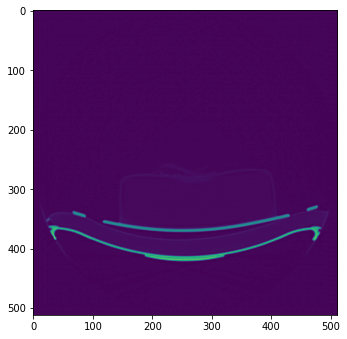

Test:  59%|█████▉    | 341/578 [02:22<01:41,  2.34it/s]2860.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00001.dcm
2849.455 2.9027336 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00001.dcm
2861.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00001.dcm


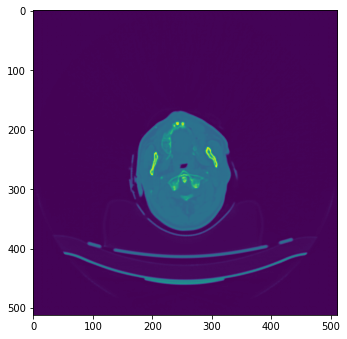

Test:  59%|█████▉    | 342/578 [02:22<01:41,  2.32it/s]2857.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00002.dcm
2810.5051 2.9389796 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00002.dcm
2848.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00002.dcm


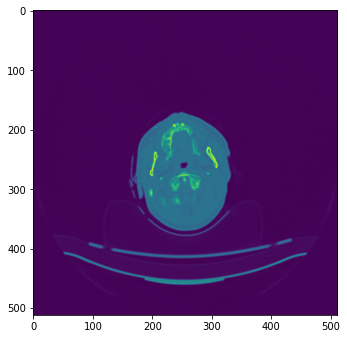

Test:  59%|█████▉    | 343/578 [02:23<01:41,  2.31it/s]2834.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00003.dcm
2826.9487 3.0472295 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00003.dcm
2829.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00003.dcm


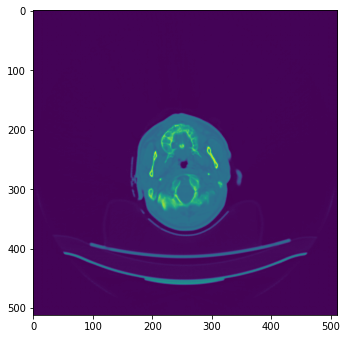

Test:  60%|█████▉    | 344/578 [02:23<01:45,  2.21it/s]2810.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00004.dcm
2803.2876 3.2409077 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00004.dcm
2816.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00004.dcm


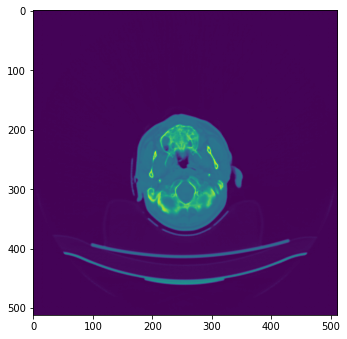

Test:  60%|█████▉    | 345/578 [02:24<01:37,  2.39it/s]2796.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00005.dcm
2797.0696 3.1592627 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00005.dcm
2793.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00005.dcm


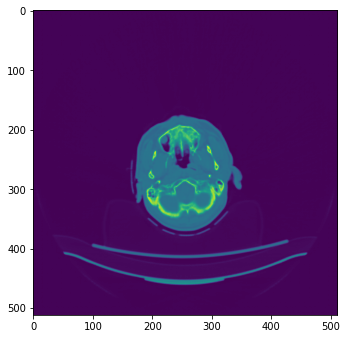

Test:  60%|█████▉    | 346/578 [02:24<01:38,  2.34it/s]2807.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00006.dcm
2756.5913 3.1649985 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00006.dcm
2804.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00006.dcm


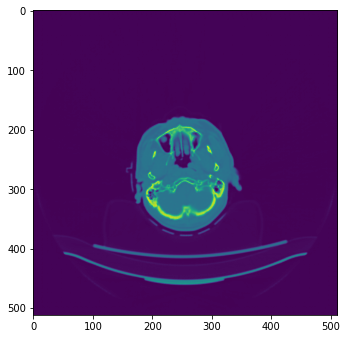

Test:  60%|██████    | 347/578 [02:24<01:35,  2.41it/s]2821.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00007.dcm
2755.2012 3.2454233 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00007.dcm
2826.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00007.dcm


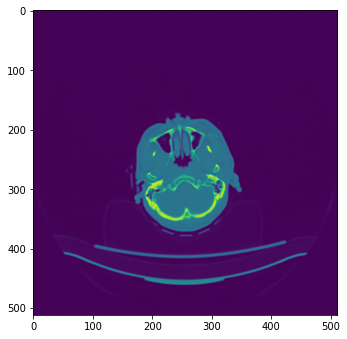

Test:  60%|██████    | 348/578 [02:25<01:37,  2.36it/s]2792.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00008.dcm
2743.98 3.3783255 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00008.dcm
2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00008.dcm


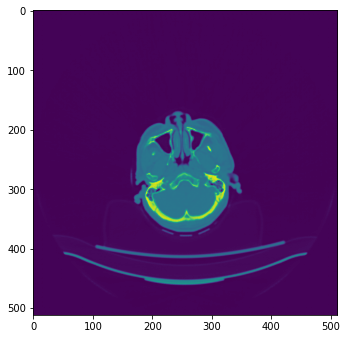

Test:  60%|██████    | 349/578 [02:25<01:37,  2.35it/s]2702.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00009.dcm
2738.079 3.3247497 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00009.dcm
2702.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00009.dcm


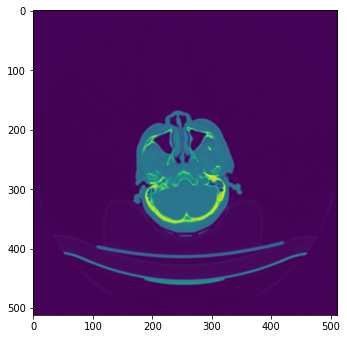

Test:  61%|██████    | 350/578 [02:26<01:36,  2.37it/s]2695.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00010.dcm
2696.7876 3.3087623 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00010.dcm
2697.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00010.dcm


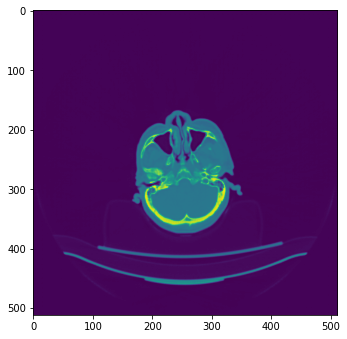

Test:  61%|██████    | 351/578 [02:26<01:37,  2.33it/s]2805.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00011.dcm
2860.1892 3.5688307 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00011.dcm
2800.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124847_00011.dcm


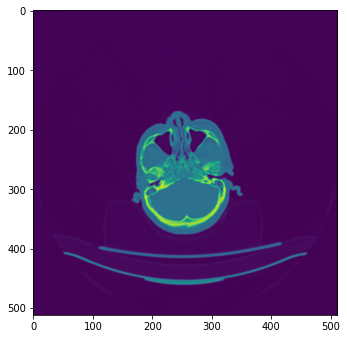

Test:  61%|██████    | 352/578 [02:27<01:35,  2.36it/s]2853.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00012.dcm
2837.1843 3.7305343 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00012.dcm
2853.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00012.dcm


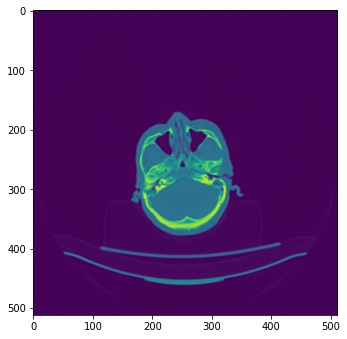

Test:  61%|██████    | 353/578 [02:27<01:35,  2.35it/s]2862.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00013.dcm
2795.0627 3.8278005 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00013.dcm
2867.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00013.dcm


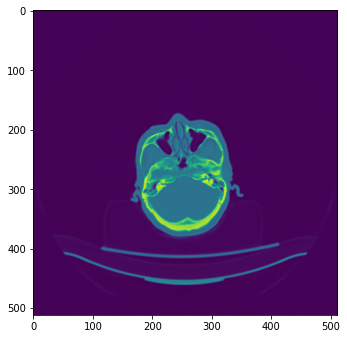

Test:  61%|██████    | 354/578 [02:28<01:38,  2.27it/s]2800.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00014.dcm
2803.8918 3.934586 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00014.dcm
2799.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00014.dcm


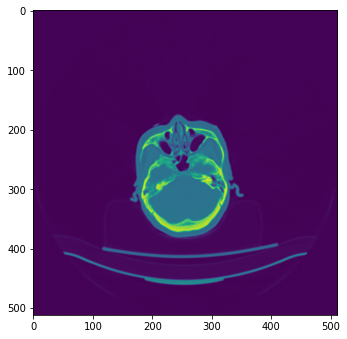

Test:  61%|██████▏   | 355/578 [02:28<01:35,  2.34it/s]2730.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00015.dcm
2729.0469 4.3370757 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00015.dcm
2724.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00015.dcm


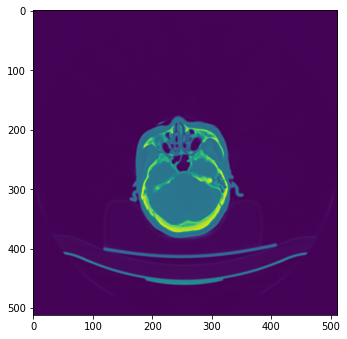

Test:  62%|██████▏   | 356/578 [02:28<01:36,  2.30it/s]2715.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141231_00016.dcm
2802.6338 4.2575054 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141231_00016.dcm
2719.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00016.dcm


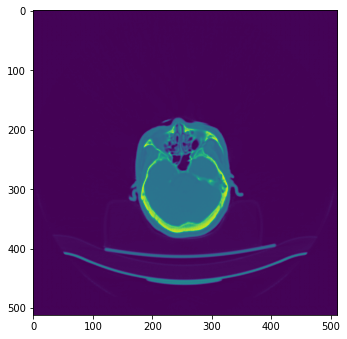

Test:  62%|██████▏   | 357/578 [02:29<01:41,  2.19it/s]2745.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00017.dcm
2760.9905 3.9660726 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00017.dcm
2742.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00017.dcm


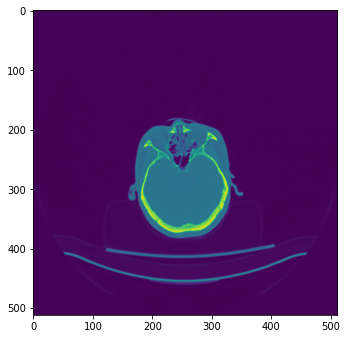

Test:  62%|██████▏   | 358/578 [02:30<01:53,  1.94it/s]2795.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00018.dcm
2783.7288 3.9665606 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00018.dcm
2792.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00018.dcm


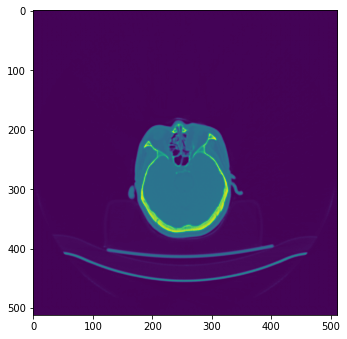

Test:  62%|██████▏   | 359/578 [02:30<01:45,  2.07it/s]2803.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00019.dcm
2802.309 3.419087 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00019.dcm
2801.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00019.dcm


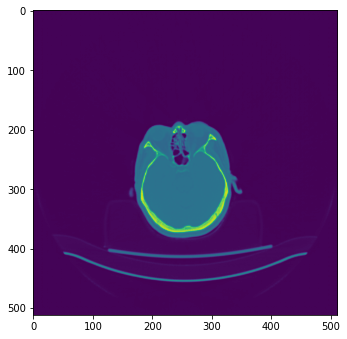

Test:  62%|██████▏   | 360/578 [02:30<01:39,  2.20it/s]2740.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00020.dcm
2707.2786 3.54845 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00020.dcm
2737.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00020.dcm


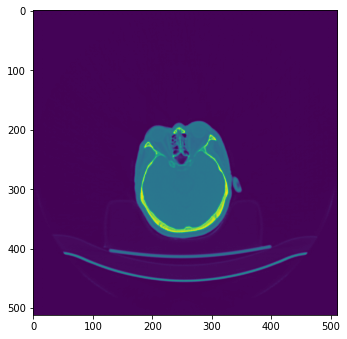

Test:  62%|██████▏   | 361/578 [02:31<01:33,  2.31it/s]2710.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00021.dcm
2675.117 3.6707344 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00021.dcm
2709.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00021.dcm


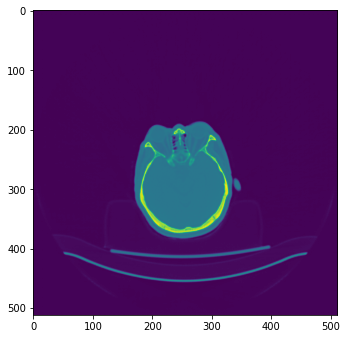

Test:  63%|██████▎   | 362/578 [02:31<01:34,  2.27it/s]2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00022.dcm
2691.8887 3.9294603 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00022.dcm
2658.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00022.dcm


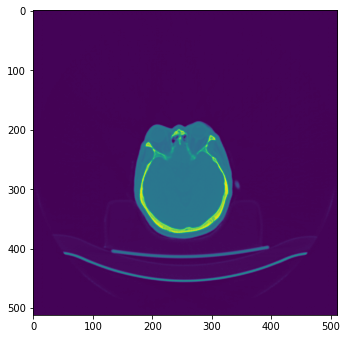

Test:  63%|██████▎   | 363/578 [02:32<01:33,  2.29it/s]2664.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00023.dcm
2733.0483 3.847449 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00023.dcm
2666.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00023.dcm


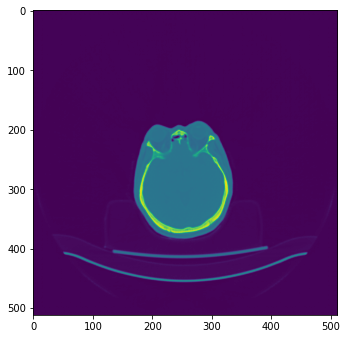

Test:  63%|██████▎   | 364/578 [02:32<01:31,  2.33it/s]2659.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00024.dcm
2703.0415 3.5735903 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00024.dcm
2649.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00024.dcm


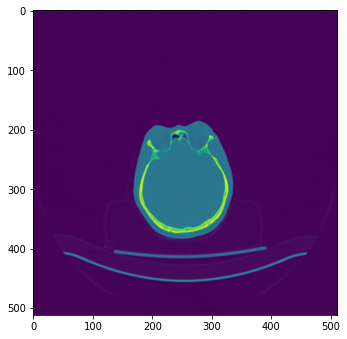

Test:  63%|██████▎   | 365/578 [02:32<01:27,  2.44it/s]2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00025.dcm
2676.047 3.6155722 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00025.dcm
2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00025.dcm


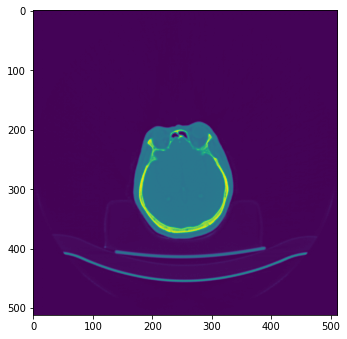

Test:  63%|██████▎   | 366/578 [02:33<01:29,  2.36it/s]2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00026.dcm
2681.7168 2.4812057 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00026.dcm
2658.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00026.dcm


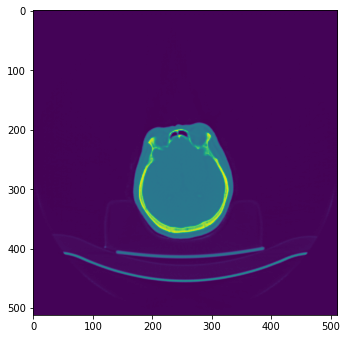

Test:  63%|██████▎   | 367/578 [02:33<01:27,  2.41it/s]2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00027.dcm
2680.799 3.5313642 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00027.dcm
2681.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00027.dcm


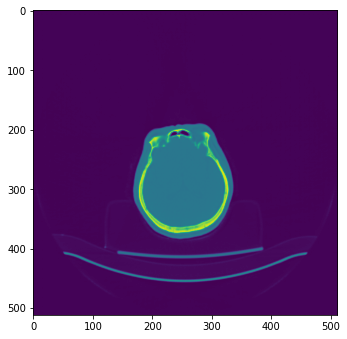

Test:  64%|██████▎   | 368/578 [02:34<01:27,  2.40it/s]2681.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00028.dcm
2717.5664 3.5986085 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00028.dcm
2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00028.dcm


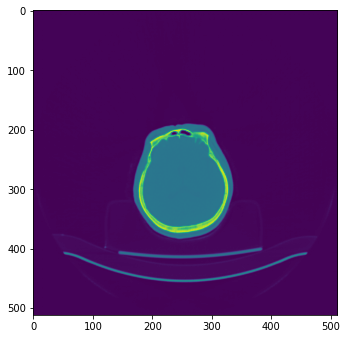

Test:  64%|██████▍   | 369/578 [02:34<01:26,  2.42it/s]2700.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00029.dcm
2714.3958 3.6639001 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00029.dcm
2709.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00029.dcm


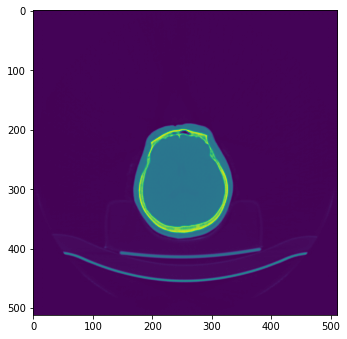

Test:  64%|██████▍   | 370/578 [02:35<01:29,  2.32it/s]2694.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00030.dcm
2710.1626 3.7428603 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00030.dcm
2694.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00030.dcm


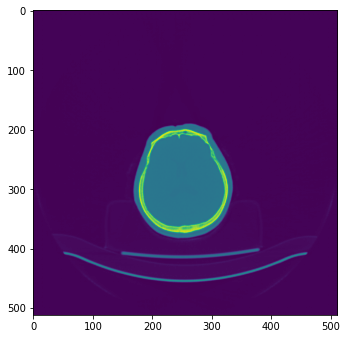

Test:  64%|██████▍   | 371/578 [02:35<01:29,  2.32it/s]2745.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00031.dcm
2721.332 3.555284 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00031.dcm
2740.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00031.dcm


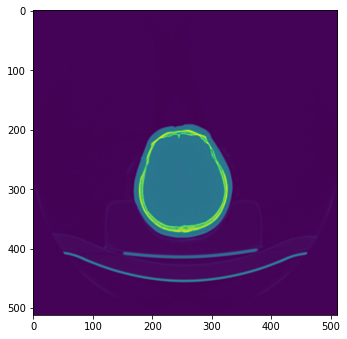

Test:  64%|██████▍   | 372/578 [02:35<01:28,  2.32it/s]2760.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00032.dcm
2704.4277 3.59092 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00032.dcm
2762.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00032.dcm


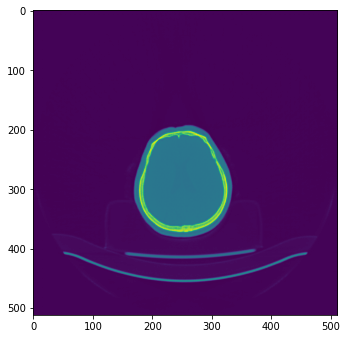

Test:  65%|██████▍   | 373/578 [02:36<01:29,  2.30it/s]2782.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00033.dcm
2771.58 3.3182814 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00033.dcm
2776.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00033.dcm


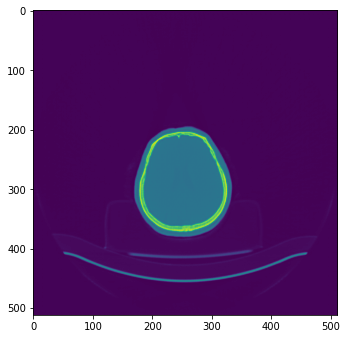

Test:  65%|██████▍   | 374/578 [02:36<01:29,  2.27it/s]2727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00034.dcm
2789.9016 3.3517206 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00034.dcm
2727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00034.dcm


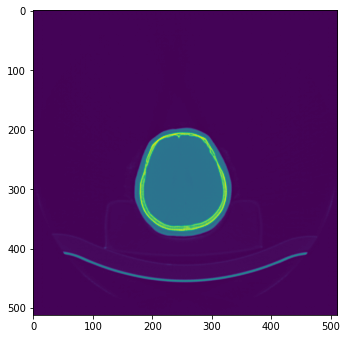

Test:  65%|██████▍   | 375/578 [02:37<01:29,  2.27it/s]2738.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00035.dcm
2774.097 3.1459603 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00035.dcm
2732.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00035.dcm


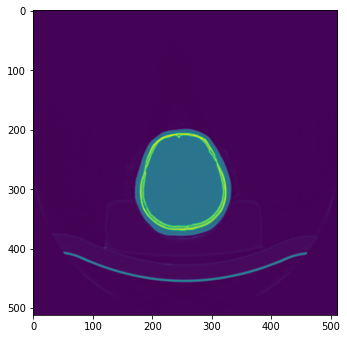

Test:  65%|██████▌   | 376/578 [02:37<01:28,  2.28it/s]2762.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00036.dcm
2783.9006 3.1258235 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00036.dcm
2762.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00036.dcm


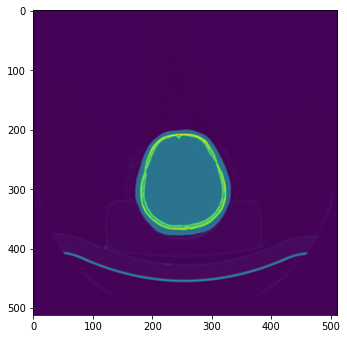

Test:  65%|██████▌   | 377/578 [02:38<01:25,  2.34it/s]2727.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00037.dcm
2706.01 3.0865266 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00037.dcm
2724.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00037.dcm


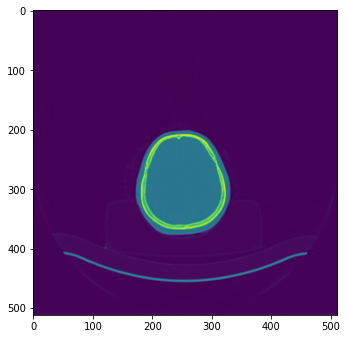

Test:  65%|██████▌   | 378/578 [02:38<01:22,  2.44it/s]2687.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00038.dcm
2630.6152 3.1861117 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00038.dcm
2684.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00038.dcm


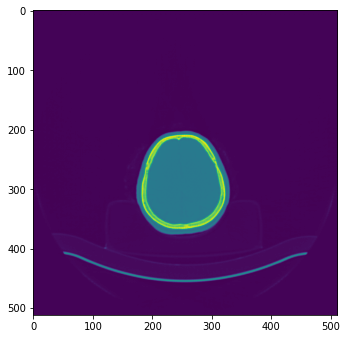

Test:  66%|██████▌   | 379/578 [02:38<01:20,  2.47it/s]2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00039.dcm
2631.6753 2.850378 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00039.dcm
2619.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00039.dcm


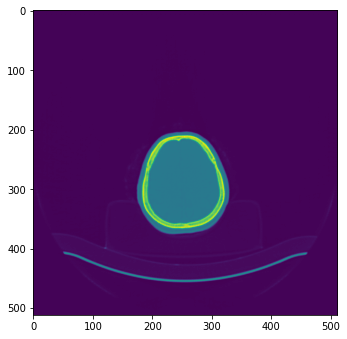

Test:  66%|██████▌   | 380/578 [02:39<01:25,  2.32it/s]2650.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00040.dcm
2617.0303 2.9259212 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00040.dcm
2650.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00040.dcm


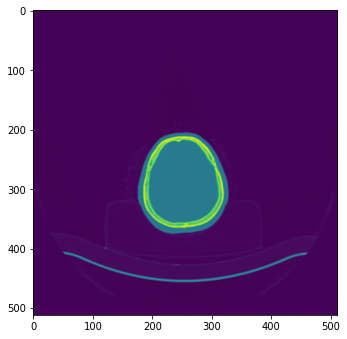

Test:  66%|██████▌   | 381/578 [02:39<01:25,  2.30it/s]2614.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00041.dcm
2586.8303 2.8568463 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00041.dcm
2615.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00041.dcm


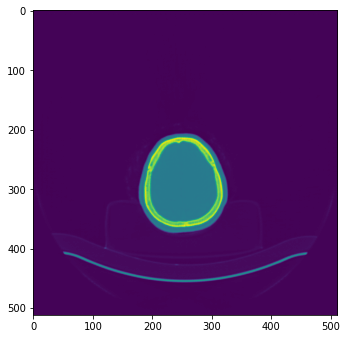

Test:  66%|██████▌   | 382/578 [02:40<01:22,  2.39it/s]2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00042.dcm
2609.053 4.2787404 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00042.dcm
2616.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00042.dcm


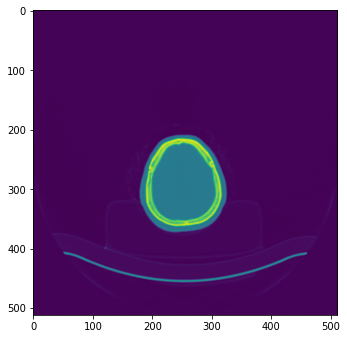

Test:  66%|██████▋   | 383/578 [02:40<01:23,  2.34it/s]2578.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00043.dcm
2599.15 6.688918 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00043.dcm
2583.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00043.dcm


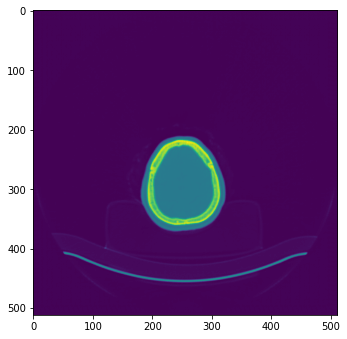

Test:  66%|██████▋   | 384/578 [02:40<01:23,  2.34it/s]2577.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00044.dcm
2590.6218 6.115938 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00044.dcm
2585.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00044.dcm


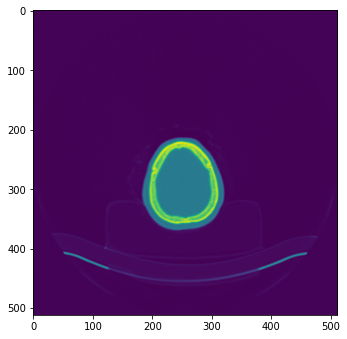

Test:  67%|██████▋   | 385/578 [02:41<01:21,  2.37it/s]2544.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00045.dcm
2566.4087 5.7767878 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00045.dcm
2546.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00045.dcm


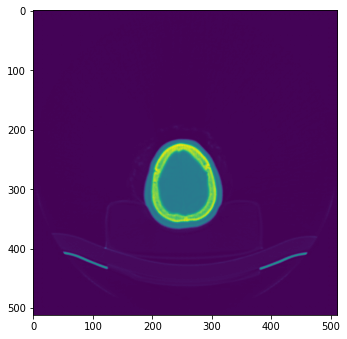

Test:  67%|██████▋   | 386/578 [02:41<01:23,  2.31it/s]2544.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00046.dcm
2546.2417 5.594581 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00046.dcm
2543.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00046.dcm


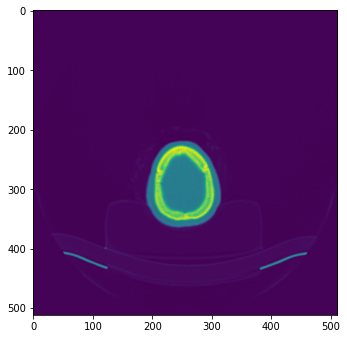

Test:  67%|██████▋   | 387/578 [02:42<01:22,  2.31it/s]2558.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00047.dcm
2574.884 5.4265313 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00047.dcm
2560.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00047.dcm


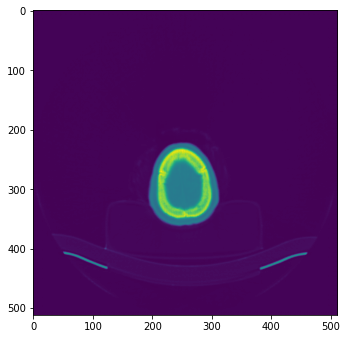

Test:  67%|██████▋   | 388/578 [02:42<01:20,  2.36it/s]2581.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00048.dcm
2608.8735 5.335001 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00048.dcm
2575.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00048.dcm


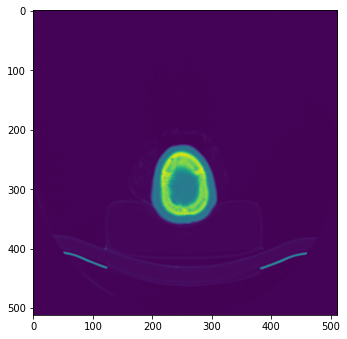

Test:  67%|██████▋   | 389/578 [02:43<01:21,  2.33it/s]2536.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00049.dcm
2582.5208 4.8485475 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00049.dcm
2534.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00049.dcm


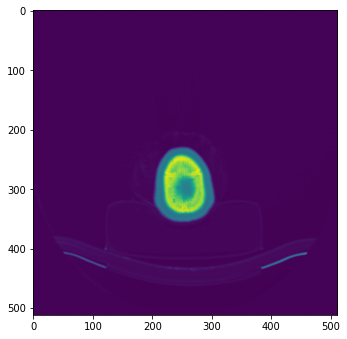

Test:  67%|██████▋   | 390/578 [02:43<01:23,  2.25it/s]2564.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00050.dcm
2614.2031 4.329387 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00050.dcm
2561.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00050.dcm


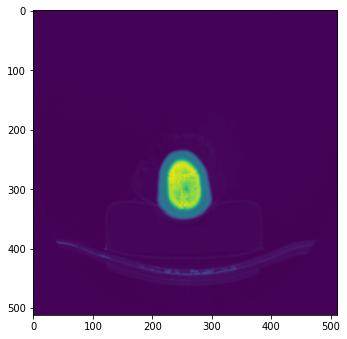

Test:  68%|██████▊   | 391/578 [02:44<01:21,  2.31it/s]2588.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00051.dcm
2713.944 3.130705 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00051.dcm
2589.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00051.dcm


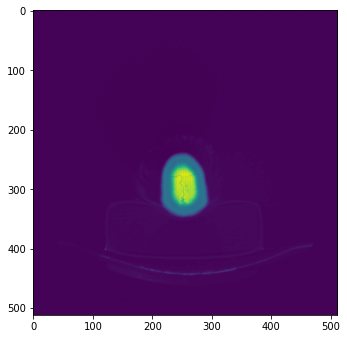

Test:  68%|██████▊   | 392/578 [02:44<01:19,  2.35it/s]2106.0 7.9999995 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00052.dcm
2170.8594 1.5397851 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00052.dcm
2105.0 9.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00052.dcm


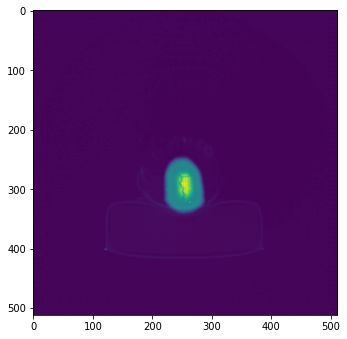

Test:  68%|██████▊   | 393/578 [02:44<01:15,  2.45it/s]1196.0 9.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00053.dcm
1181.4482 0.8047351 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00053.dcm
1195.0 10.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00053.dcm


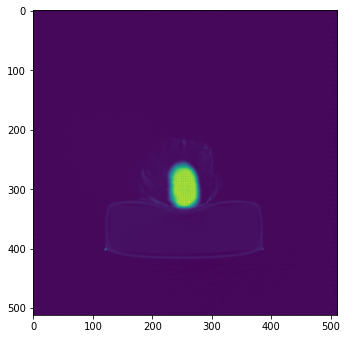

Test:  68%|██████▊   | 394/578 [02:45<01:10,  2.59it/s]943.99994 6.9999995 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00054.dcm
975.1787 0.34744933 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00054.dcm
943.99994 5.9999995 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00054.dcm


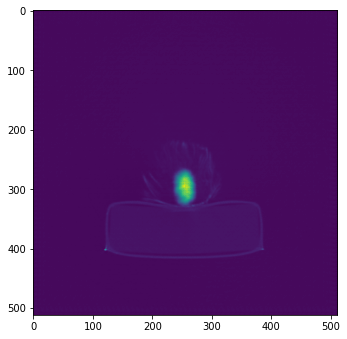

Test:  68%|██████▊   | 395/578 [02:45<01:13,  2.49it/s]660.99994 8.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00055.dcm
802.43695 0.22077128 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00055.dcm
659.99994 8.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00055.dcm


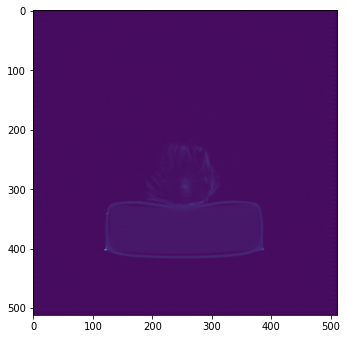

Test:  69%|██████▊   | 396/578 [02:45<01:13,  2.49it/s]651.99994 8.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00056.dcm
782.2811 0.22101536 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00056.dcm
652.99994 8.999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00056.dcm


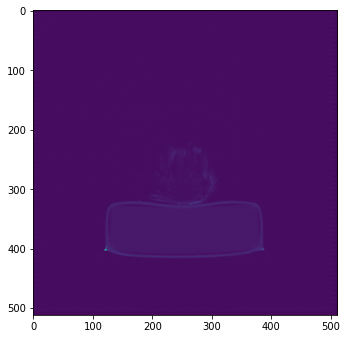

Test:  69%|██████▊   | 397/578 [02:46<01:12,  2.49it/s]549.99994 1.9999999 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/gt_low_CHA_SAN_WOL_F85_001_20201118_141232_00057.dcm
632.7678 0.22199169 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SAN_WOL_F85/pred_high_CHA_SAN_WOL_F85_001_20201118_141232_00057.dcm
550.99994 4.9999995 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SAN_WOL_F85/gt_high_CHA_SAN_WOL_F85_001_20201118_124848_00057.dcm


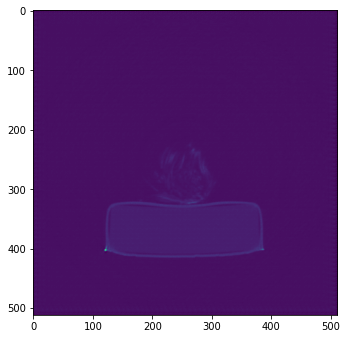

Test:  69%|██████▉   | 398/578 [02:46<01:16,  2.36it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00001.dcm
3783.2332 3.624115 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00001.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00001.dcm


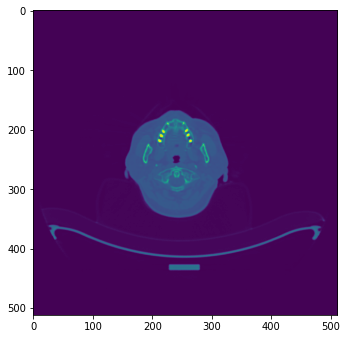

Test:  69%|██████▉   | 399/578 [02:47<01:13,  2.43it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00002.dcm
3777.45 3.5660238 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00002.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00002.dcm


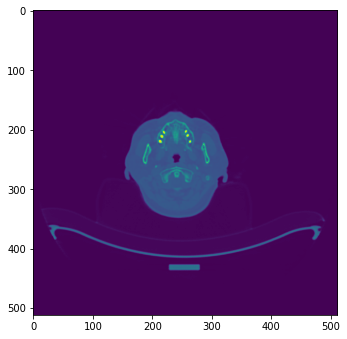

Test:  69%|██████▉   | 400/578 [02:47<01:14,  2.39it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00003.dcm
3693.8396 3.4813275 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00003.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00003.dcm


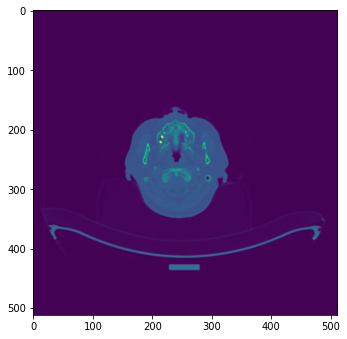

Test:  69%|██████▉   | 401/578 [02:48<01:16,  2.32it/s]2803.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00004.dcm
2756.4133 3.3463507 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00004.dcm
2798.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00004.dcm


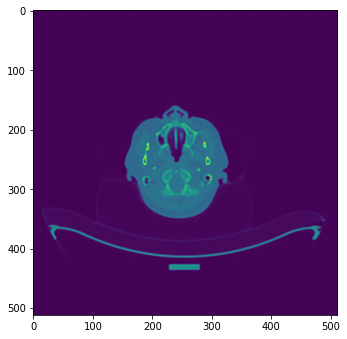

Test:  70%|██████▉   | 402/578 [02:48<01:18,  2.24it/s]2766.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00005.dcm
2743.2544 3.7493286 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00005.dcm
2768.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00005.dcm


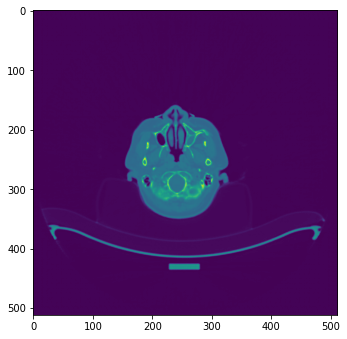

Test:  70%|██████▉   | 403/578 [02:49<01:25,  2.04it/s]2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00006.dcm
2799.7454 4.0451546 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00006.dcm
2782.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00006.dcm


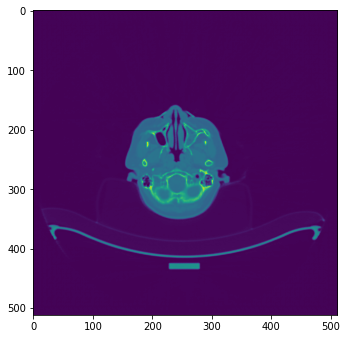

Test:  70%|██████▉   | 404/578 [02:49<01:21,  2.14it/s]2771.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00007.dcm
2777.6165 4.060898 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00007.dcm
2776.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00007.dcm


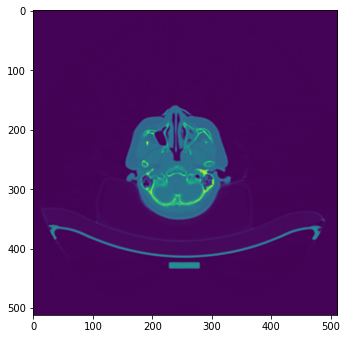

Test:  70%|███████   | 405/578 [02:50<01:19,  2.17it/s]2732.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00008.dcm
2696.0613 3.8525748 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00008.dcm
2735.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00008.dcm


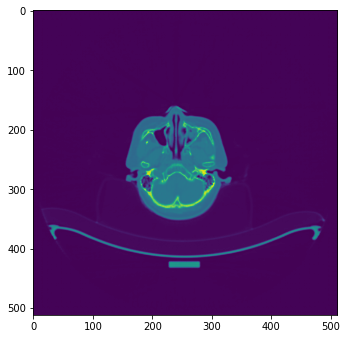

Test:  70%|███████   | 406/578 [02:50<01:18,  2.20it/s]2698.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00009.dcm
2759.5352 4.11545 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00009.dcm
2700.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00009.dcm


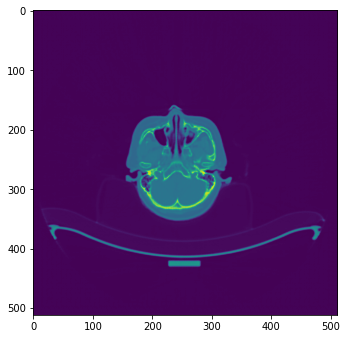

Test:  70%|███████   | 407/578 [02:50<01:15,  2.27it/s]2749.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00010.dcm
2739.1072 4.814254 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00010.dcm
2745.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00010.dcm


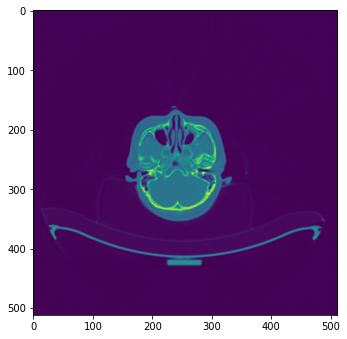

Test:  71%|███████   | 408/578 [02:51<01:13,  2.32it/s]2948.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00011.dcm
2922.2683 5.4484987 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00011.dcm
2953.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00011.dcm


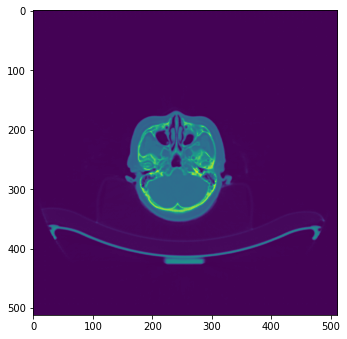

Test:  71%|███████   | 409/578 [02:51<01:12,  2.33it/s]3008.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00012.dcm
2957.624 5.2946053 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00012.dcm
2998.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00012.dcm


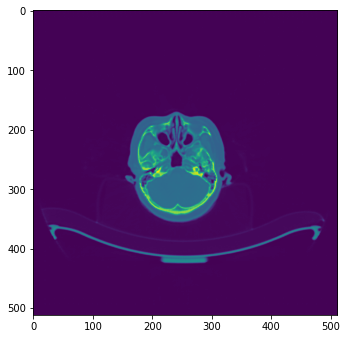

Test:  71%|███████   | 410/578 [02:52<01:13,  2.28it/s]2980.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00013.dcm
2944.429 6.151696 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00013.dcm
2982.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00013.dcm


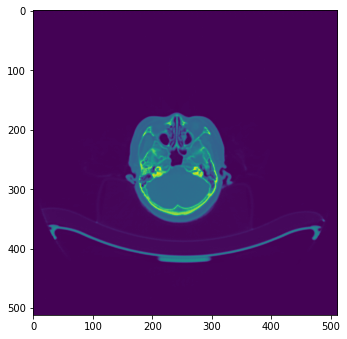

Test:  71%|███████   | 411/578 [02:52<01:11,  2.33it/s]2960.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00014.dcm
2903.0693 4.729192 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00014.dcm
2963.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00014.dcm


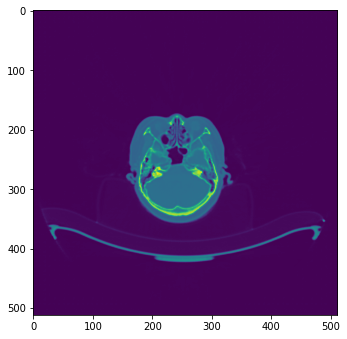

Test:  71%|███████▏  | 412/578 [02:53<01:09,  2.39it/s]2894.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00015.dcm
2943.1338 4.606663 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00015.dcm
2886.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00015.dcm


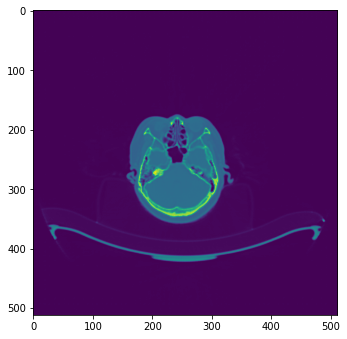

Test:  71%|███████▏  | 413/578 [02:53<01:06,  2.47it/s]2779.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00016.dcm
2804.4526 3.3722234 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00016.dcm
2773.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00016.dcm


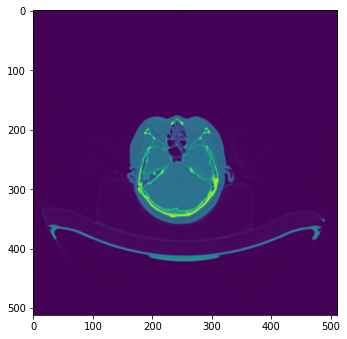

Test:  72%|███████▏  | 414/578 [02:53<01:04,  2.53it/s]2704.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00017.dcm
2629.5732 3.184525 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00017.dcm
2702.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00017.dcm


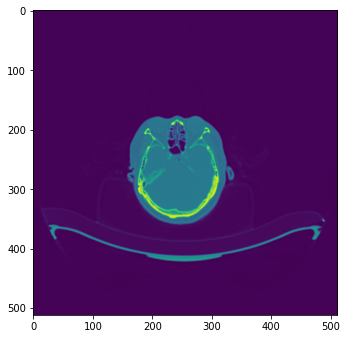

Test:  72%|███████▏  | 415/578 [02:54<01:05,  2.50it/s]2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00018.dcm
2716.9712 3.3630702 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00018.dcm
2679.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00018.dcm


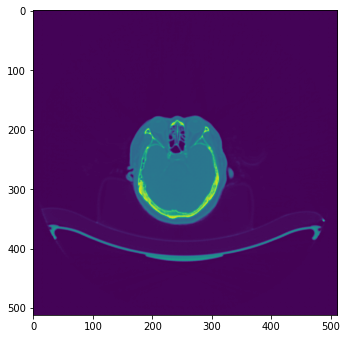

Test:  72%|███████▏  | 416/578 [02:54<01:10,  2.28it/s]2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00019.dcm
2624.6785 3.2337074 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00019.dcm
2644.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00019.dcm


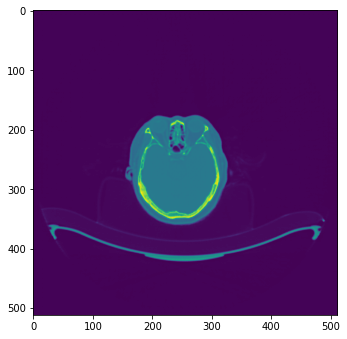

Test:  72%|███████▏  | 417/578 [02:55<01:07,  2.39it/s]2626.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00020.dcm
2609.8958 3.2511592 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00020.dcm
2630.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00020.dcm


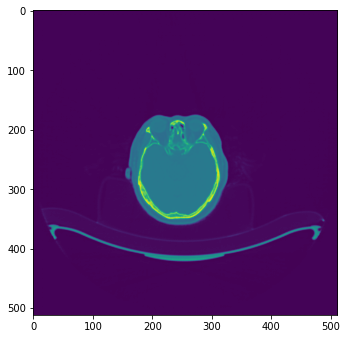

Test:  72%|███████▏  | 418/578 [02:55<01:06,  2.39it/s]2613.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00021.dcm
2614.8762 3.2942395 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00021.dcm
2606.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00021.dcm


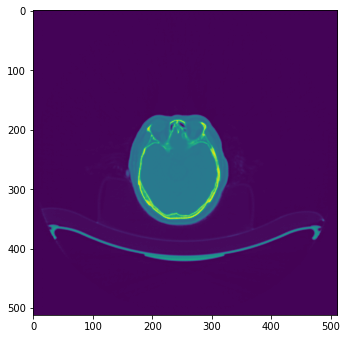

Test:  72%|███████▏  | 419/578 [02:55<01:02,  2.52it/s]2603.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00022.dcm
2638.9626 3.3812544 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00022.dcm
2596.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00022.dcm


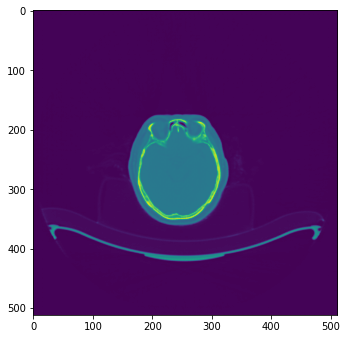

Test:  73%|███████▎  | 420/578 [02:56<01:15,  2.10it/s]2621.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00023.dcm
2594.1138 3.2794726 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00023.dcm
2627.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00023.dcm


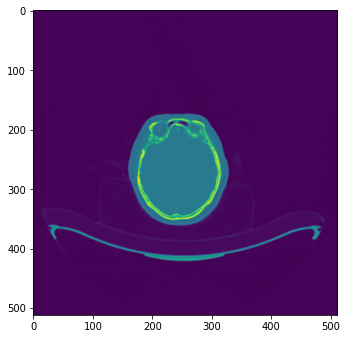

Test:  73%|███████▎  | 421/578 [02:56<01:11,  2.19it/s]2622.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00024.dcm
2615.8088 3.3451304 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00024.dcm
2621.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00024.dcm


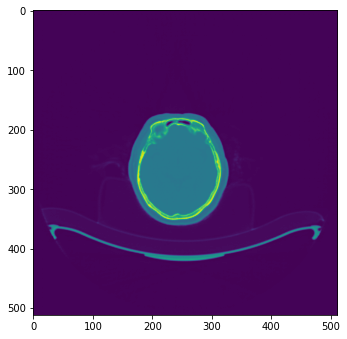

Test:  73%|███████▎  | 422/578 [02:57<01:11,  2.19it/s]2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00025.dcm
2621.733 3.3904073 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00025.dcm
2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00025.dcm


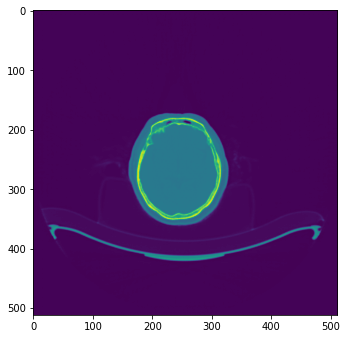

Test:  73%|███████▎  | 423/578 [02:57<01:06,  2.33it/s]2647.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00026.dcm
2625.8533 3.4533803 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00026.dcm
2644.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00026.dcm


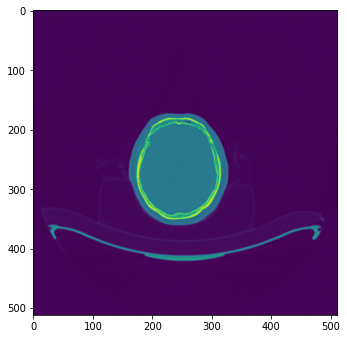

Test:  73%|███████▎  | 424/578 [02:58<01:02,  2.48it/s]2643.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00027.dcm
2622.6736 3.4754696 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00027.dcm
2644.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00027.dcm


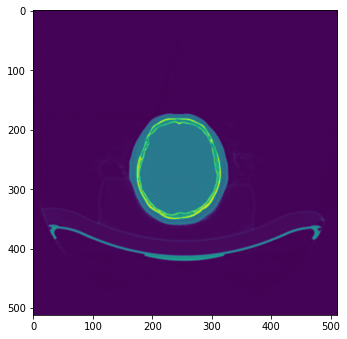

Test:  74%|███████▎  | 425/578 [02:58<01:01,  2.48it/s]2637.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00028.dcm
2652.5413 3.34989 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00028.dcm
2640.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00028.dcm


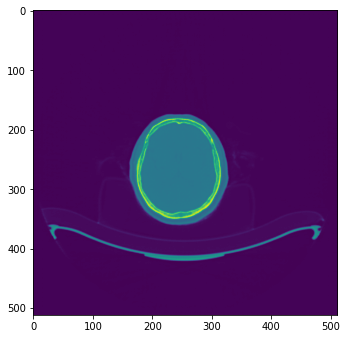

Test:  74%|███████▎  | 426/578 [02:58<00:59,  2.55it/s]2639.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00029.dcm
2663.8489 3.380156 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00029.dcm
2638.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00029.dcm


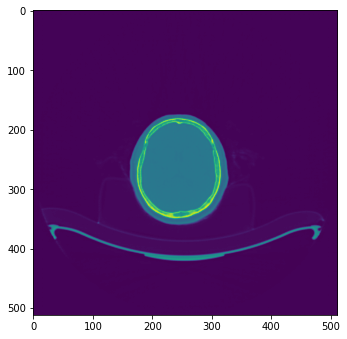

Test:  74%|███████▍  | 427/578 [02:59<01:00,  2.49it/s]2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00030.dcm
2654.02 3.3988283 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00030.dcm
2663.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00030.dcm


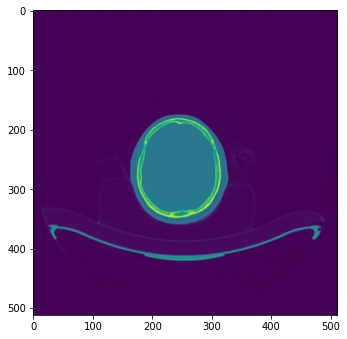

Test:  74%|███████▍  | 428/578 [02:59<00:59,  2.54it/s]2686.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00031.dcm
2643.733 3.2961922 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00031.dcm
2679.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00031.dcm


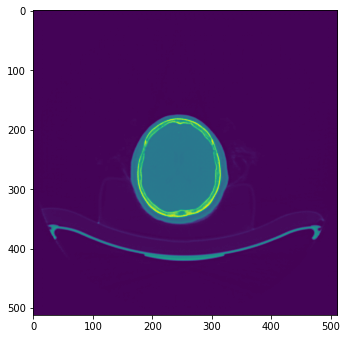

Test:  74%|███████▍  | 429/578 [03:00<00:59,  2.50it/s]2695.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00032.dcm
2650.4722 3.407371 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00032.dcm
2695.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00032.dcm


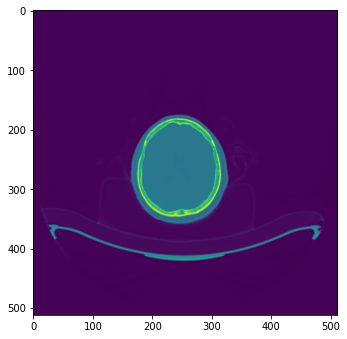

Test:  74%|███████▍  | 430/578 [03:00<01:00,  2.45it/s]2685.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00033.dcm
2649.039 3.4265313 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00033.dcm
2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00033.dcm


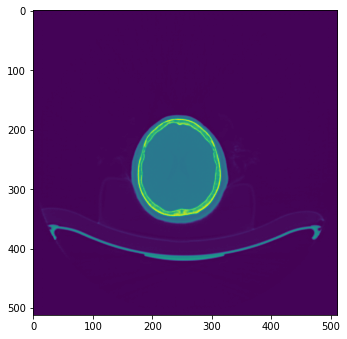

Test:  75%|███████▍  | 431/578 [03:00<01:01,  2.41it/s]2696.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00034.dcm
2627.3635 3.3323162 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00034.dcm
2700.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00034.dcm


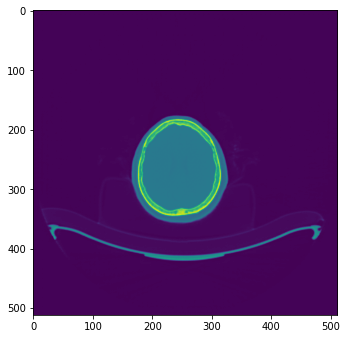

Test:  75%|███████▍  | 432/578 [03:01<01:01,  2.36it/s]2675.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00035.dcm
2659.3213 3.2106419 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00035.dcm
2672.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00035.dcm


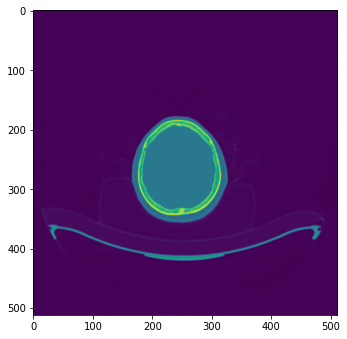

Test:  75%|███████▍  | 433/578 [03:01<00:59,  2.42it/s]2659.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00036.dcm
2609.448 3.2787404 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00036.dcm
2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00036.dcm


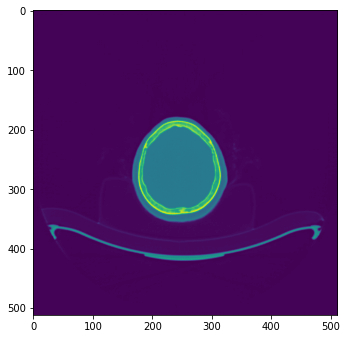

Test:  75%|███████▌  | 434/578 [03:02<01:05,  2.21it/s]2638.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00037.dcm
2559.8987 3.166219 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00037.dcm
2636.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00037.dcm


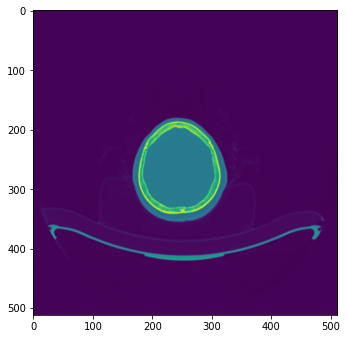

Test:  75%|███████▌  | 435/578 [03:02<01:01,  2.33it/s]2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00038.dcm
2584.9192 3.1505978 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00038.dcm
2620.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00038.dcm


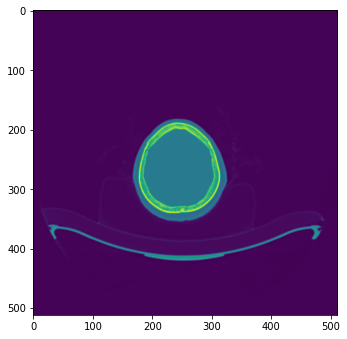

Test:  75%|███████▌  | 436/578 [03:03<00:57,  2.47it/s]2604.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00039.dcm
2555.983 3.0670002 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00039.dcm
2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00039.dcm


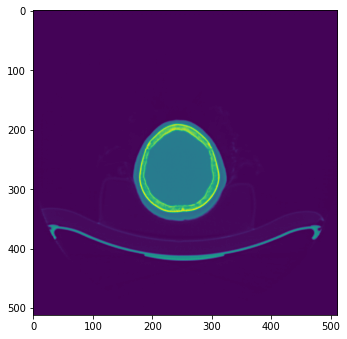

Test:  76%|███████▌  | 437/578 [03:03<00:53,  2.62it/s]2598.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00040.dcm
2576.0037 3.0663898 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00040.dcm
2588.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00040.dcm


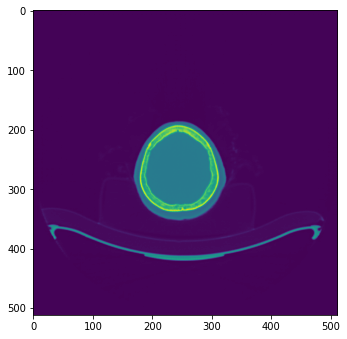

Test:  76%|███████▌  | 438/578 [03:03<00:56,  2.49it/s]2551.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00041.dcm
2527.8333 2.9838905 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00041.dcm
2546.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00041.dcm


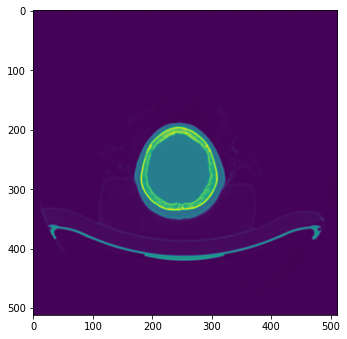

Test:  76%|███████▌  | 439/578 [03:04<00:53,  2.58it/s]2513.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00042.dcm
2536.6025 2.8246276 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00042.dcm
2519.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00042.dcm


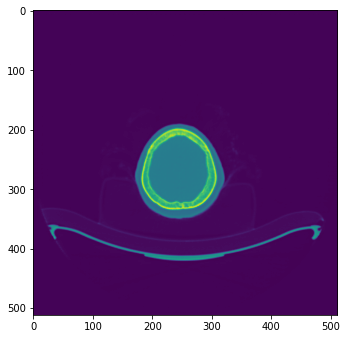

Test:  76%|███████▌  | 440/578 [03:04<00:52,  2.62it/s]2472.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00043.dcm
2479.141 2.671589 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00043.dcm
2466.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00043.dcm


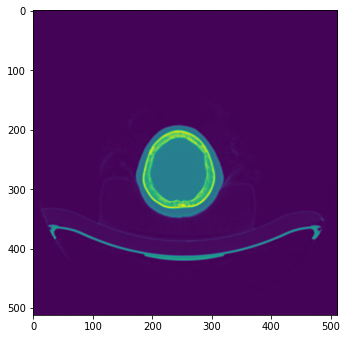

Test:  76%|███████▋  | 441/578 [03:04<00:49,  2.74it/s]2483.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00044.dcm
2539.942 2.7050278 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00044.dcm
2485.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00044.dcm


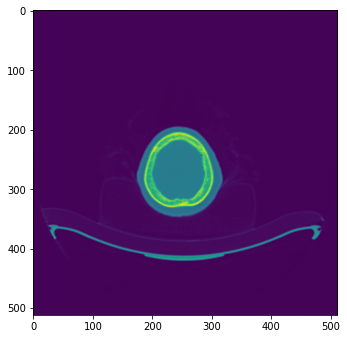

Test:  76%|███████▋  | 442/578 [03:05<00:48,  2.81it/s]2504.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00045.dcm
2511.6743 2.5840857 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00045.dcm
2508.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00045.dcm


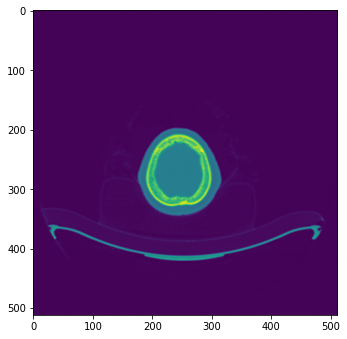

Test:  77%|███████▋  | 443/578 [03:05<00:48,  2.77it/s]2467.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00046.dcm
2492.8958 2.407249 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00046.dcm
2467.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00046.dcm


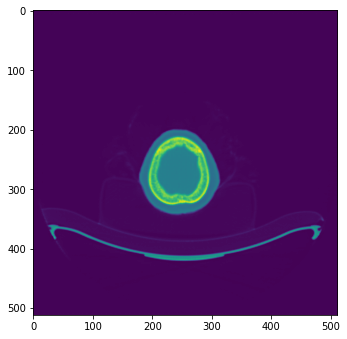

Test:  77%|███████▋  | 444/578 [03:05<00:49,  2.73it/s]2503.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00047.dcm
2515.471 2.3140101 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00047.dcm
2505.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00047.dcm


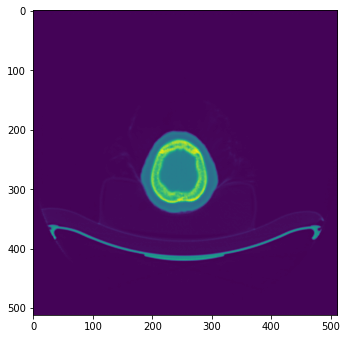

Test:  77%|███████▋  | 445/578 [03:06<00:47,  2.81it/s]2494.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00048.dcm
2573.664 2.2243104 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00048.dcm
2493.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00048.dcm


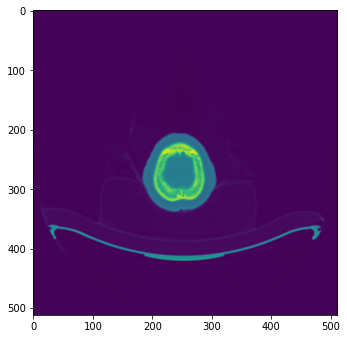

Test:  77%|███████▋  | 446/578 [03:06<00:47,  2.78it/s]2516.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00049.dcm
2570.5708 2.096412 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00049.dcm
2510.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00049.dcm


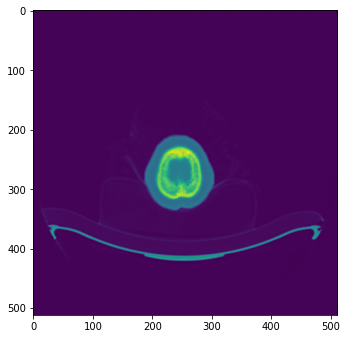

Test:  77%|███████▋  | 447/578 [03:06<00:47,  2.76it/s]2517.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00050.dcm
2507.886 1.9433731 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00050.dcm
2514.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00050.dcm


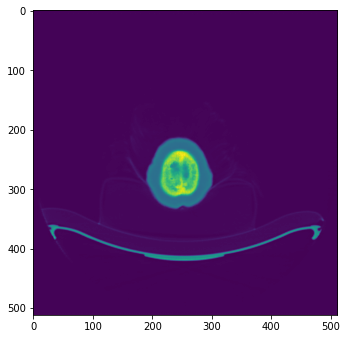

Test:  78%|███████▊  | 448/578 [03:07<00:46,  2.82it/s]2515.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00051.dcm
2523.4722 1.73505 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00051.dcm
2512.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00051.dcm


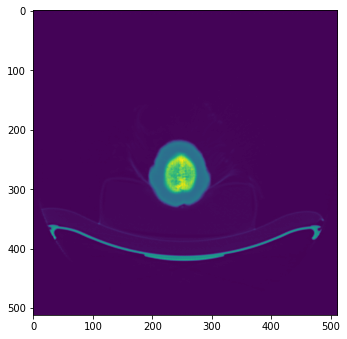

Test:  78%|███████▊  | 449/578 [03:07<00:46,  2.78it/s]2492.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00052.dcm
2534.0393 1.6455942 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00052.dcm
2496.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00052.dcm


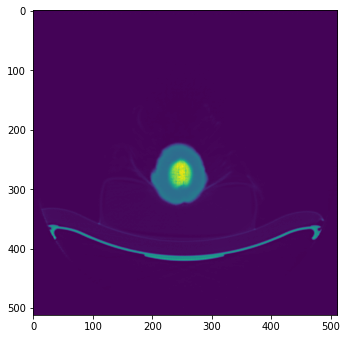

Test:  78%|███████▊  | 450/578 [03:08<00:47,  2.69it/s]1806.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00053.dcm
1937.9937 1.6725652 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00053.dcm
1807.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00053.dcm


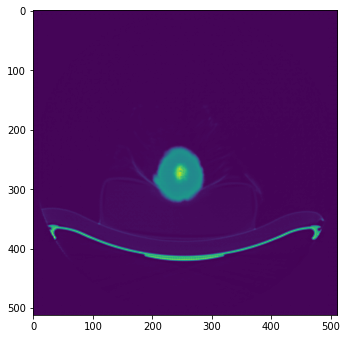

Test:  78%|███████▊  | 451/578 [03:08<00:46,  2.72it/s]1840.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00054.dcm
1978.8756 1.5300219 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00054.dcm
1840.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00054.dcm


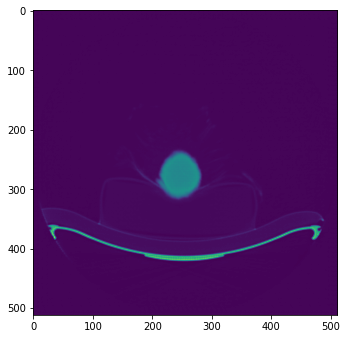

Test:  78%|███████▊  | 452/578 [03:08<00:50,  2.52it/s]1871.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/gt_low_CHA_SOO_JA,_F72_001_20201119_154516_00055.dcm
2008.9851 1.6175249 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_SOO_JA,_F72/pred_high_CHA_SOO_JA,_F72_001_20201119_154516_00055.dcm
1872.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_SOO_JA,_F72/gt_high_CHA_SOO_JA,_F72_001_20201119_142328_00055.dcm


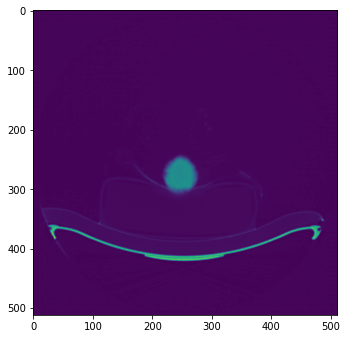

Test:  78%|███████▊  | 453/578 [03:09<00:47,  2.62it/s]1842.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00001.dcm
2031.3435 1.5471076 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00001.dcm
1844.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00001.dcm


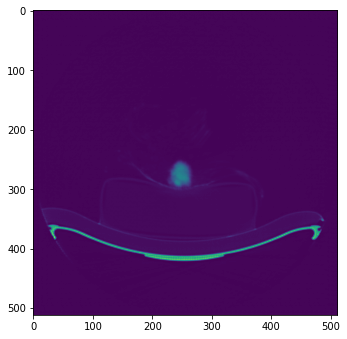

Test:  79%|███████▊  | 454/578 [03:09<00:50,  2.46it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00002.dcm
3653.785 4.2588477 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00002.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00002.dcm


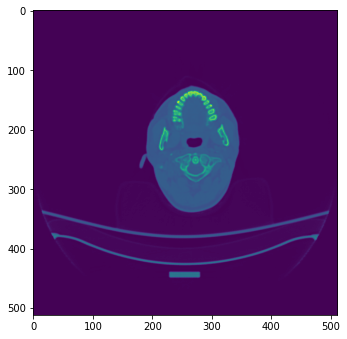

Test:  79%|███████▊  | 455/578 [03:10<00:47,  2.56it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00003.dcm
3432.1921 4.283012 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00003.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00003.dcm


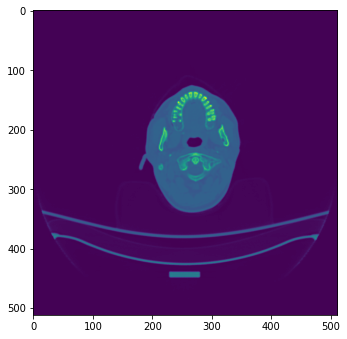

Test:  79%|███████▉  | 456/578 [03:10<00:47,  2.59it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00004.dcm
3535.1716 4.1719546 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00004.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00004.dcm


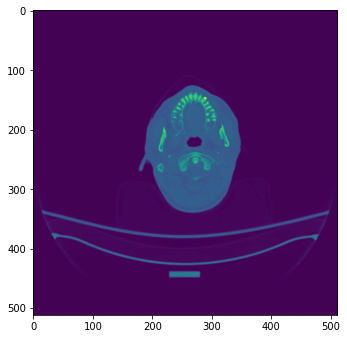

Test:  79%|███████▉  | 457/578 [03:10<00:45,  2.66it/s]2800.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00005.dcm
2765.3928 3.9697337 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00005.dcm
2795.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00005.dcm


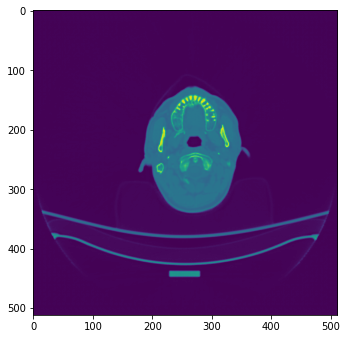

Test:  79%|███████▉  | 458/578 [03:11<00:46,  2.60it/s]2748.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00006.dcm
2805.2854 4.072126 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00006.dcm
2751.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00006.dcm


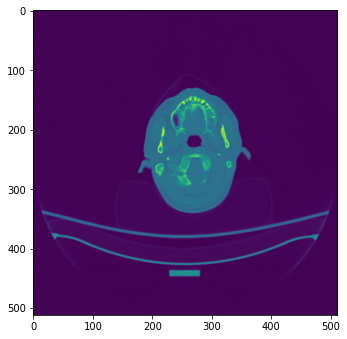

Test:  79%|███████▉  | 459/578 [03:11<00:43,  2.72it/s]2729.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00007.dcm
2754.5925 4.4757137 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00007.dcm
2726.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00007.dcm


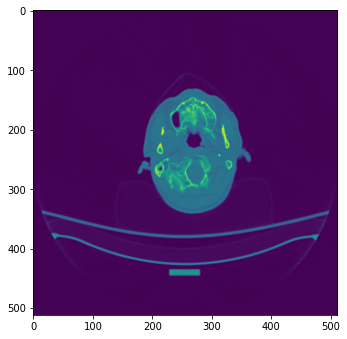

Test:  80%|███████▉  | 460/578 [03:11<00:42,  2.77it/s]2737.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00008.dcm
2786.1865 4.596778 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00008.dcm
2722.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00008.dcm


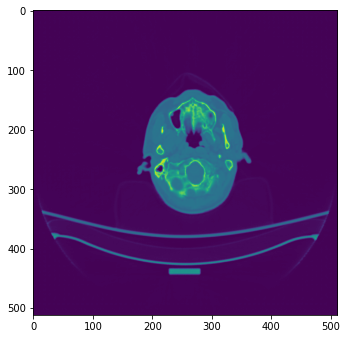

Test:  80%|███████▉  | 461/578 [03:12<00:44,  2.63it/s]2709.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00009.dcm
2718.7048 4.518916 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00009.dcm
2702.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00009.dcm


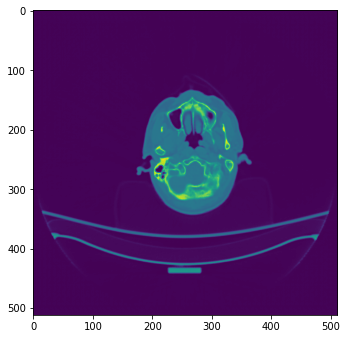

Test:  80%|███████▉  | 462/578 [03:12<00:42,  2.73it/s]2720.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00010.dcm
2744.8494 5.0013423 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00010.dcm
2720.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00010.dcm


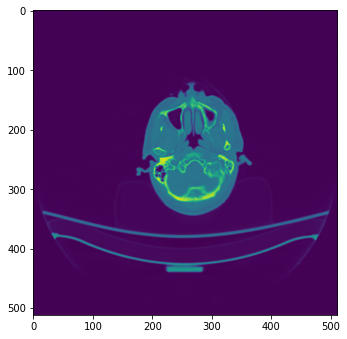

Test:  80%|████████  | 463/578 [03:13<00:42,  2.69it/s]2668.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00011.dcm
2708.7117 5.3789353 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00011.dcm
2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00011.dcm


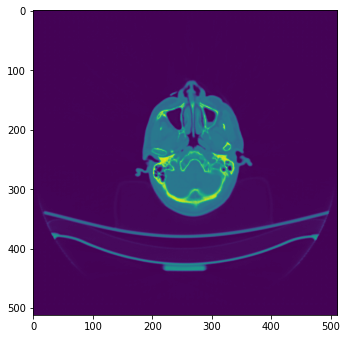

Test:  80%|████████  | 464/578 [03:13<00:51,  2.23it/s]2672.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00012.dcm
2687.5762 6.0829873 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00012.dcm
2673.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00012.dcm


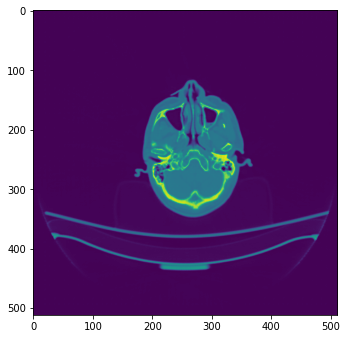

Test:  80%|████████  | 465/578 [03:14<00:51,  2.20it/s]2678.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00013.dcm
2731.887 5.351476 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00013.dcm
2679.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00013.dcm


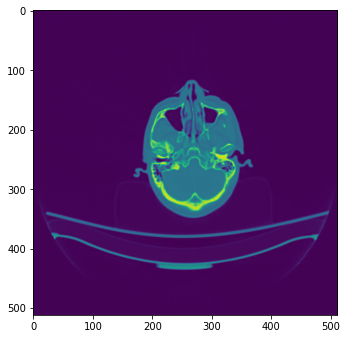

Test:  81%|████████  | 466/578 [03:14<00:49,  2.26it/s]2653.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00014.dcm
2710.5132 5.4937754 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00014.dcm
2654.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00014.dcm


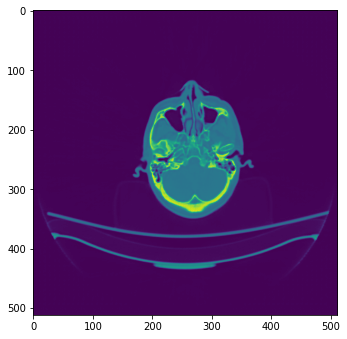

Test:  81%|████████  | 467/578 [03:14<00:48,  2.30it/s]2849.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00015.dcm
2888.0242 5.4810834 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00015.dcm
2847.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00015.dcm


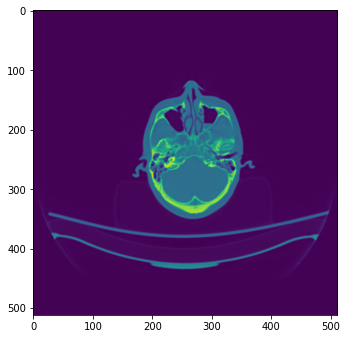

Test:  81%|████████  | 468/578 [03:15<00:46,  2.35it/s]2908.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00016.dcm
2887.4004 5.0561385 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00016.dcm
2903.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00016.dcm


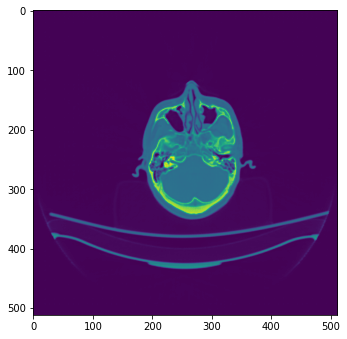

Test:  81%|████████  | 469/578 [03:15<00:47,  2.32it/s]2872.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00017.dcm
2877.7283 4.973761 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00017.dcm
2870.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00017.dcm


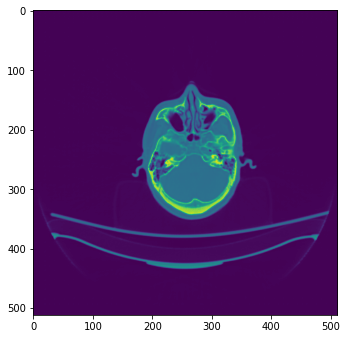

Test:  81%|████████▏ | 470/578 [03:16<00:49,  2.18it/s]2861.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00018.dcm
2814.9014 4.4089575 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00018.dcm
2865.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00018.dcm


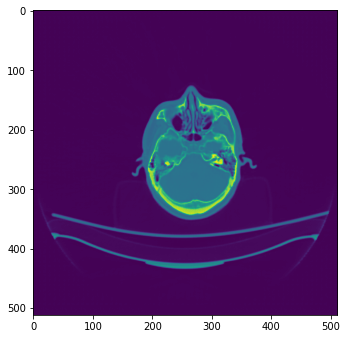

Test:  81%|████████▏ | 471/578 [03:16<00:48,  2.20it/s]2839.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00019.dcm
2831.3687 3.952526 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00019.dcm
2835.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00019.dcm


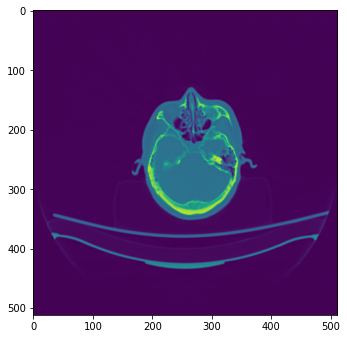

Test:  82%|████████▏ | 472/578 [03:17<00:47,  2.22it/s]2822.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00020.dcm
2736.6323 3.8127897 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00020.dcm
2814.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00020.dcm


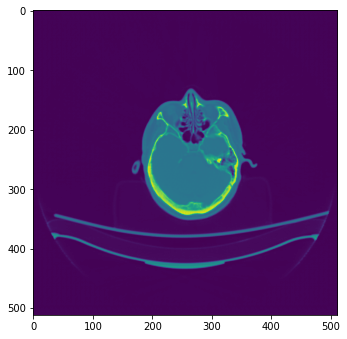

Test:  82%|████████▏ | 473/578 [03:17<00:46,  2.26it/s]2663.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00021.dcm
2688.3267 3.6165485 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00021.dcm
2663.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00021.dcm


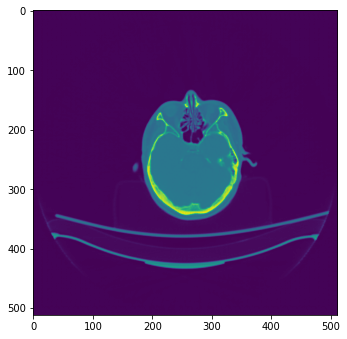

Test:  82%|████████▏ | 474/578 [03:18<00:44,  2.34it/s]2709.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00022.dcm
2693.006 3.6798875 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00022.dcm
2709.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00022.dcm


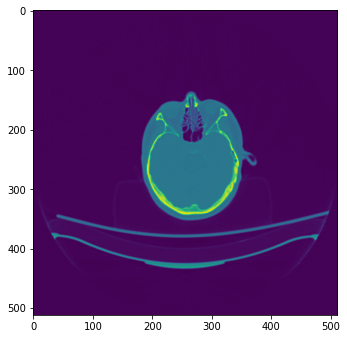

Test:  82%|████████▏ | 475/578 [03:18<00:42,  2.42it/s]2691.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00023.dcm
2661.1343 3.7340734 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00023.dcm
2697.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00023.dcm


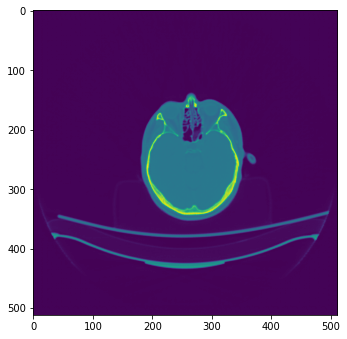

Test:  82%|████████▏ | 476/578 [03:18<00:40,  2.51it/s]2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00024.dcm
2666.7341 3.7737367 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00024.dcm
2643.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00024.dcm


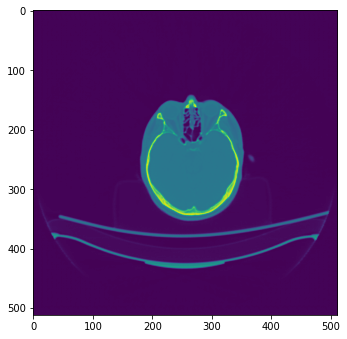

Test:  83%|████████▎ | 477/578 [03:19<00:39,  2.58it/s]2626.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00025.dcm
2638.9321 3.4989014 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00025.dcm
2632.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00025.dcm


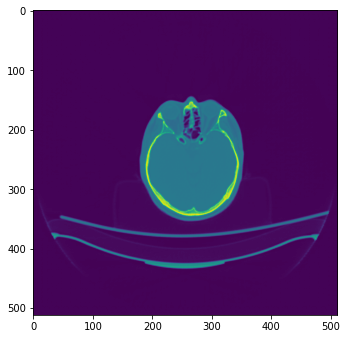

Test:  83%|████████▎ | 478/578 [03:19<00:37,  2.67it/s]2656.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00026.dcm
2662.8247 3.829265 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00026.dcm
2655.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00026.dcm


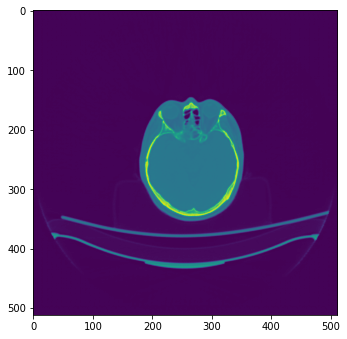

Test:  83%|████████▎ | 479/578 [03:19<00:35,  2.77it/s]2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00027.dcm
2657.9885 3.808274 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00027.dcm
2640.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00027.dcm


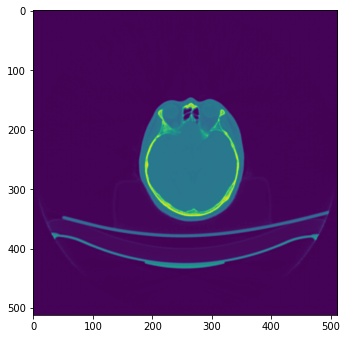

Test:  83%|████████▎ | 480/578 [03:20<00:34,  2.81it/s]2609.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00028.dcm
2637.812 3.7766657 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00028.dcm
2596.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00028.dcm


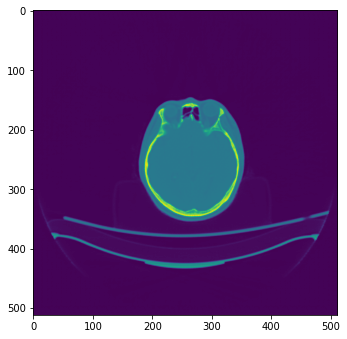

Test:  83%|████████▎ | 481/578 [03:20<00:33,  2.86it/s]2632.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00029.dcm
2638.6653 3.7025871 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00029.dcm
2625.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00029.dcm


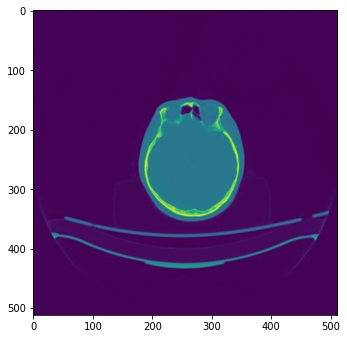

Test:  83%|████████▎ | 482/578 [03:20<00:33,  2.89it/s]2612.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00030.dcm
2649.7883 3.5147667 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00030.dcm
2605.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00030.dcm


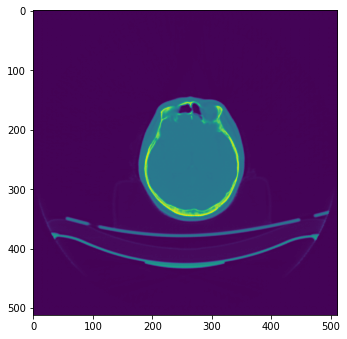

Test:  84%|████████▎ | 483/578 [03:21<00:34,  2.75it/s]2589.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00031.dcm
2648.776 3.6739075 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00031.dcm
2586.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00031.dcm


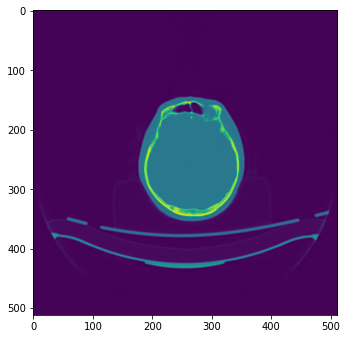

Test:  84%|████████▎ | 484/578 [03:21<00:35,  2.62it/s]2605.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00032.dcm
2651.0266 3.6701243 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00032.dcm
2602.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00032.dcm


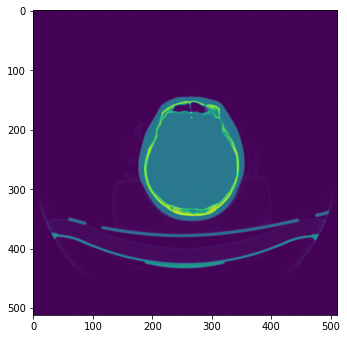

Test:  84%|████████▍ | 485/578 [03:22<00:36,  2.55it/s]2600.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00033.dcm
2623.5403 3.570173 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00033.dcm
2600.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00033.dcm


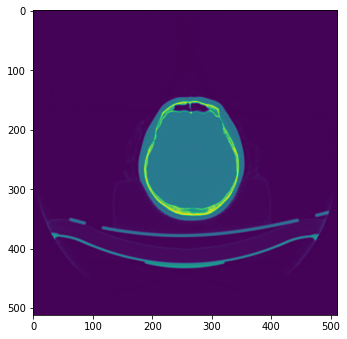

Test:  84%|████████▍ | 486/578 [03:22<00:36,  2.51it/s]2615.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00034.dcm
2612.5977 3.6503537 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00034.dcm
2608.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00034.dcm


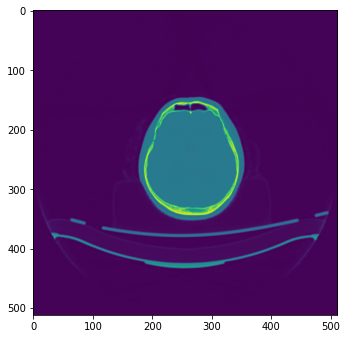

Test:  84%|████████▍ | 487/578 [03:22<00:35,  2.56it/s]2624.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00035.dcm
2623.773 3.605687 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00035.dcm
2621.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00035.dcm


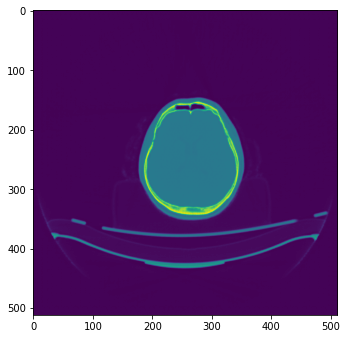

Test:  84%|████████▍ | 488/578 [03:23<00:36,  2.44it/s]2644.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00036.dcm
2614.442 3.6322918 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00036.dcm
2642.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00036.dcm


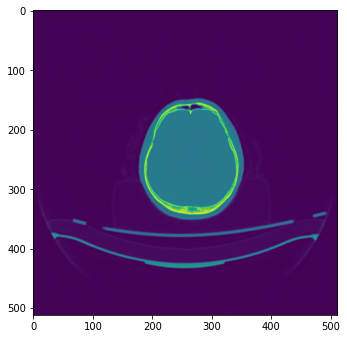

Test:  85%|████████▍ | 489/578 [03:24<00:44,  2.02it/s]2636.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00037.dcm
2611.9167 3.5651693 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00037.dcm
2634.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00037.dcm


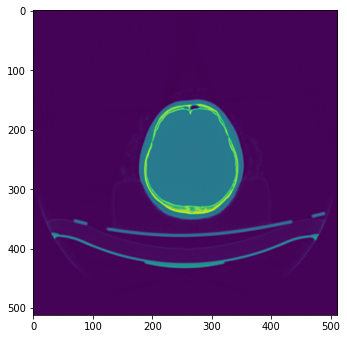

Test:  85%|████████▍ | 490/578 [03:24<00:41,  2.11it/s]2657.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00038.dcm
2643.0352 3.5711493 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00038.dcm
2664.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00038.dcm


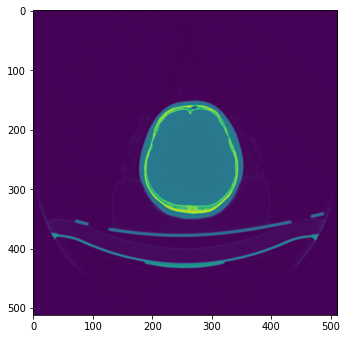

Test:  85%|████████▍ | 491/578 [03:24<00:40,  2.16it/s]2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00039.dcm
2604.3044 3.5084205 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00039.dcm
2677.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00039.dcm


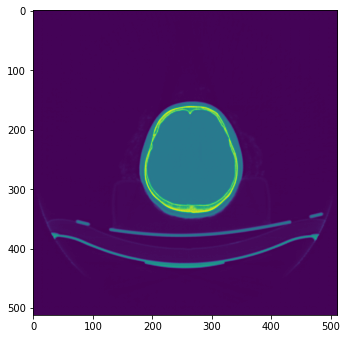

Test:  85%|████████▌ | 492/578 [03:25<00:38,  2.25it/s]2666.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00040.dcm
2620.9148 3.4092016 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00040.dcm
2664.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00040.dcm


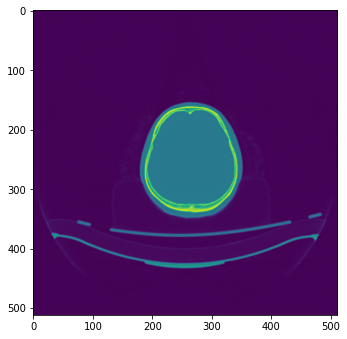

Test:  85%|████████▌ | 493/578 [03:25<00:36,  2.34it/s]2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00041.dcm
2591.946 3.555284 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00041.dcm
2661.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00041.dcm


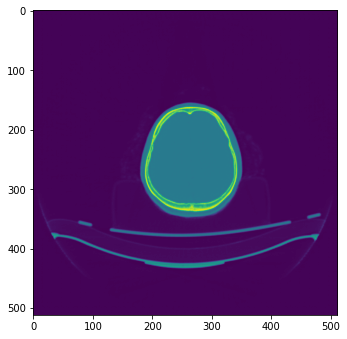

Test:  85%|████████▌ | 494/578 [03:26<00:34,  2.44it/s]2638.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00042.dcm
2576.631 3.5327067 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00042.dcm
2641.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00042.dcm


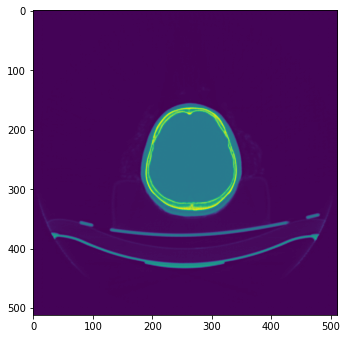

Test:  86%|████████▌ | 495/578 [03:26<00:32,  2.55it/s]2589.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00043.dcm
2584.9648 3.4902365 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00043.dcm
2591.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00043.dcm


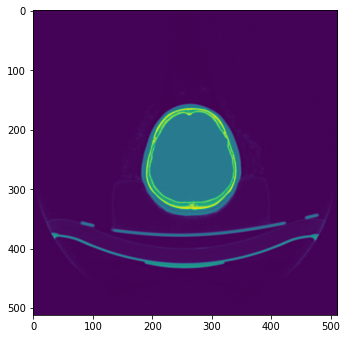

Test:  86%|████████▌ | 496/578 [03:26<00:31,  2.64it/s]2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00044.dcm
2579.2805 3.1557236 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00044.dcm
2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00044.dcm


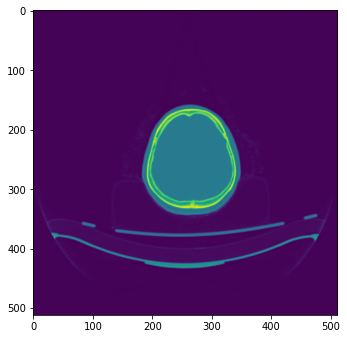

Test:  86%|████████▌ | 497/578 [03:27<00:31,  2.58it/s]2596.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00045.dcm
2599.3384 2.9085915 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00045.dcm
2600.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00045.dcm


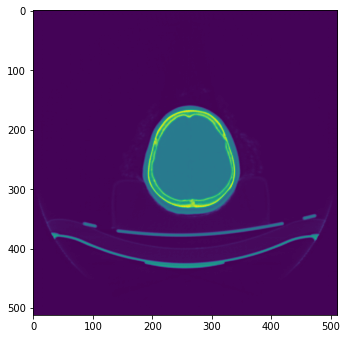

Test:  86%|████████▌ | 498/578 [03:27<00:30,  2.66it/s]2595.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00046.dcm
2621.6277 3.1582863 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00046.dcm
2589.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00046.dcm


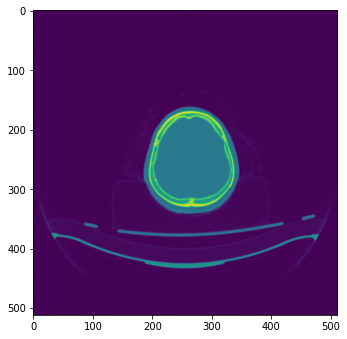

Test:  86%|████████▋ | 499/578 [03:27<00:28,  2.73it/s]2604.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00047.dcm
2627.4517 3.1025138 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00047.dcm
2603.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00047.dcm


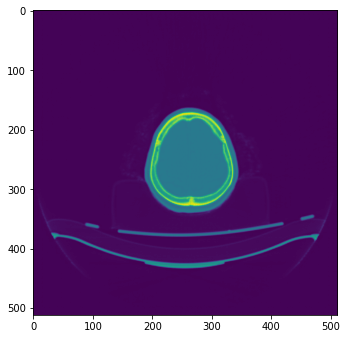

Test:  87%|████████▋ | 500/578 [03:28<00:28,  2.71it/s]2585.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00048.dcm
2669.4678 2.7690992 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00048.dcm
2590.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00048.dcm


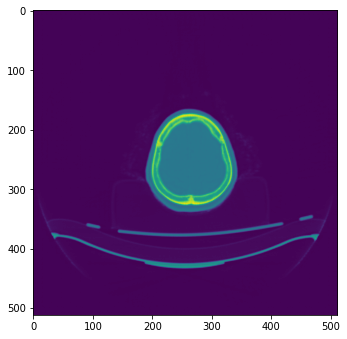

Test:  87%|████████▋ | 501/578 [03:28<00:30,  2.50it/s]2579.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00049.dcm
2609.9146 2.8268244 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00049.dcm
2569.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00049.dcm


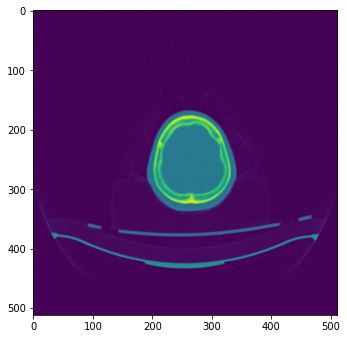

Test:  87%|████████▋ | 502/578 [03:29<00:28,  2.64it/s]2559.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00050.dcm
2606.03 2.864779 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00050.dcm
2565.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00050.dcm


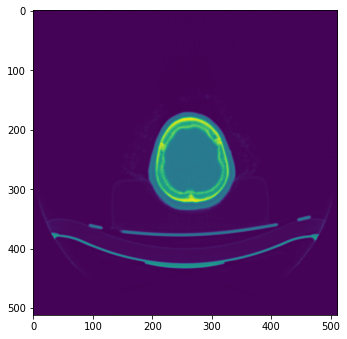

Test:  87%|████████▋ | 503/578 [03:29<00:28,  2.62it/s]2561.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00051.dcm
2562.721 2.641933 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00051.dcm
2562.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00051.dcm


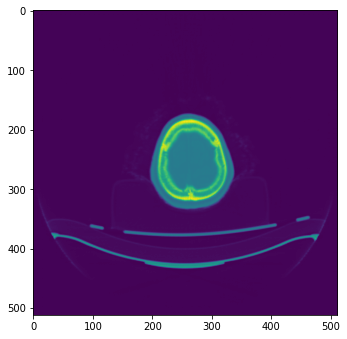

Test:  87%|████████▋ | 504/578 [03:29<00:28,  2.64it/s]2551.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183049_00052.dcm
2582.5906 2.738589 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183049_00052.dcm
2554.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00052.dcm


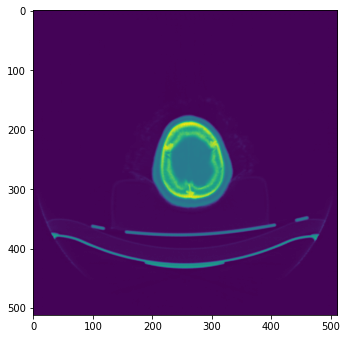

Test:  87%|████████▋ | 505/578 [03:30<00:27,  2.66it/s]2558.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00053.dcm
2585.2832 2.723334 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00053.dcm
2557.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00053.dcm


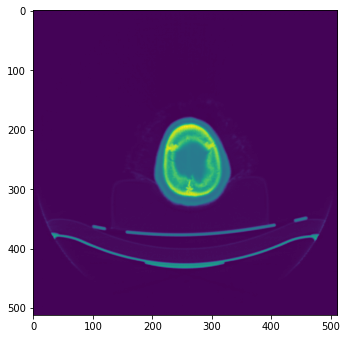

Test:  88%|████████▊ | 506/578 [03:30<00:28,  2.51it/s]2517.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00054.dcm
2572.3652 2.6767144 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00054.dcm
2518.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00054.dcm


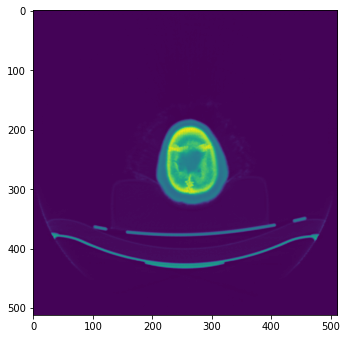

Test:  88%|████████▊ | 507/578 [03:30<00:27,  2.62it/s]2491.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00055.dcm
2551.2231 2.3886988 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00055.dcm
2494.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00055.dcm


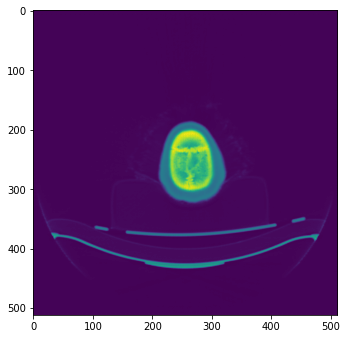

Test:  88%|████████▊ | 508/578 [03:31<00:25,  2.76it/s]2480.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00056.dcm
2520.21 2.3026605 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00056.dcm
2485.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00056.dcm


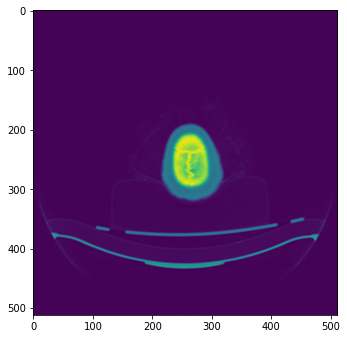

Test:  88%|████████▊ | 509/578 [03:31<00:26,  2.60it/s]2480.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00057.dcm
2554.8264 2.111301 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00057.dcm
2479.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00057.dcm


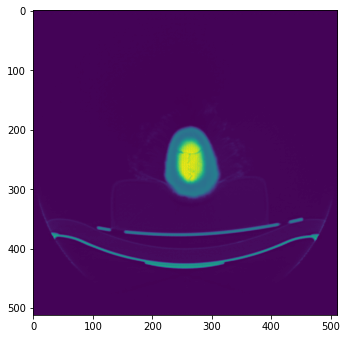

Test:  88%|████████▊ | 510/578 [03:32<00:26,  2.61it/s]1931.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00058.dcm
1954.7126 2.316573 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00058.dcm
1929.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00058.dcm


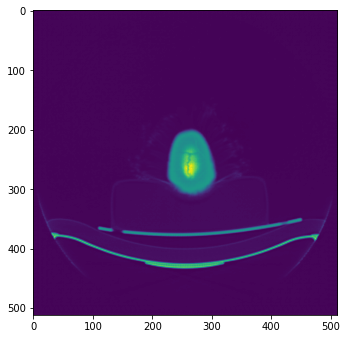

Test:  88%|████████▊ | 511/578 [03:32<00:26,  2.53it/s]1906.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/gt_low_CHA_WOO_M71_001_20201119_183050_00059.dcm
1759.3467 2.1701243 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_WOO_M71/pred_high_CHA_WOO_M71_001_20201119_183050_00059.dcm
1899.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_WOO_M71/gt_high_CHA_WOO_M71_001_20201119_170647_00059.dcm


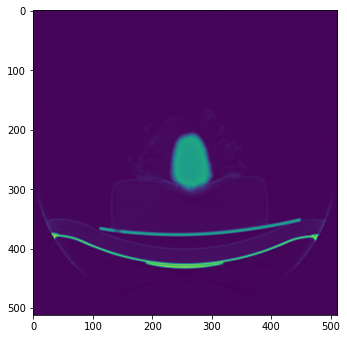

Test:  89%|████████▊ | 512/578 [03:32<00:27,  2.42it/s]1914.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00001.dcm
1758.1915 2.5501585 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00001.dcm
1918.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00001.dcm


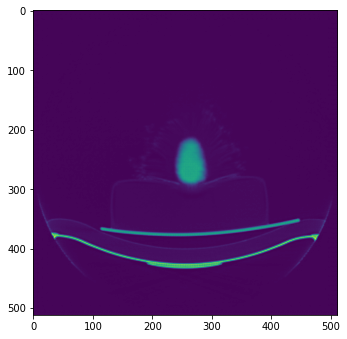

Test:  89%|████████▉ | 513/578 [03:33<00:27,  2.35it/s]1934.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00002.dcm
1771.0851 2.2738588 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00002.dcm
1929.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00002.dcm


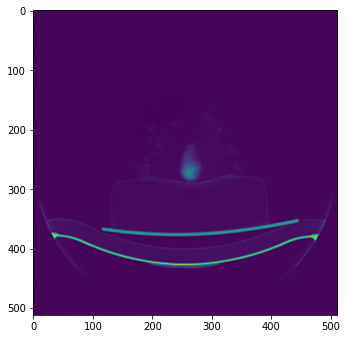

Test:  89%|████████▉ | 514/578 [03:33<00:26,  2.38it/s]1914.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00003.dcm
1764.7188 1.7217475 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00003.dcm
1914.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00003.dcm


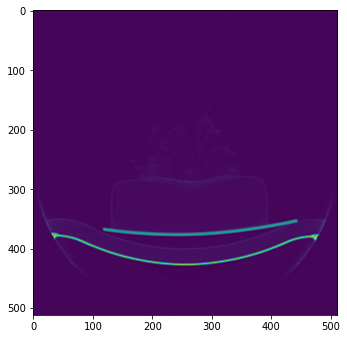

Test:  89%|████████▉ | 515/578 [03:34<00:26,  2.36it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00004.dcm
3741.441 3.9547226 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00004.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00004.dcm


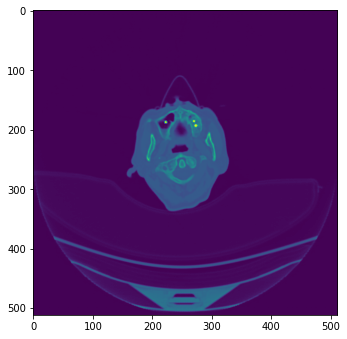

Test:  89%|████████▉ | 516/578 [03:34<00:25,  2.39it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00005.dcm
3723.5964 4.3509884 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00005.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00005.dcm


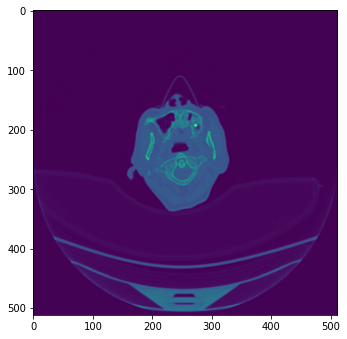

Test:  89%|████████▉ | 517/578 [03:35<00:25,  2.39it/s]2817.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00006.dcm
2754.3967 4.452526 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00006.dcm
2815.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00006.dcm


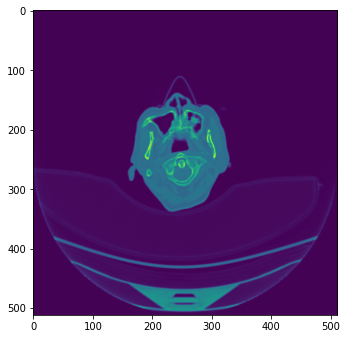

Test:  90%|████████▉ | 518/578 [03:35<00:24,  2.42it/s]2816.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00007.dcm
2682.1155 4.5051255 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00007.dcm
2817.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00007.dcm


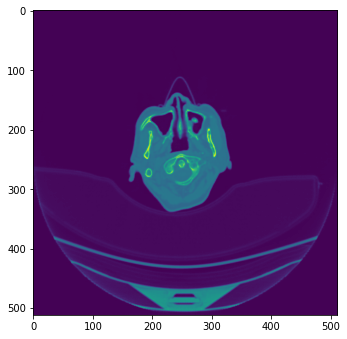

Test:  90%|████████▉ | 519/578 [03:36<00:28,  2.07it/s]2806.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00008.dcm
2732.6067 4.363314 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00008.dcm
2805.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00008.dcm


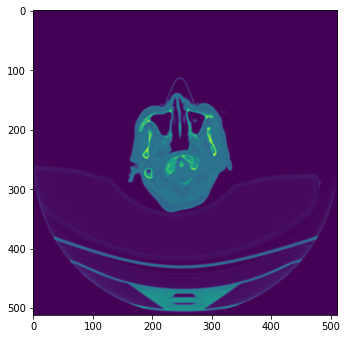

Test:  90%|████████▉ | 520/578 [03:36<00:27,  2.12it/s]2809.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00009.dcm
2732.9546 4.7190623 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00009.dcm
2805.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00009.dcm


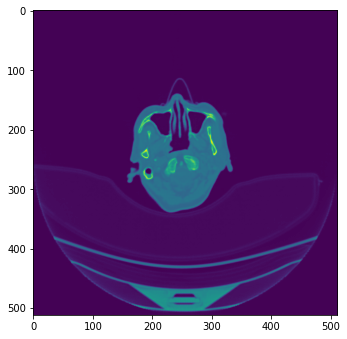

Test:  90%|█████████ | 521/578 [03:36<00:25,  2.20it/s]2805.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00010.dcm
2765.005 4.9001703 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00010.dcm
2801.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00010.dcm


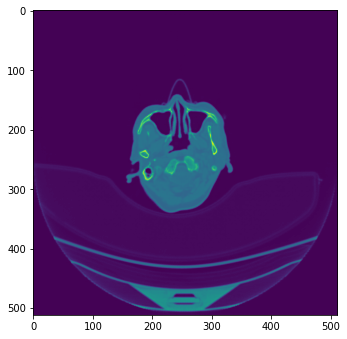

Test:  90%|█████████ | 522/578 [03:37<00:24,  2.26it/s]2793.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00011.dcm
2745.1824 5.069929 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00011.dcm
2791.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00011.dcm


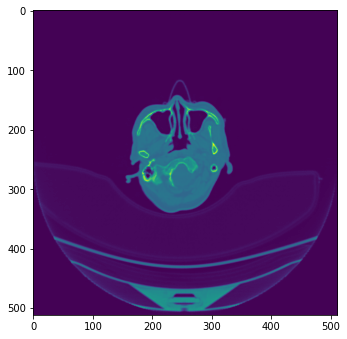

Test:  90%|█████████ | 523/578 [03:37<00:23,  2.33it/s]2801.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00012.dcm
2722.6511 2.9200633 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00012.dcm
2803.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00012.dcm


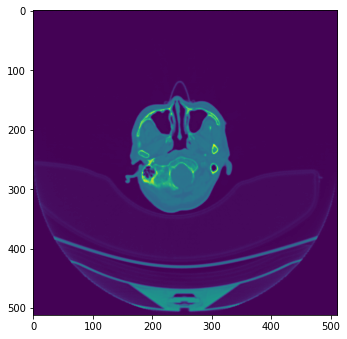

Test:  91%|█████████ | 524/578 [03:38<00:23,  2.28it/s]2783.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00013.dcm
2691.2417 2.9421525 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00013.dcm
2781.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00013.dcm


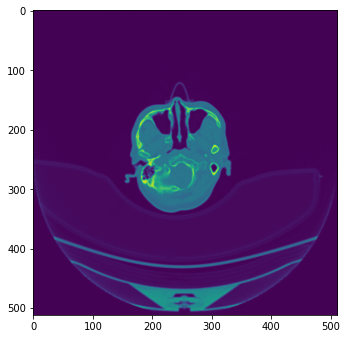

Test:  91%|█████████ | 525/578 [03:38<00:21,  2.43it/s]2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00014.dcm
2658.9863 4.6865997 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00014.dcm
2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00014.dcm


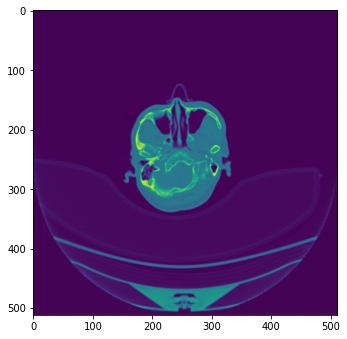

Test:  91%|█████████ | 526/578 [03:38<00:20,  2.53it/s]2695.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00015.dcm
2659.811 4.9967046 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00015.dcm
2694.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00015.dcm


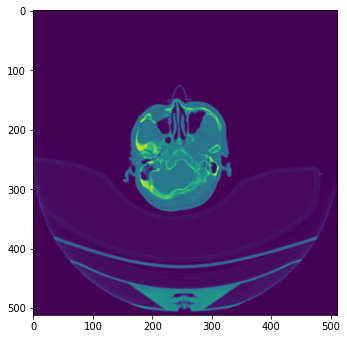

Test:  91%|█████████ | 527/578 [03:39<00:19,  2.64it/s]2736.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00016.dcm
2645.372 5.350134 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00016.dcm
2735.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00016.dcm


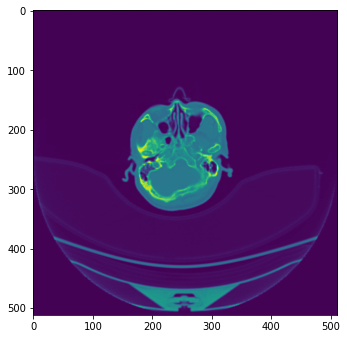

Test:  91%|█████████▏| 528/578 [03:39<00:22,  2.22it/s]2920.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00017.dcm
2878.5989 5.004515 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00017.dcm
2920.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00017.dcm


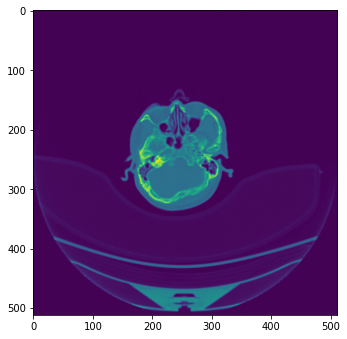

Test:  92%|█████████▏| 529/578 [03:40<00:21,  2.33it/s]2958.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00018.dcm
2907.5068 5.142909 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00018.dcm
2969.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00018.dcm


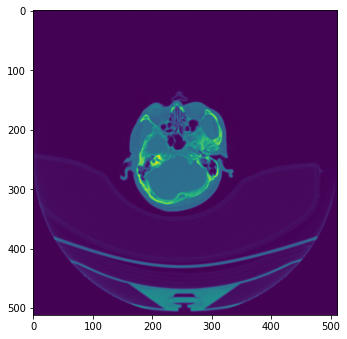

Test:  92%|█████████▏| 530/578 [03:40<00:19,  2.46it/s]2978.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00019.dcm
2913.9475 5.4718084 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00019.dcm
2972.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00019.dcm


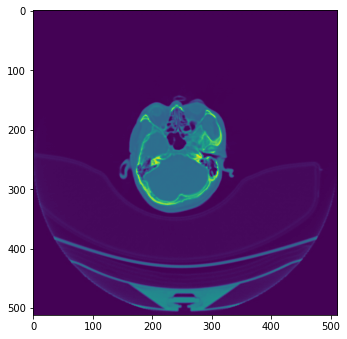

Test:  92%|█████████▏| 531/578 [03:41<00:18,  2.54it/s]2989.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00020.dcm
2951.7505 5.4814496 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00020.dcm
2990.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00020.dcm


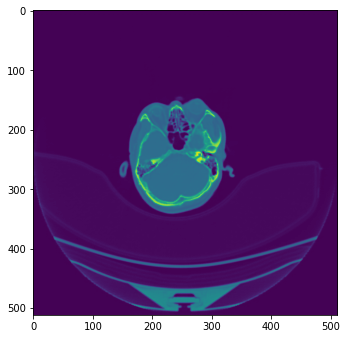

Test:  92%|█████████▏| 532/578 [03:41<00:18,  2.54it/s]2973.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00021.dcm
2950.3843 5.808152 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00021.dcm
2970.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00021.dcm


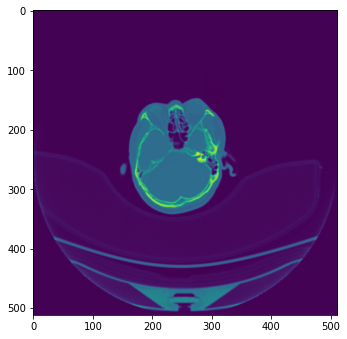

Test:  92%|█████████▏| 533/578 [03:41<00:16,  2.69it/s]2862.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00022.dcm
2866.1028 4.7632413 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00022.dcm
2860.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00022.dcm


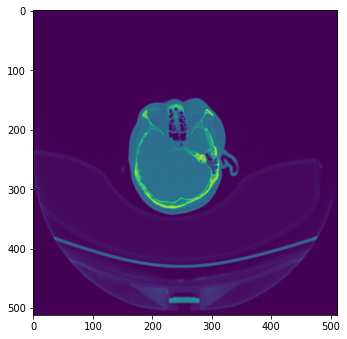

Test:  92%|█████████▏| 534/578 [03:42<00:16,  2.71it/s]2790.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00023.dcm
2761.8103 5.213937 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00023.dcm
2786.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00023.dcm


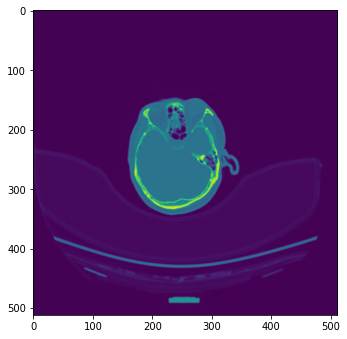

Test:  93%|█████████▎| 535/578 [03:42<00:16,  2.68it/s]2704.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00024.dcm
2753.87 4.0656576 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00024.dcm
2706.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00024.dcm


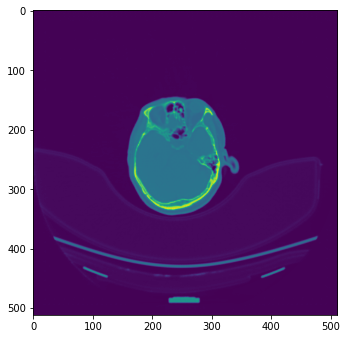

Test:  93%|█████████▎| 536/578 [03:42<00:16,  2.58it/s]2714.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00025.dcm
2733.261 3.5115936 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00025.dcm
2713.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00025.dcm


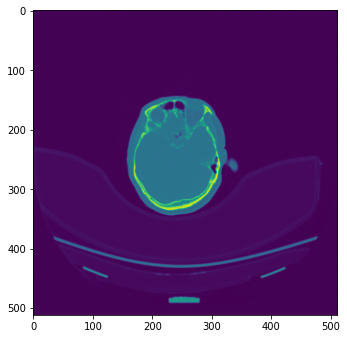

Test:  93%|█████████▎| 537/578 [03:43<00:15,  2.64it/s]2702.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00026.dcm
2731.3252 3.3501341 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00026.dcm
2693.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00026.dcm


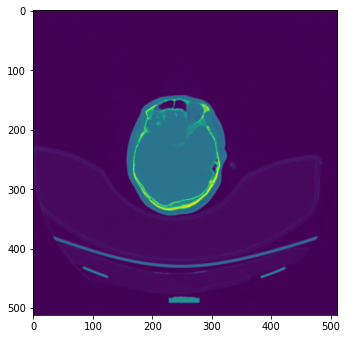

Test:  93%|█████████▎| 538/578 [03:43<00:15,  2.60it/s]2693.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00027.dcm
2684.8113 3.542592 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00027.dcm
2686.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00027.dcm


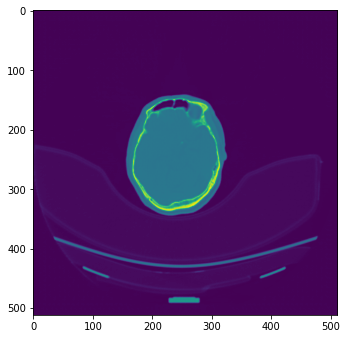

Test:  93%|█████████▎| 539/578 [03:44<00:16,  2.36it/s]2693.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00028.dcm
2699.8582 4.1756163 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00028.dcm
2692.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00028.dcm


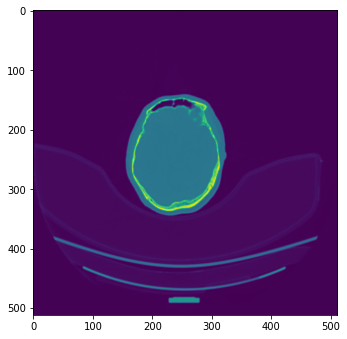

Test:  93%|█████████▎| 540/578 [03:44<00:18,  2.04it/s]2667.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00029.dcm
2651.968 3.8757625 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00029.dcm
2664.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00029.dcm


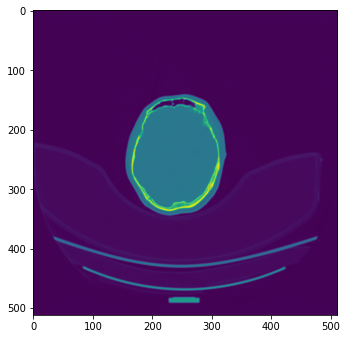

Test:  94%|█████████▎| 541/578 [03:45<00:20,  1.82it/s]2657.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00030.dcm
2678.3352 3.4027336 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00030.dcm
2658.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00030.dcm


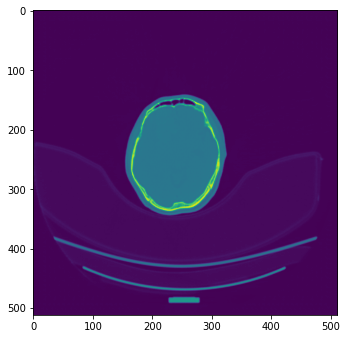

Test:  94%|█████████▍| 542/578 [03:46<00:19,  1.83it/s]2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00031.dcm
2747.3606 2.8961434 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00031.dcm
2665.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00031.dcm


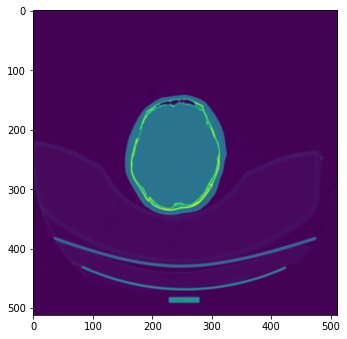

Test:  94%|█████████▍| 543/578 [03:46<00:17,  1.96it/s]2657.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00032.dcm
2654.1448 2.8578227 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00032.dcm
2654.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00032.dcm


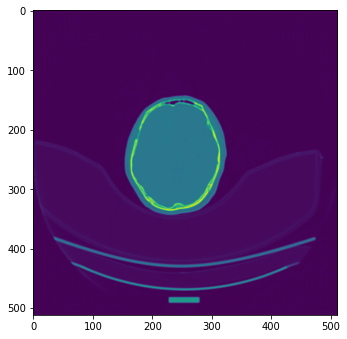

Test:  94%|█████████▍| 544/578 [03:46<00:16,  2.09it/s]2662.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00033.dcm
2641.2354 3.557969 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00033.dcm
2667.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00033.dcm


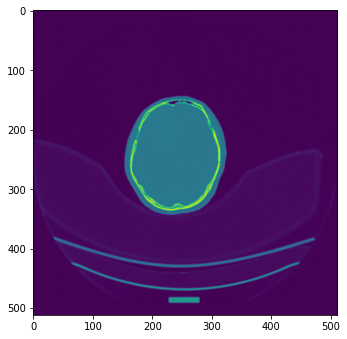

Test:  94%|█████████▍| 545/578 [03:47<00:15,  2.16it/s]2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00034.dcm
2630.974 3.434098 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00034.dcm
2660.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00034.dcm


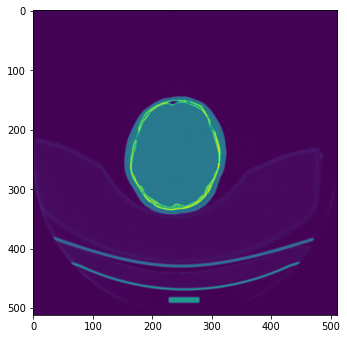

Test:  94%|█████████▍| 546/578 [03:47<00:13,  2.34it/s]2671.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00035.dcm
2650.8818 3.5691967 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00035.dcm
2666.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00035.dcm


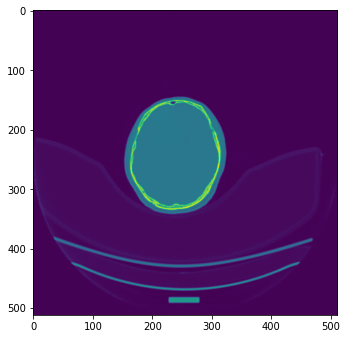

Test:  95%|█████████▍| 547/578 [03:48<00:13,  2.28it/s]2630.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00036.dcm
2616.4504 3.7462776 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00036.dcm
2631.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00036.dcm


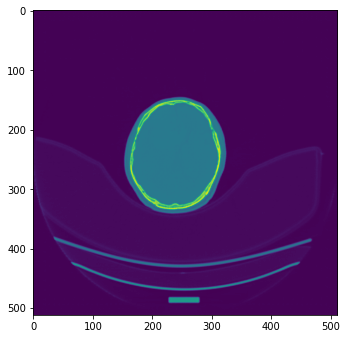

Test:  95%|█████████▍| 548/578 [03:48<00:13,  2.29it/s]2636.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00037.dcm
2635.2708 3.8238952 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00037.dcm
2631.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00037.dcm


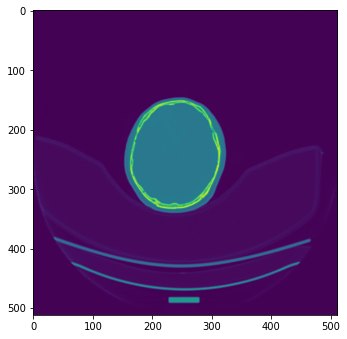

Test:  95%|█████████▍| 549/578 [03:48<00:12,  2.41it/s]2628.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00038.dcm
2612.3342 3.7196727 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00038.dcm
2629.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00038.dcm


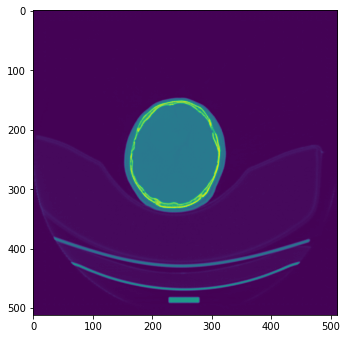

Test:  95%|█████████▌| 550/578 [03:49<00:11,  2.47it/s]2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00039.dcm
2603.0835 3.7132046 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00039.dcm
2617.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00039.dcm


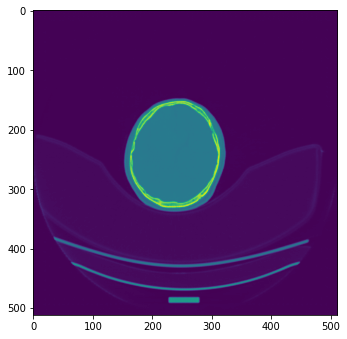

Test:  95%|█████████▌| 551/578 [03:49<00:10,  2.62it/s]2583.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00040.dcm
2559.856 3.6894066 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00040.dcm
2587.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00040.dcm


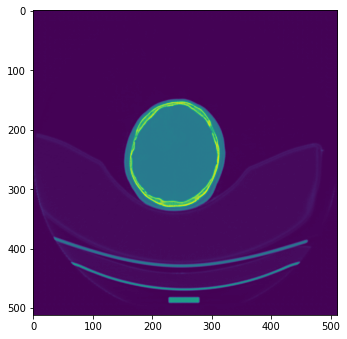

Test:  96%|█████████▌| 552/578 [03:49<00:09,  2.65it/s]2600.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00041.dcm
2556.6125 3.6465704 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00041.dcm
2599.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00041.dcm


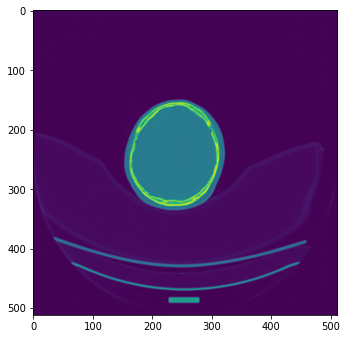

Test:  96%|█████████▌| 553/578 [03:50<00:09,  2.71it/s]2576.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00042.dcm
2517.2788 3.47669 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00042.dcm
2578.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00042.dcm


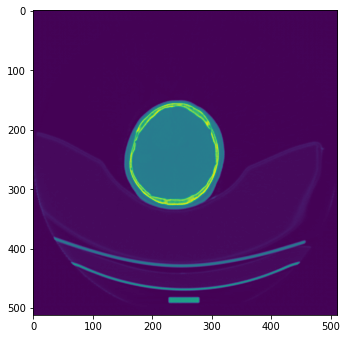

Test:  96%|█████████▌| 554/578 [03:50<00:08,  2.78it/s]2593.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00043.dcm
2519.7302 3.3844275 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00043.dcm
2588.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00043.dcm


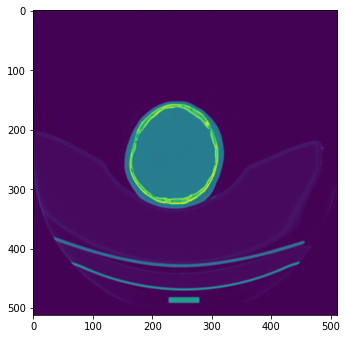

Test:  96%|█████████▌| 555/578 [03:51<00:08,  2.75it/s]2587.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00044.dcm
2511.3557 3.5571148 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00044.dcm
2581.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00044.dcm


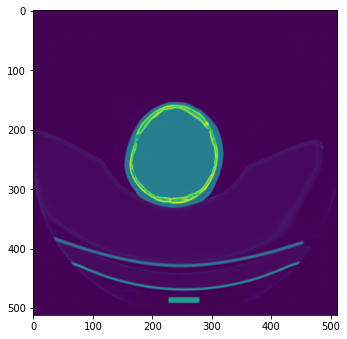

Test:  96%|█████████▌| 556/578 [03:51<00:08,  2.74it/s]2587.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00045.dcm
2543.8086 3.6048326 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00045.dcm
2586.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00045.dcm


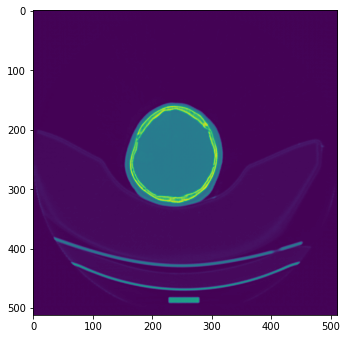

Test:  96%|█████████▋| 557/578 [03:51<00:08,  2.56it/s]2601.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00046.dcm
2491.317 3.2695873 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00046.dcm
2604.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00046.dcm


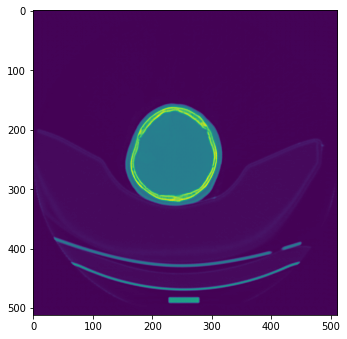

Test:  97%|█████████▋| 558/578 [03:52<00:08,  2.47it/s]2606.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00047.dcm
2559.8293 3.232487 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00047.dcm
2608.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00047.dcm


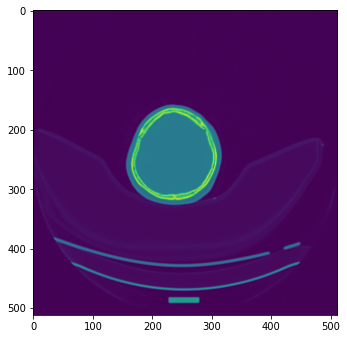

Test:  97%|█████████▋| 559/578 [03:52<00:07,  2.45it/s]2608.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00048.dcm
2523.576 3.29546 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00048.dcm
2604.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00048.dcm


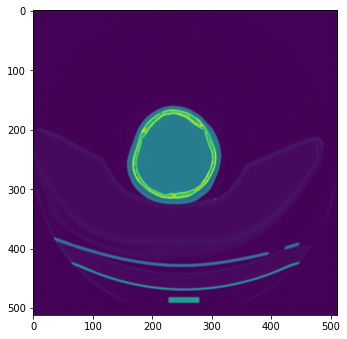

Test:  97%|█████████▋| 560/578 [03:53<00:07,  2.25it/s]2583.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00049.dcm
2509.038 3.4411762 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00049.dcm
2581.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00049.dcm


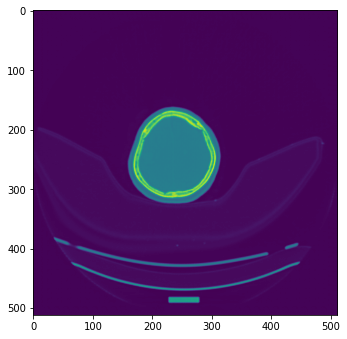

Test:  97%|█████████▋| 561/578 [03:53<00:07,  2.22it/s]2470.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00050.dcm
2449.8086 3.5019524 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00050.dcm
2475.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00050.dcm


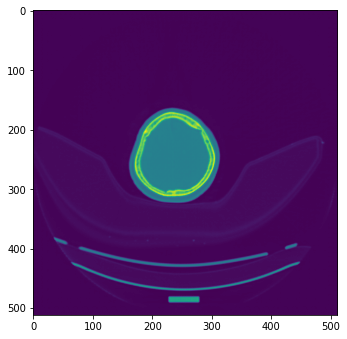

Test:  97%|█████████▋| 562/578 [03:54<00:07,  2.28it/s]2484.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00051.dcm
2495.834 3.6857455 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00051.dcm
2486.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00051.dcm


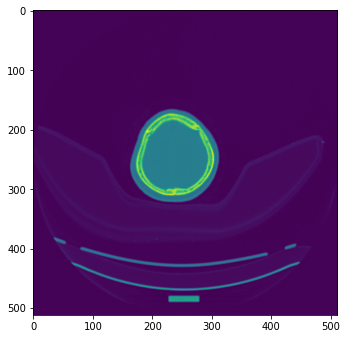

Test:  97%|█████████▋| 563/578 [03:54<00:06,  2.35it/s]2501.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00052.dcm
2481.8926 3.1559677 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00052.dcm
2503.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00052.dcm


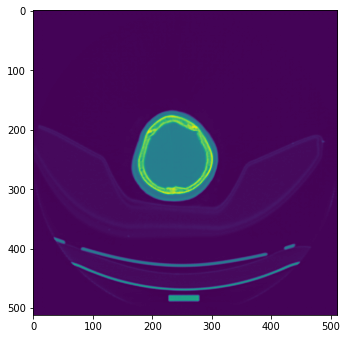

Test:  98%|█████████▊| 564/578 [03:54<00:05,  2.47it/s]2419.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00053.dcm
2451.0698 2.8125455 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00053.dcm
2420.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00053.dcm


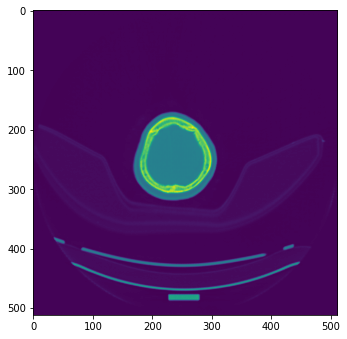

Test:  98%|█████████▊| 565/578 [03:55<00:05,  2.56it/s]2467.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00054.dcm
2460.4316 3.913229 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00054.dcm
2467.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00054.dcm


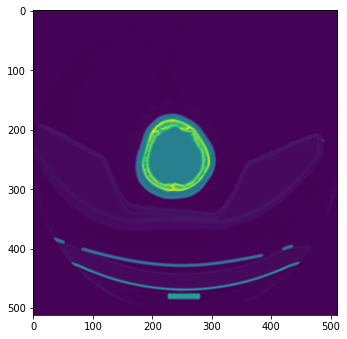

Test:  98%|█████████▊| 566/578 [03:55<00:04,  2.69it/s]2431.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00055.dcm
2431.5864 4.8865023 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00055.dcm
2435.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00055.dcm


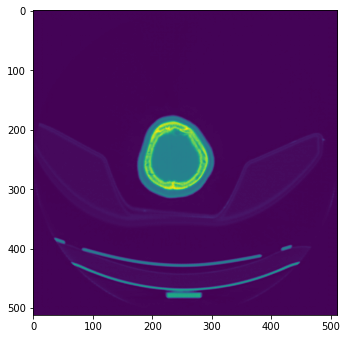

Test:  98%|█████████▊| 567/578 [03:55<00:04,  2.71it/s]2491.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00056.dcm
2543.2712 5.164022 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00056.dcm
2488.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00056.dcm


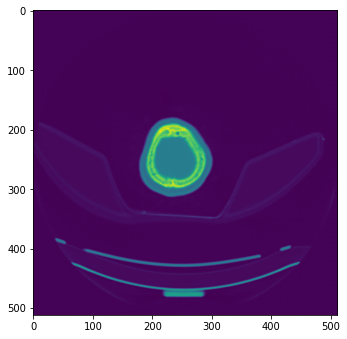

Test:  98%|█████████▊| 568/578 [03:56<00:03,  2.84it/s]2488.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00057.dcm
2490.2302 6.0114713 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00057.dcm
2494.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00057.dcm


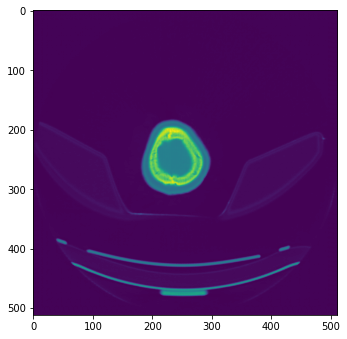

Test:  98%|█████████▊| 569/578 [03:56<00:03,  2.82it/s]2419.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/gt_low_CHA_YOO_JEO_F48_001_20201120_103114_00058.dcm
2420.9922 5.5535755 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHA_YOO_JEO_F48/pred_high_CHA_YOO_JEO_F48_001_20201120_103114_00058.dcm
2405.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHA_YOO_JEO_F48/gt_high_CHA_YOO_JEO_F48_001_20201120_091010_00058.dcm


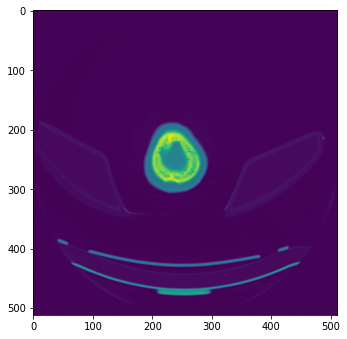

Test:  99%|█████████▊| 570/578 [03:56<00:02,  2.82it/s]2391.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00001.dcm
2412.0383 4.7191844 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00001.dcm
2395.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00001.dcm


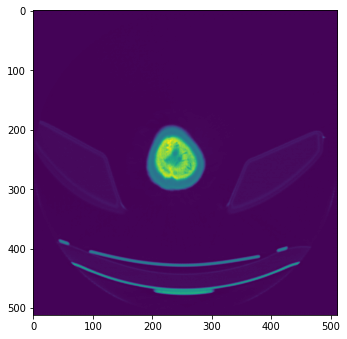

Test:  99%|█████████▉| 571/578 [03:57<00:02,  2.70it/s]2386.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00002.dcm
2415.5896 3.2793505 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00002.dcm
2386.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00002.dcm


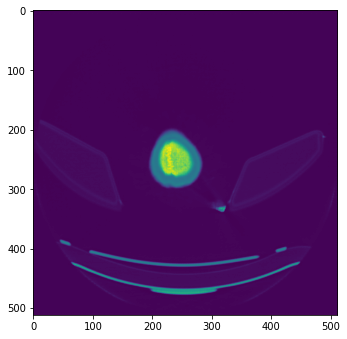

Test:  99%|█████████▉| 572/578 [03:57<00:02,  2.59it/s]2268.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00003.dcm
2315.643 2.4742494 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00003.dcm
2268.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00003.dcm


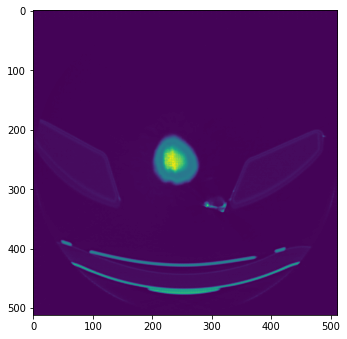

Test:  99%|█████████▉| 573/578 [03:58<00:01,  2.62it/s]3714.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00004.dcm
3229.543 2.2870393 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00004.dcm
3713.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00004.dcm


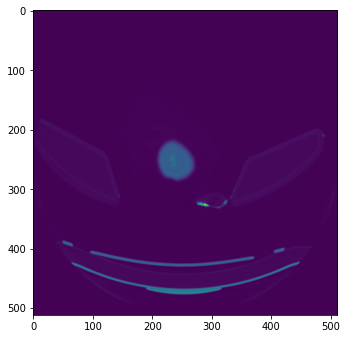

Test:  99%|█████████▉| 574/578 [03:58<00:01,  2.59it/s]3046.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00005.dcm
2630.1514 2.1083717 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00005.dcm
3044.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00005.dcm


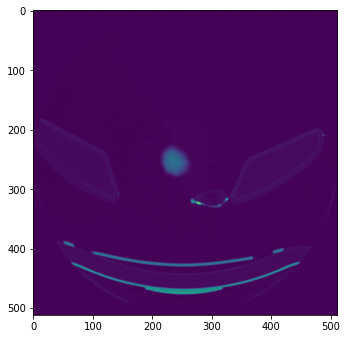

Test:  99%|█████████▉| 575/578 [03:58<00:01,  2.58it/s]4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00006.dcm
3633.632 0.063216984 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00006.dcm
4095.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00006.dcm


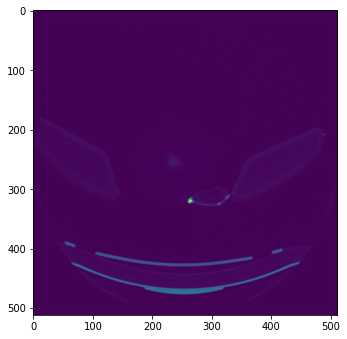

Test: 100%|█████████▉| 576/578 [03:59<00:00,  2.46it/s]3922.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00007.dcm
3251.8909 0.2991213 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00007.dcm
3923.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00007.dcm


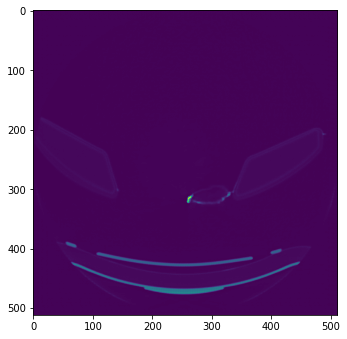

Test: 100%|█████████▉| 577/578 [03:59<00:00,  2.46it/s]3877.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/gt_low_CHI_HYA_F63_001_20201120_132115_00008.dcm
3264.462 0.4434952 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/low2high/CHI_HYA_F63/pred_high_CHI_HYA_F63_001_20201120_132115_00008.dcm
3878.0 0.0 float32
/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_100/high2low/CHI_HYA_F63/gt_high_CHI_HYA_F63_001_20201120_115710_00008.dcm


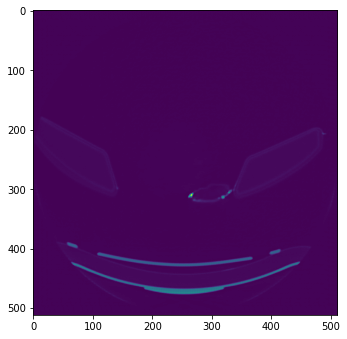

Test: 100%|██████████| 578/578 [04:00<00:00,  2.40it/s]


In [16]:
test_low2high_save_folder = '/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_'+str(epoch) + '/low2high/'
test_high2low_save_folder = '/workspace/sunggu/4.Dose_img2img/Predictions/dcm/test_Pix2Pix_2d_epoch_'+str(epoch) + '/high2low/'

with torch.no_grad():
    # Model 선언
    netG.eval()
    netD.eval()

    test_iterator = tqdm(test_loader, desc='Test', file=sys.stdout)    
    for batch_data in test_iterator:

        os.makedirs(test_low2high_save_folder+batch_data['dcm_low'][0].split('/')[8], mode=0o777, exist_ok=True)
        os.makedirs(test_high2low_save_folder+batch_data['dcm_high'][0].split('/')[8], mode=0o777, exist_ok=True)
        
        # forward pass
        input_low  = batch_data['low'].to(device)
        input_high = batch_data['high'].to(device)
        
        # Forward Generator
        output_high = netG(input_low)

        # 저장하기
#         print(input_low.min(), input_low.max())
#         input_low[:, 128:128+256, 128:128+256, :] = 0
        input_low   = fn_tonumpy(return_preprocessing_for_dcm(fn_denorm(input_low)))
        input_high  = fn_tonumpy(return_preprocessing_for_dcm(fn_denorm(input_high)))
        output_high = fn_tonumpy(return_preprocessing_for_dcm(fn_denorm(output_high)))
        
        
        save_dicom(batch_data['dcm_low'][0], input_low, test_low2high_save_folder+batch_data['dcm_low'][0].split('/')[8]+'/gt_low_' +batch_data['dcm_low'][0].split('/')[-1])
        save_dicom(batch_data['dcm_low'][0], output_high, test_low2high_save_folder+batch_data['dcm_low'][0].split('/')[8]+'/pred_high_' +batch_data['dcm_low'][0].split('/')[-1])        
        save_dicom(batch_data['dcm_high'][0], input_high, test_high2low_save_folder+batch_data['dcm_high'][0].split('/')[8]+'/gt_high_' +batch_data['dcm_high'][0].split('/')[-1])

        
        plt.figure(figsize=(12,12))
        plt.subplot(121)
        
        plt.imshow(output_high.squeeze())
        plt.show()
                                


## GAN image Metric

### Pred dcm 경로

In [ ]:
# real_dcm_low_images  = list_sort_nicely(glob.glob("/workspace/sunggu/4.Dose_img2img/goto_sinogram/brain/*/n*50/b40f/*/Brain*B40f_3.0*/*.dcm"))
# real_dcm_high_images = list_sort_nicely(glob.glob("/workspace/sunggu/4.Dose_img2img/goto_sinogram/brain/*/n*100/b40f/*/Brain*B40f_3.0*/*.dcm"))

In [17]:
model_dir = "test_Pix2Pix_2d_epoch_100"
dcm_high_images  = list_sort_nicely(glob.glob("/workspace/sunggu/4.Dose_img2img/Predictions/dcm/"+model_dir+"/high2low/*/gt*.dcm"))
dcm_low_images   = list_sort_nicely(glob.glob("/workspace/sunggu/4.Dose_img2img/Predictions/dcm/"+model_dir+"/low2high/*/gt*.dcm"))
pred_low_images  = list_sort_nicely(glob.glob("/workspace/sunggu/4.Dose_img2img/Predictions/dcm/"+model_dir+"/high2low/*/pred*.dcm"))
pred_high_images = list_sort_nicely(glob.glob("/workspace/sunggu/4.Dose_img2img/Predictions/dcm/"+model_dir+"/low2high/*/pred*.dcm"))


### Low 와 High 차이

In [97]:
def CT_12bit_processing(x):
    # H, W, D
    x[x < -1024.0] = -1024.0
    x[x > 3072.0] = 3072.0
    x = (x + 1024.0) / 4095.0
    
    return x

In [19]:
from pydicom import dcmread
import SimpleITK as sitk

gt_tp_list   =[]
pred_tp_list =[]
input_tp_list =[]

for dcm_high_path, pred_high_path, input_path in tqdm(zip(dcm_high_images, pred_high_images, dcm_low_images)):
    
    np_gt_H    = sitk.GetArrayFromImage(sitk.ReadImage(dcm_high_path))
    np_pred_H  = sitk.GetArrayFromImage(sitk.ReadImage(pred_high_path))
    np_input_L = sitk.GetArrayFromImage(sitk.ReadImage(input_path))
    
    np_gt_H    = CT_12bit_processing(np_gt_H)
    np_pred_H  = CT_12bit_processing(np_pred_H)
    np_input_L = CT_12bit_processing(np_input_L)
    
    tp_gt_H   = torch.from_numpy(np_gt_H)
    tp_pred_H = torch.from_numpy(np_pred_H)  # 1, 512, 512
    tp_pred_L = torch.from_numpy(np_input_L)  # 1, 512, 512
    
    gt_tp_list.append(tp_gt_H)
    pred_tp_list.append(tp_pred_H)
    input_tp_list.append(tp_pred_L)
    
gt_zip    = torch.stack(gt_tp_list, dim=0)
pred_zip  = torch.stack(pred_tp_list, dim=0)
input_zip = torch.stack(input_tp_list, dim=0)


578it [00:12, 45.81it/s]


### SSIM

In [ ]:
# x: Tensor with shape 2D (H, W), 3D (C, H, W), 4D (N, C, H, W) or 5D (N, C, H, W, 2).
# y: Tensor with shape 2D (H, W), 3D (C, H, W), 4D (N, C, H, W) or 5D (N, C, H, W, 2).


In [20]:
import piq

In [21]:
prediction  = pred_zip
target      = gt_zip
input       = input_zip

# To compute SSIM index as a measure, use lower case function from the library:
ssim_index = piq.ssim(prediction, target, data_range=1.0)
# In order to use SSIM as a loss function, use corresponding PyTorch module:
ssim_loss = piq.SSIMLoss(data_range=1.0)(prediction, target)
print(f"model SSIM index: {ssim_index.item():0.4f}, loss: {ssim_loss.item():0.4f}")



# To compute SSIM index as a measure, use lower case function from the library:
ssim_index = piq.ssim(input, target, data_range=1.0)
# In order to use SSIM as a loss function, use corresponding PyTorch module:
ssim_loss: torch.Tensor = piq.SSIMLoss(data_range=1.0)(input, target)
print(f"Input SSIM index: {ssim_index.item():0.4f}, loss: {ssim_loss.item():0.4f}")


model SSIM index: 0.9950, loss: 0.0050
Input SSIM index: 0.9995, loss: 0.0005


### PSNR

In [22]:
# To compute PSNR as a measure, use lower case function from the library.
psnr_index = piq.psnr(prediction, target, data_range=1.0, reduction='none')
print(f"model PSNR index: {psnr_index.mean():0.4f}")

# To compute PSNR as a measure, use lower case function from the library.
psnr_index = piq.psnr(input, target, data_range=1.0, reduction='none')
print(f"Input PSNR index: {psnr_index.mean():0.4f}")

model PSNR index: 49.0178
Input PSNR index: 63.5209


In [23]:
def cal_PSNR(x):
    peak_pixel = x.max()
    patch_air  = x.squeeze()[30:60, 250:280]
    score = 10*np.log10( peak_pixel ** 2 / np.var(patch_air.flatten()))
    
    return score

In [24]:
from pydicom import dcmread
import SimpleITK as sitk

gt_H_list   =[]
pred_H_list =[]
input_L_list =[]

for dcm_high_path, pred_high_path, input_path in tqdm(zip(dcm_high_images, pred_high_images, dcm_low_images)):
    
    np_gt_H    = sitk.GetArrayFromImage(sitk.ReadImage(dcm_high_path))
    np_pred_H  = sitk.GetArrayFromImage(sitk.ReadImage(pred_high_path))
    np_input_L = sitk.GetArrayFromImage(sitk.ReadImage(input_path))
    
    gt_H_list    = cal_PSNR(np_gt_H)
    pred_H_list  = cal_PSNR(np_pred_H)
    input_L_list = cal_PSNR(np_input_L)


578it [00:10, 55.83it/s]


In [25]:
print(np.mean(gt_H_list))
print(np.mean(pred_H_list))
print(np.mean(input_L_list))

57.70528911657769
61.68937648169033
55.14540412362207


## MSE

In [88]:
import math

def MSE(inputs, target):
    mse  = np.mean( (inputs - target) ** 2 )
    return mse

In [89]:
from pydicom import dcmread
import SimpleITK as sitk

pred_high_mse_list   =[]
low_high_mse_list    =[]

for dcm_high_path, pred_high_path, input_path in tqdm(zip(dcm_high_images, pred_high_images, dcm_low_images)):
    
    np_gt_H    = sitk.GetArrayFromImage(sitk.ReadImage(dcm_high_path))
    np_pred_H  = sitk.GetArrayFromImage(sitk.ReadImage(pred_high_path))
    np_input_L = sitk.GetArrayFromImage(sitk.ReadImage(input_path))

    pred_high_mse    = MSE(np_gt_H, np_pred_H)
    low_high_mse     = MSE(np_gt_H, np_input_L)
    
    pred_high_mse_list.append(pred_high_mse)
    low_high_mse_list.append(low_high_mse)

578it [00:11, 48.30it/s]


In [90]:
np.mean(low_high_mse_list)

7.4741624746355635

In [91]:
np.mean(pred_high_mse_list)

155.43292434982774

## Difference Map

In [ ]:
brain_img = sitk.Cast(sitk.IntensityWindowing(img, windowMinimum=0.0, windowMaximum=80.0, outputMinimum=0, outputMaximum=255), sitk.sitkUInt8)

In [50]:
# from pydicom import dcmread
# import SimpleITK as sitk

# np_gt_H      = sitk.ReadImage(dcm_high_images[37])
# np_gt_H      = sitk.IntensityWindowing(np_gt_H, windowMinimum=0.0, windowMaximum=80.0, outputMinimum=0, outputMaximum=255)
# np_gt_H      = sitk.GetArrayFromImage(np_gt_H)

# np_pred_H      = sitk.ReadImage(pred_high_images[37])
# np_pred_H      = sitk.IntensityWindowing(np_pred_H, windowMinimum=0.0, windowMaximum=80.0, outputMinimum=0, outputMaximum=255)
# np_pred_H      = sitk.GetArrayFromImage(np_pred_H)

# np_input_L      = sitk.ReadImage(dcm_low_images[37])
# np_input_L      = sitk.IntensityWindowing(np_input_L, windowMinimum=0.0, windowMaximum=80.0, outputMinimum=0, outputMaximum=255)
# np_input_L      = sitk.GetArrayFromImage(np_input_L)

In [70]:
np_gt_H    = sitk.GetArrayFromImage(sitk.ReadImage(dcm_high_images[37]))
np_pred_H  = sitk.GetArrayFromImage(sitk.ReadImage(pred_high_images[37]))
np_input_L = sitk.GetArrayFromImage(sitk.ReadImage(dcm_low_images[37]))

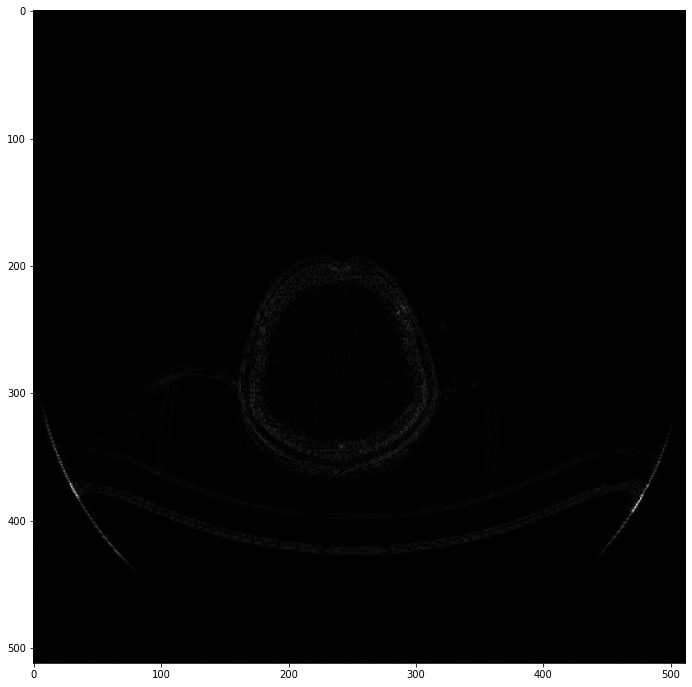

In [71]:
plt.figure(figsize=(12,12))
plt.imshow(np.abs(np_gt_H - np_pred_H)[0], 'gray')

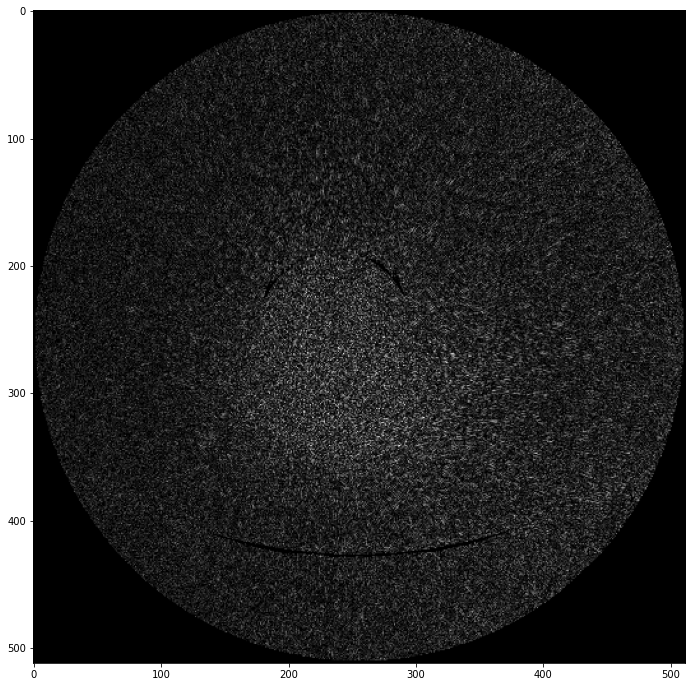

In [72]:
plt.figure(figsize=(12,12))
plt.imshow(np.abs(np_gt_H - np_input_L)[0], 'gray')

In [92]:
np_gt_H    = sitk.GetArrayFromImage(sitk.ReadImage(dcm_high_images[37]))

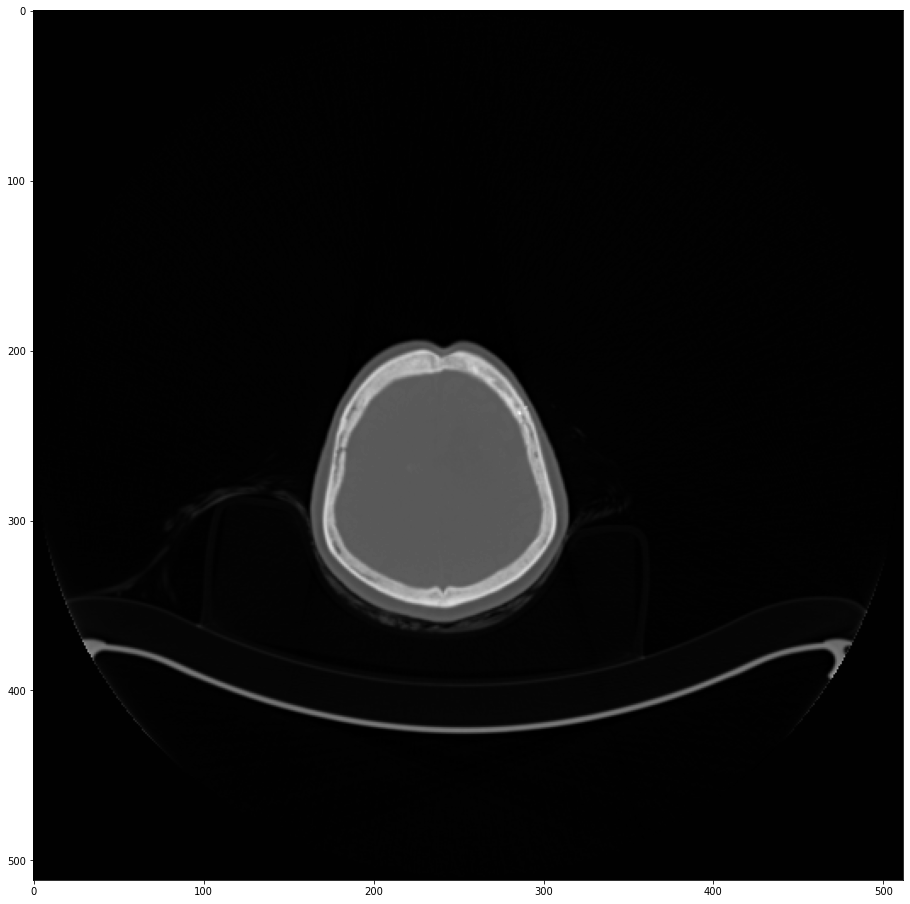

In [95]:
plt.figure(figsize=(16, 16))
plt.imshow(np_gt_H[0], 'gray')

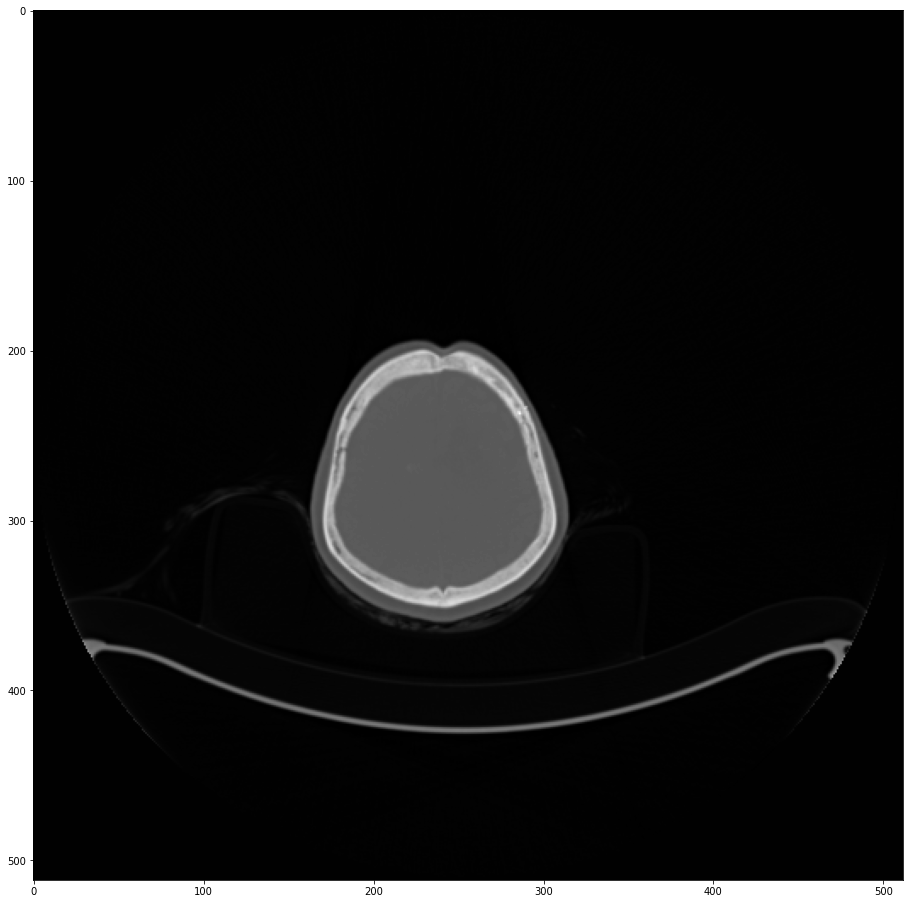

In [98]:
plt.figure(figsize=(16, 16))
plt.imshow(CT_12bit_processing(np_gt_H[0]), 'gray')

In [ ]:
CT_12bit_processing